# <CENTER><div class="alert alert-block alert-info"><b> Projet 7:</b>  Implémentez un modèle de scoring <b><CENTER>   
    

### Problématique:
Mettre en oeuvre un outil de scoring pour calculer la probabilité qu'un client rembourse son crédit puis classifier la demande en crédit accordé ou réfusé

### Objectifs:
1. Explorer les données pour avoir des données comportementales, des données provenant d'autres institution financière...
2. Mettre en place un algorithme de classification qui détermine une probabilité
3. Développer un dashboard interactif permettant:
    - d'expliquer les décisions d'octroi de crédit (interpréation compréhensible des prédictions)
    - au client de disposer de leurs informations personnelles et de les explorer

### Données mis à disposition
Les données mis à disposition sont disponibles sur Kaggle (https://www.kaggle.com/competitions/home-credit-default-risk/code?competitionId=9120&sortBy=voteCount)
Il y a 9 fichiers csv:
- Application_test: jeu de données principales utilisables pour tester les modèles car ne contient pas les "target". Il fournit des informations sur chaque application de crédit soumise à Home Credit. 
- Application_train: jeu de données principales utilisables pour entraîner les modèles car il contient les "target" (0: quand un crédit a été remboursé, 1 quand il y a des défauts de paiement). Il fournit les mêmes informations sur chaque application de crédit soumise à Home Credit que le fichier application_test.
- Bureau: fourni des informations sur les crédits précédemment souscrit par un client chez d'autre organisme de prêt.
- Bureau balance: données mensuelles sur les crédits précédemment souscrit.
- previous application: demande de crédits réalisée par le passé chez HomeCredit
- POS CASH Balance: données mensuelles sur les points de vente précédents ou les prêts en espèces que les clients ont eus avec Home Credit
- Credit card balance: données mensuelles sur les cartes de crédit précédemment obtenues chez Home Credit
- Installments payments: historique des paiements des prêts précédement obtenu chez Home Credit
- HomeCredit columns description: contient le descriptif de chaque variable présentes dans les jeux de données
- sample submission montre un exemple de format pour les prédictions.

### <a name="C0">Table of contents</a>

- <a href="#C1">1. Library importations</a>
- <a name="C1">1. Library importations</a>
- <a href="#C2">2. Exploratory data analysis</a>
    - <a href="#C21">2.1. Datasets about the applications</a>
        - <a href="#C211">2.1.1. "appliction_train" dataset</a>
        - <a href="#C212">2.1.2. "application_test" dataset</a>
        - <a href="#C213">2.1.3. EDA of "application" datasets</a>
            - <a href="#C2131">2.1.3.1 Variable to predict: "TARGET"</a>
            - <a href="#C2132">2.1.3.2 Numeric variables</a>
            - <a href="#C2133">2.1.3.3 Categorical variables</a>
            - <a href="#C2134">2.1.3.4 Feature engineering</a>
    - <a href="#C22">2.2. "bureau_application" dataset</a>
        - <a href="#C221">2.2.1. Dataset discovery</a>
        - <a href="#C222">2.2.2. Feature engineering</a>
    - <a href="#C23">2.3. "bureau" dataframe</a>
        - <a href="#C231">2.3.1. Dataset discovery</a>
        - <a href="#C232">2.3.2. EDA</a>
        - <a href="#C233">2.3.3. Feature engineering</a>
    - <a href="#C24">2.4."credit_card_balance" dataframe</a>
        - <a href="#C241">2.4.1. Dataset discovery</a>
        - <a href="#C242">2.4.2. EDA</a>
        - <a href="#C243">2.4.3. Feature engineering</a>
    - <a href="#C25">2.5. "installments_payments" dataframe</a>
        - <a href="#C251">2.5.1. Dataset discovery</a>
        - <a href="#C252">2.5.2. EDA</a>
        - <a href="#C253">2.5.3. Feature engineering</a>
    - <a href="#C26">2.6. "POS_CASH_balance" dataframe</a>
        - <a href="#C261">2.6.1. Dataset discovery</a>
        - <a href="#C262">2.6.2. Feature engineering</a>
    - <a href="#C27">2.7. "previous_application" dataframe</a>
        - <a href="#C271">2.7.1. Dataset discovery</a>
        - <a href="#C272">2.7.2. EDA</a>
        - <a href="#C273">2.7.3. Feature engineering</a>
    <a href="#C28">2.8. Correlation between "TARGET" and the other variables</a>
- <a href="#C3">3. Modelisation</a>
    - <a href="#C31">3.1. Preprocessing</a>
    - <a href="#C32">3.2. Preparation of training and testing set</a>
        - <a href="#C321">3.2.1. Split the dataframe in training and testing set</a>
        - <a href="#C322">3.2.2. Encoding categorical features</a>
        - <a href="#C323">3.2.3. Numerical variables: imputation of the missing values</a>
        - <a href="#C324">3.2.4. Numerical variables: standardization</a>
        - <a href="#C325">3.2.5. Put back together the categorical and numerical variables</a>
    - <a href="#C33">3.3. Handling imbalanced dataset</a>    
        - <a href="#C331">3.3.1. Training set using random undersampling</a>
        - <a href="#C332">3.3.2. Training set using SMOTE oversampling</a>
        - <a href="#C333">3.3.3. Training set using SMOTE+Tomek links sampling</a>
    - <a href="#C34">3.4. Test of 4 algorithms</a>
- <a href="#C4">4. Selection and optimization of most performant algorithm</a>
    - <a href="#C41">4.1. Selection of most performant algorithm</a>
    - <a href="#C42">4.2. Model optimization and visualization</a>
        - <a href="#C421">4.2.1. Hyperparameter optimization</a>
        - <a href="#C422">4.2.2. Threshold optimization</a>
        - <a href="#C422">4.2.2. Vizualization</a>
- <a href="#C5">5. Model interpretation</a>
    - <a href="#C51">5.1. Feature importance</a>
    - <a href="#C52">5.2. Permutation feature importance</a>
    - <a href="#C53">5.3. LIME</a>
    - <a href="#C55">5.4. Shap</a>

# <div class="alert alert-block alert-info"><a name="C1">1. Library importations</a></div>

In [1]:
# Implementation of PEP8 format verification module
%load_ext pycodestyle_magic
%pycodestyle_on

**Importing the necessary libraries**

In [2]:
# Modules for data
import pandas as pd
import numpy as np

# Module for visualisation
import matplotlib
import matplotlib.pyplot as plt
import seaborn as sns
import missingno as msno

# Module from Scikit-learn
from sklearn.preprocessing import (LabelEncoder,
                                   StandardScaler)
from sklearn.impute import SimpleImputer
from sklearn.compose import make_column_transformer
from sklearn.model_selection import train_test_split
from sklearn.model_selection import GridSearchCV
from sklearn.utils import class_weight
from sklearn.dummy import DummyClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import (RandomForestClassifier,
                              AdaBoostClassifier)
from sklearn.metrics import (roc_auc_score,
                             auc,
                             confusion_matrix,
                             roc_curve,
                             recall_score,
                             precision_score,
                             accuracy_score,
                             f1_score,
                             fbeta_score,
                             precision_recall_curve,
                             make_scorer)
import scikitplot as skplt
from sklearn.model_selection import cross_val_score
from sklearn.inspection import permutation_importance

# Module for lightgbm
from lightgbm import LGBMClassifier

# Module for resampling
from imblearn.over_sampling import SMOTE
from imblearn.combine import SMOTETomek
from imblearn.under_sampling import TomekLinks
from imblearn.under_sampling import RandomUnderSampler

# optimisation du modèle
from hyperopt import tpe, hp, fmin, STATUS_OK, Trials
from hyperopt.pyll.base import scope
from sklearn.model_selection import cross_val_score

# Modules for model interpretation
from lime.lime_tabular import LimeTabularExplainer
import shap

# import des données
import joblib

# others
import gc
import time
import re
import random
from my_functions import (missing_data,
                          missing_data_var,
                          remove_missing_columns,
                          hist_distrib_target,
                          hist_distrib,
                          hist_distrib_cat,
                          hist_distrib_cat_no_target,
                          failure_to_repay_graph,
                          rename_cat_type_suite,
                          rename_cat_income_type,
                          rename_cat_education_type,
                          rename_cat_family_status,
                          rename_cat_housing_type,
                          rename_organization_type,
                          rename_cat_occupation_type,
                          rename_columns)

In [3]:
# Common properties of figures
sns.set()

sns.set_theme(style="ticks", context="notebook")
plt.rcParams['figure.dpi'] = 150
plt.rc('font', size=12)          # taille de la police de l'échelle des axes
plt.rc('axes', titlesize=18)     # taille de la police du titre
plt.rc('axes', labelsize=16)     # taille de la police du titre des axes
plt.rc('xtick', labelsize=12)    # taille de la police de l'échelle de l'axe x
plt.rc('ytick', labelsize=12)    # taille de la police de l'échelle de l'axe y
plt.rc('legend', fontsize=12)    # taille de la légende
plt.rc('figure', titlesize=18)   # taille du titre

<code style="background:lightyellow;color:black">Back to <a href="#C0">Table of contents</a></code>

# <div class="alert alert-block alert-info"><a name="C2">2. Exploratory data analysis</a></div>

## <div class="alert alert-block alert-info"><a name="C21">2.1. Datasets about the applications</a></div>

The credit applications are in 2 datasets:
- "application_train" which contains the "target" (if the client have repaid (0) or no (1) the credit),
- "application_test" in which the target is not present.

## <div class="alert alert-block alert-info"><a name="C211">2.1.1. "appliction_train" dataset</a></div>

In [4]:
# Load the dataframe
df_app_train = pd.read_csv("Data_original/application_train.csv")

# Display the 5 first raws
df_app_train.head()

,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,...,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR
0,100002,1,Cash loans,M,N,Y,0,202500.0,406597.5,24700.5,...,0,0,0,0,0.0,0.0,0.0,0.0,0.0,1.0
1,100003,0,Cash loans,F,N,N,0,270000.0,1293502.5,35698.5,...,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0
2,100004,0,Revolving loans,M,Y,Y,0,67500.0,135000.0,6750.0,...,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0
3,100006,0,Cash loans,F,N,Y,0,135000.0,312682.5,29686.5,...,0,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN
4,100007,0,Cash loans,M,N,Y,0,121500.0,513000.0,21865.5,...,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0


In [5]:
# Display dataframe shape
print("The dataframe consists of ",
      df_app_train.shape[0], "raws and",
      df_app_train.shape[1], "columns.")

The dataframe consists of  307511 raws and 122 columns.


In [6]:
# Check for duplicate values
print("Number of duplicate values:", df_app_train.duplicated().sum())

Number of duplicate values: 0


In [7]:
# Check for duplicate values on "SK_ID_CURR"
n = df_app_train.duplicated(subset="SK_ID_CURR").sum()
print(f"column: SK_ID_CURR -> duplicat: {n}")

column: SK_ID_CURR -> duplicat: 0


In [8]:
# Display the 10 variables with the most missing values
missing_data(df_app_train).head(10)

,Total,Percent
COMMONAREA_MEDI,214865,69.872297
COMMONAREA_AVG,214865,69.872297
COMMONAREA_MODE,214865,69.872297
NONLIVINGAPARTMENTS_MODE,213514,69.432963
NONLIVINGAPARTMENTS_AVG,213514,69.432963
NONLIVINGAPARTMENTS_MEDI,213514,69.432963
FONDKAPREMONT_MODE,210295,68.386172
LIVINGAPARTMENTS_MODE,210199,68.354953
LIVINGAPARTMENTS_AVG,210199,68.354953
LIVINGAPARTMENTS_MEDI,210199,68.354953


Many columns exhibit a high proportion of missing values.

<AxesSubplot:>

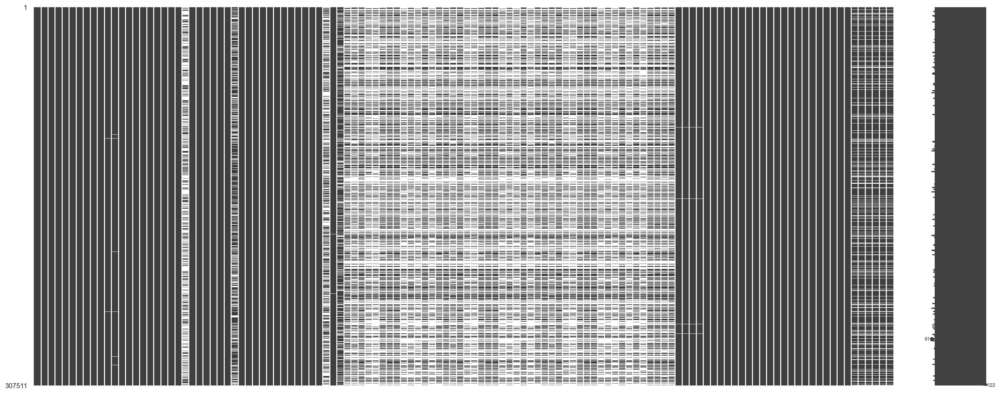

In [9]:
# Graph of the filling rate of the different variables
msno.matrix(df_app_train, fontsize=8)

### <div class="alert alert-block alert-info"><a name="C212">2.1.2. "application_test" dataset</a></div>


In [10]:
# Load the dataframe
df_app_test = pd.read_csv("Data_original/application_test.csv")

# Display the 5 first raws
df_app_test.head()

,SK_ID_CURR,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,...,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR
0,100001,Cash loans,F,N,Y,0,135000.0,568800.0,20560.5,450000.0,...,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0
1,100005,Cash loans,M,N,Y,0,99000.0,222768.0,17370.0,180000.0,...,0,0,0,0,0.0,0.0,0.0,0.0,0.0,3.0
2,100013,Cash loans,M,Y,Y,0,202500.0,663264.0,69777.0,630000.0,...,0,0,0,0,0.0,0.0,0.0,0.0,1.0,4.0
3,100028,Cash loans,F,N,Y,2,315000.0,1575000.0,49018.5,1575000.0,...,0,0,0,0,0.0,0.0,0.0,0.0,0.0,3.0
4,100038,Cash loans,M,Y,N,1,180000.0,625500.0,32067.0,625500.0,...,0,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN


In [11]:
# Display dataframe shape
print("The dataframe consists of",
      df_app_test.shape[0], "raws and",
      df_app_test.shape[1], "columns.")

The dataframe consists of 48744 raws and 121 columns.


In [12]:
# Check for duplicate values
print("Number of duplicate values:", df_app_test.duplicated().sum())

Number of duplicate values: 0


In [13]:
# Check for duplicate values on "SK_ID_CURR"
n = df_app_test.duplicated(subset="SK_ID_CURR").sum()
print(f"column: SK_ID_CURR -> duplicat: {n}")

column: SK_ID_CURR -> duplicat: 0


In [14]:
# Display the 10 variables with the most missing values
missing_data(df_app_test).head(10)

,Total,Percent
COMMONAREA_AVG,33495,68.716150
COMMONAREA_MODE,33495,68.716150
COMMONAREA_MEDI,33495,68.716150
NONLIVINGAPARTMENTS_AVG,33347,68.412523
NONLIVINGAPARTMENTS_MODE,33347,68.412523
NONLIVINGAPARTMENTS_MEDI,33347,68.412523
FONDKAPREMONT_MODE,32797,67.284179
LIVINGAPARTMENTS_AVG,32780,67.249302
LIVINGAPARTMENTS_MODE,32780,67.249302
LIVINGAPARTMENTS_MEDI,32780,67.249302


<AxesSubplot:>

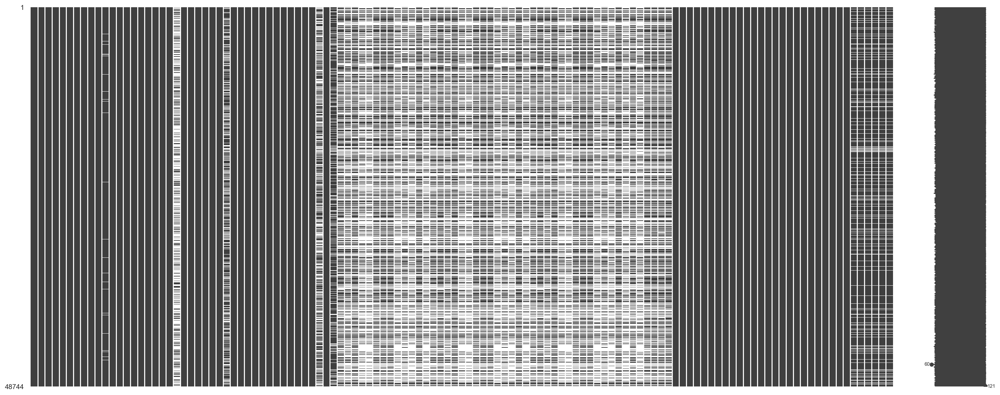

In [15]:
# Graph of the filling rate of the different variables
msno.matrix(df_app_test, fontsize=8)

"application_test" datasets presents the same variables than "application_train" except for "TARGET". The proportions of missing values are similar in both datasets.

<code style="background:lightyellow;color:black">Back to <a href="#C0">table of contents</a></code>

### <div class="alert alert-block alert-info"><a name="C213">2.1.3. EDA of "application" datasets</a></div>

In order to treat the variables of the 'df_app_test' and 'df_app_train' datasets in the same way, these datasets are concatenated. During their exploration, we will also look at their correlation with the class to predict.

In [16]:
# Create a variable to identify the original dataframe
df_app_train["Test"] = False
df_app_test["Test"] = True

# Create the variable "TARGET" for df_app_test
df_app_test["TARGET"] = np.nan

# Concatenate both dataframes
df_app = pd.concat([df_app_train, df_app_test],
                   ignore_index=True,
                   sort=False)

# Display dataframe shape
print("The dataframe consists of",
      df_app.shape[0], "raws and",
      df_app.shape[1], "columns.")

The dataframe consists of 356255 raws and 123 columns.


In [17]:
# Delete columns with more than 40% of missing values
df_app = remove_missing_columns(df_app, threshold=40)
print("New number of columns:", df_app.shape[1])
print("The columns are:", df_app.columns)

There are 49 columns with greater than 40% missing values.
New number of columns: 74
The columns are: Index(['SK_ID_CURR', 'TARGET', 'NAME_CONTRACT_TYPE', 'CODE_GENDER',
       'FLAG_OWN_CAR', 'FLAG_OWN_REALTY', 'CNT_CHILDREN', 'AMT_INCOME_TOTAL',
       'AMT_CREDIT', 'AMT_ANNUITY', 'AMT_GOODS_PRICE', 'NAME_TYPE_SUITE',
       'NAME_INCOME_TYPE', 'NAME_EDUCATION_TYPE', 'NAME_FAMILY_STATUS',
       'NAME_HOUSING_TYPE', 'REGION_POPULATION_RELATIVE', 'DAYS_BIRTH',
       'DAYS_EMPLOYED', 'DAYS_REGISTRATION', 'DAYS_ID_PUBLISH', 'FLAG_MOBIL',
       'FLAG_EMP_PHONE', 'FLAG_WORK_PHONE', 'FLAG_CONT_MOBILE', 'FLAG_PHONE',
       'FLAG_EMAIL', 'OCCUPATION_TYPE', 'CNT_FAM_MEMBERS',
       'REGION_RATING_CLIENT', 'REGION_RATING_CLIENT_W_CITY',
       'WEEKDAY_APPR_PROCESS_START', 'HOUR_APPR_PROCESS_START',
       'REG_REGION_NOT_LIVE_REGION', 'REG_REGION_NOT_WORK_REGION',
       'LIVE_REGION_NOT_WORK_REGION', 'REG_CITY_NOT_LIVE_CITY',
       'REG_CITY_NOT_WORK_CITY', 'LIVE_CITY_NOT_WORK_CITY',
  

<code style="background:lightyellow;color:black">Back to <a href="#C0">Table of contents</a></code>

## <div class="alert alert-block alert-info"><a name="C2131">2.1.3.1 Variable to predict: "TARGET"</a></div>

In order to be able to train supervised classification algorithms, we can use the variable "TARGET" from df_app_train.
How does this variable look like?

In [18]:
# Know the number of possible classes
df_app_train["TARGET"].unique()

array([1, 0], dtype=int64)

"Target" can take the values 0 or 1. According to the documentation, 0 stand for repaided loan and 1 when the client has payment difficulties.

0    282686
1     24825
Name: TARGET, dtype: int64


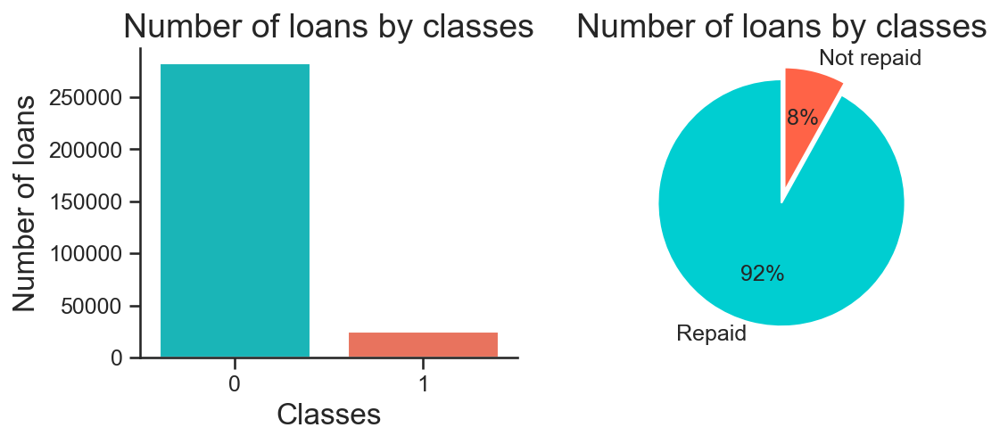

In [19]:
# Know the number of values in each classes
print(df_app_train['TARGET'].value_counts())

# Visualize the distribution
fig = plt.figure(figsize=(8, 3))
ax1 = fig.add_subplot(1, 2, 1)
ax1 = sns.countplot(x="TARGET",
                    data=df_app_train,
                    palette=["darkturquoise", "tomato"])
ax1.set_xlabel("Classes")
ax1.set_ylabel("Number of loans")
plt.title("Number of loans by classes")
sns.despine()

ax2 = fig.add_subplot(1, 2, 2)
ax2 = plt.pie(df_app_train['TARGET'].value_counts(),
              labels=["Repaid", "Not repaid"],
              colors=["darkturquoise", "tomato"],
              startangle=90,
              autopct='%1.0f%%',
              explode=(0, 0.1))
plt.title("Number of loans by classes")
sns.despine()

plt.show()

Most of the credits are repaid. So, we have an unbalanced classification problem that we have to take into account in the modelisation part.

<code style="background:lightyellow;color:black">Back to <a href="#C0">Table of contents</a></code>

## <div class="alert alert-block alert-info"><a name="C2132">2.1.3.2 Numeric variables</a></div>

**Variable "DAYS_BIRTH"**

In [20]:
# Know the proportion of missing values
print("Percent of missing values:", missing_data_var(df_app, "DAYS_BIRTH"))

Percent of missing values: 0.0


In [21]:
# Get the descriptive statistics
df_app["DAYS_BIRTH"].describe()

count    356255.000000
mean     -16041.248841
std        4358.803980
min      -25229.000000
25%      -19676.000000
50%      -15755.000000
75%      -12425.000000
max       -7338.000000
Name: DAYS_BIRTH, dtype: float64

The values are negative because the age of the clients is given in number of days relative to the day of the credit application. I will transform it to have the age of the customers in years.

In [22]:
df_app["YEARS_BIRTH"] = df_app["DAYS_BIRTH"] / -365
df_app["YEARS_BIRTH"].describe()

count    356255.000000
mean         43.948627
std          11.941929
min          20.104110
25%          34.041096
50%          43.164384
75%          53.906849
max          69.120548
Name: YEARS_BIRTH, dtype: float64

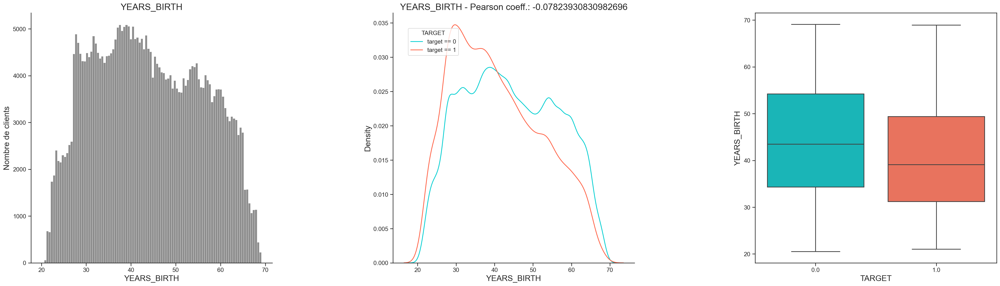

In [23]:
# Visualize "YEARS_BIRTH"
hist_distrib_target(df_app, variable="YEARS_BIRTH")

There is no obvious outliers.

There is a negative linear relationship between client age and client repayment capacity.
The target == 1 curve skews towards the younger end of the range. Although this is not a significant correlation (-0.07 correlation coefficient), this variable is likely going to be useful in a machine learning model because it does affect the target. Let's look at this relationship in another way: average failure to repay loans by age bracket.

To make this graph, first we cut the age category into bins of 5 years each. Then, for each bin, we calculate the average value of the target, which tells us the ratio of loans that were not repaid in each age category.


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


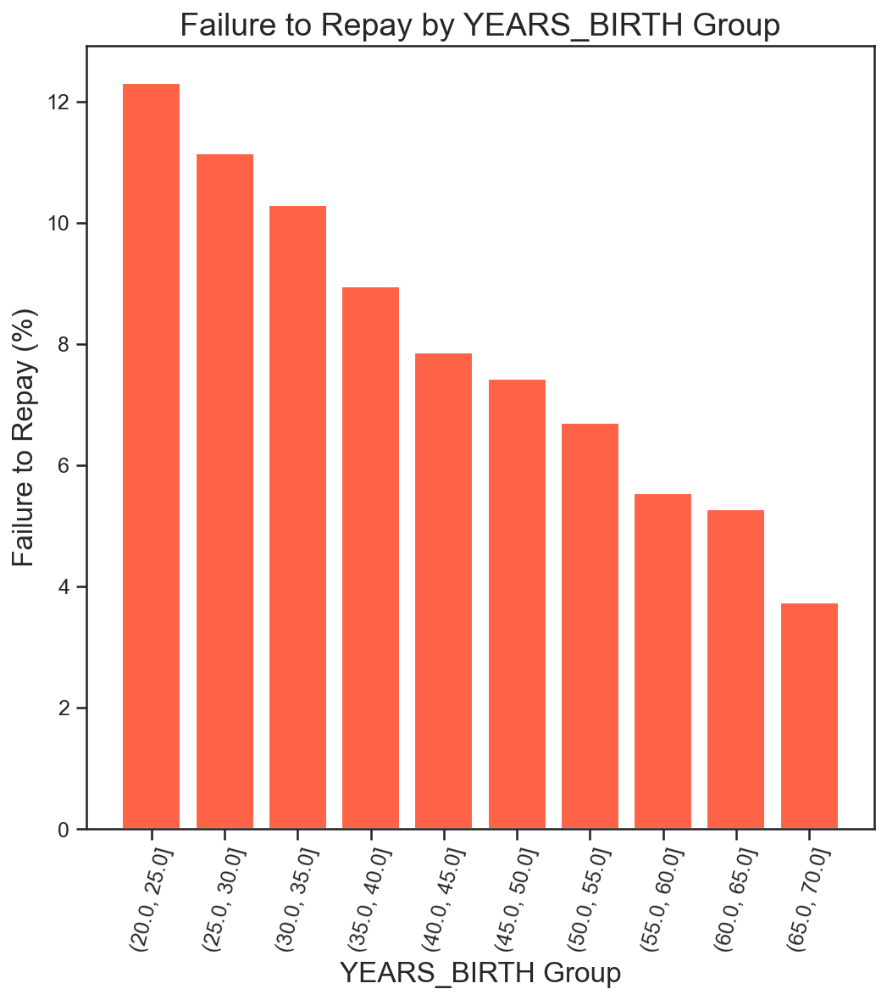

In [24]:
failure_to_repay_graph(df_app,
                       variable="YEARS_BIRTH",
                       bins=np.linspace(20, 70, num=11))

In [25]:
print("Statistic for df_test:",
      df_app[df_app["Test"]]["YEARS_BIRTH"].describe())
print("")
print("Statistic for df_train:",
      df_app[~df_app["Test"]]["YEARS_BIRTH"].describe())

Statistic for df_test: count    48744.000000
mean        44.022150
std         11.851782
min         20.104110
25%         34.235616
50%         43.246575
75%         53.800000
max         69.027397
Name: YEARS_BIRTH, dtype: float64

Statistic for df_train: count    307511.000000
mean         43.936973
std          11.956133
min          20.517808
25%          34.008219
50%          43.150685
75%          53.923288
max          69.120548
Name: YEARS_BIRTH, dtype: float64


The values given by the describe function are similar for the train and test datasets.

**Variables "DAYS_EMPLOYED"**

This variable corresponds to the number of days between the employed start and the credit application.

In [26]:
# Know the proportion of missing values
print("Percent of missing values:", missing_data_var(df_app, "DAYS_EMPLOYED"))

Percent of missing values: 0.0


In [27]:
# Get the descriptive statistics
df_app["DAYS_EMPLOYED"].describe()

count    356255.000000
mean      64317.231413
std      141705.532576
min      -17912.000000
25%       -2781.000000
50%       -1224.000000
75%        -290.000000
max      365243.000000
Name: DAYS_EMPLOYED, dtype: float64

Most of the values are negatives. The maximal value is positive and is very different from the others.

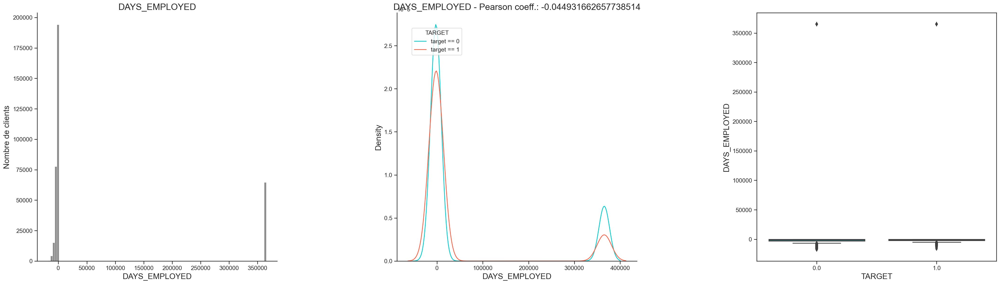

In [28]:
# Visualize "DAYS_EMPLOYED"
hist_distrib_target(df_app, "DAYS_EMPLOYED")

In [29]:
anom = df_app[df_app['DAYS_EMPLOYED'] == 365243]
non_anom = df_app[df_app['DAYS_EMPLOYED'] != 365243]
print('The non-anomalies default on %0.2f%% of loans'
      % (100 * non_anom['TARGET'].mean()))
print('The anomalies default on %0.2f%% of loans'
      % (100 * anom['TARGET'].mean()))
print('There are %d anomalous days of employment' % len(anom))

The non-anomalies default on 8.66% of loans
The anomalies default on 5.40% of loans
There are 64648 anomalous days of employment


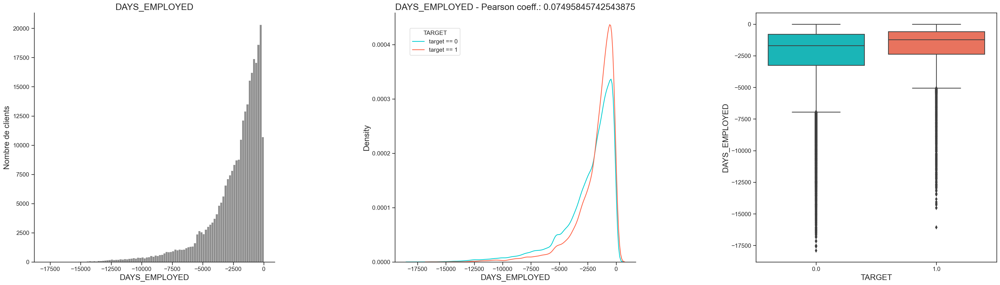

In [30]:
# Replace the anomalous values with nan
df_app['DAYS_EMPLOYED'].replace({365243: np.nan}, inplace=True)

hist_distrib_target(df_app, "DAYS_EMPLOYED")

Let's look at this relationship in another way: average failure to repay loans by days employed bracket.

To make this graph, first we cut the days employed category into bins of 5 years each. Then, for each bin, we calculate the average value of the target, which tells us the ratio of loans that were not repaid in each age bin.

In [31]:
# Create a copy of the dataframe
df_empl = df_app[["TARGET", "DAYS_EMPLOYED"]]
df_empl["YEARS_EMPLOYED"] = df_empl["DAYS_EMPLOYED"] / -365


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


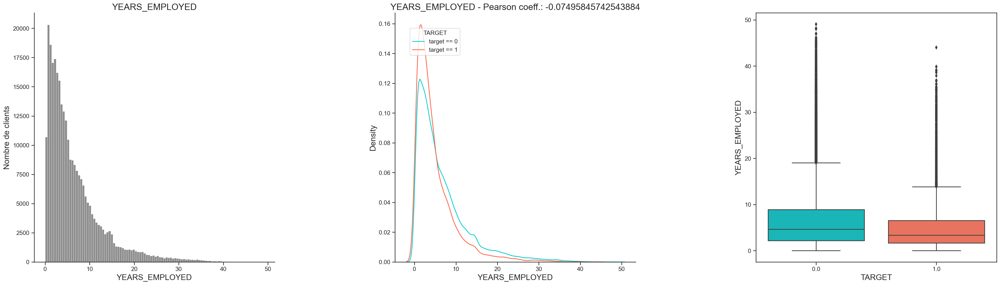

In [32]:
# Visualize the distribution
hist_distrib_target(df_empl, "YEARS_EMPLOYED")

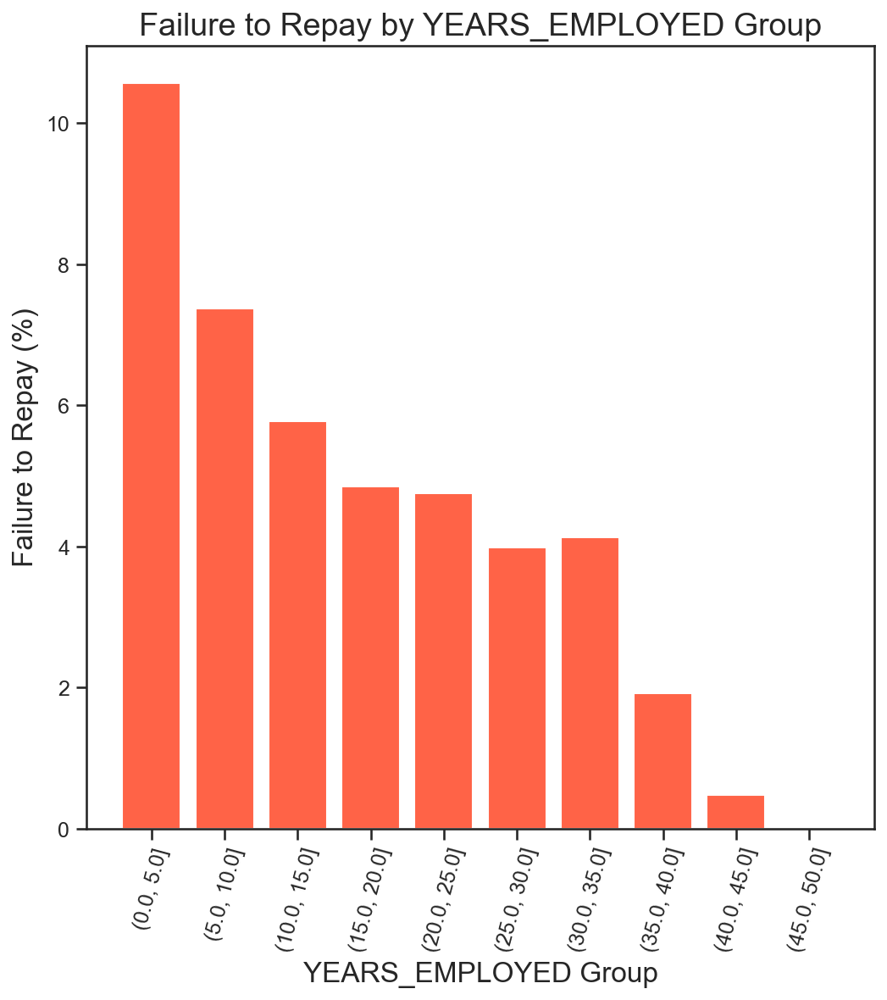

In [33]:
failure_to_repay_graph(df_empl,
                       variable="YEARS_EMPLOYED",
                       bins=np.linspace(0, 50, num=11))

There is a clear trend: people who started the least amount of time before the credit began are most likely to default on the credit.

**Variable "AMT_INCOME_TOTAL**

This variable gives information about the amount of income.

In [34]:
# Know the proportion of missing values
print("Percent of missing values:", missing_data_var(df_app,
                                                     "AMT_INCOME_TOTAL"))

Percent of missing values: 0.0


In [35]:
# Get the descriptive statistics
df_app["AMT_INCOME_TOTAL"].describe()

count    3.562550e+05
mean     1.701161e+05
std      2.235068e+05
min      2.565000e+04
25%      1.125000e+05
50%      1.530000e+05
75%      2.025000e+05
max      1.170000e+08
Name: AMT_INCOME_TOTAL, dtype: float64

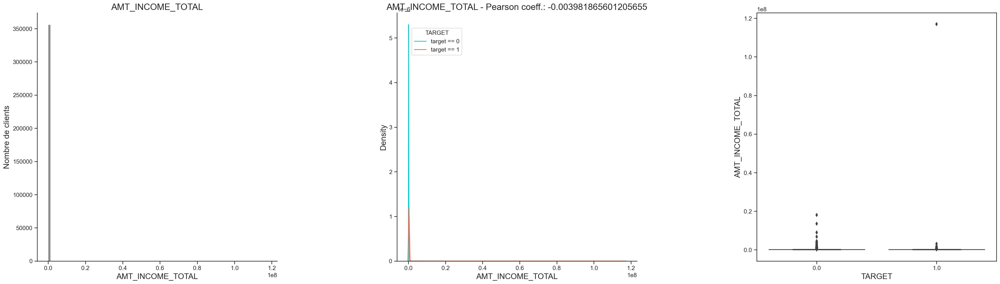

In [36]:
# Plot the distribution histogram
hist_distrib_target(df_app, "AMT_INCOME_TOTAL")

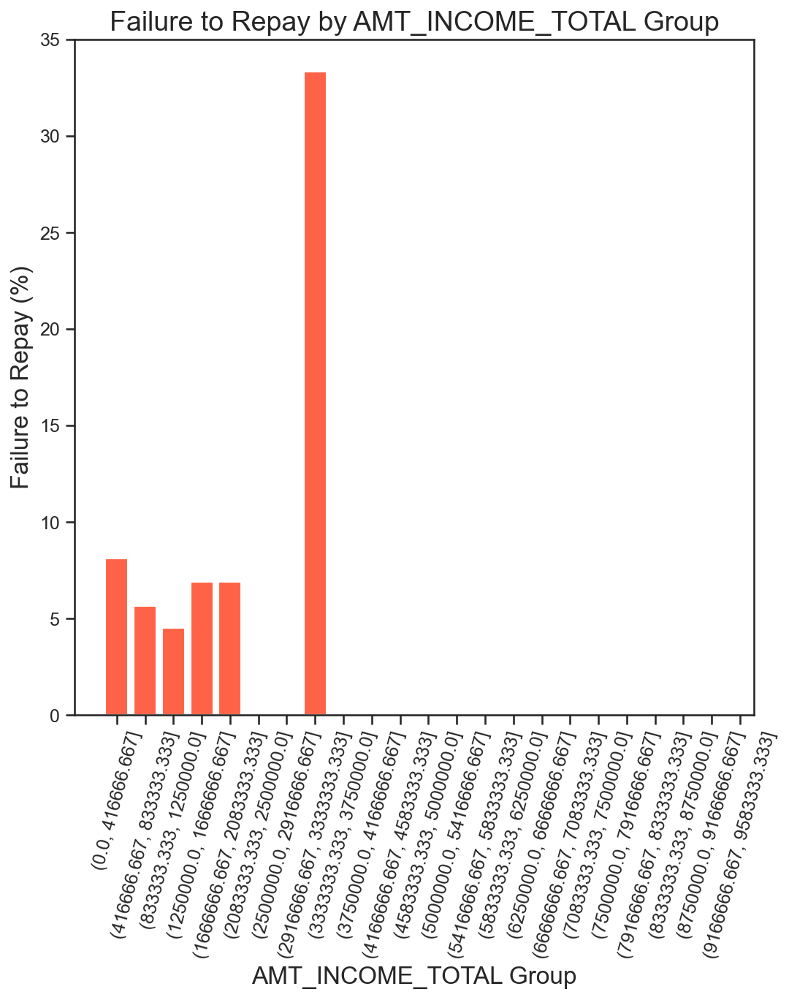

In [37]:
# Make a copy of the dataframe
df_income = df_app.copy()
df_income = df_income[["TARGET", "AMT_INCOME_TOTAL"]]

failure_to_repay_graph(df_income,
                       variable="AMT_INCOME_TOTAL",
                       bins=np.linspace(0, 1.e+07, num=25))

**Variable "AMT_CREDIT"**

This variable gives the credit amount

In [38]:
# Know the proportion of missing values
print("Percent of missing values:", missing_data_var(df_app,
                                                     "AMT_CREDIT"))

Percent of missing values: 0.0


In [39]:
# Get the descriptive statistics
df_app["AMT_CREDIT"].describe()

count    3.562550e+05
mean     5.877674e+05
std      3.986237e+05
min      4.500000e+04
25%      2.700000e+05
50%      5.002110e+05
75%      7.975575e+05
max      4.050000e+06
Name: AMT_CREDIT, dtype: float64

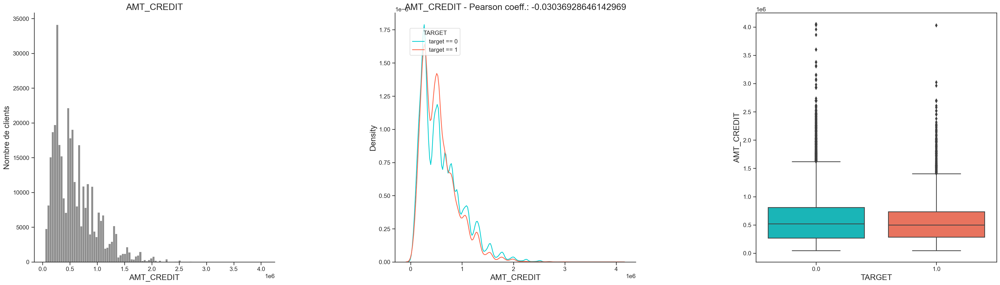

In [40]:
# Plot the distribution histogram
hist_distrib_target(df_app, "AMT_CREDIT")

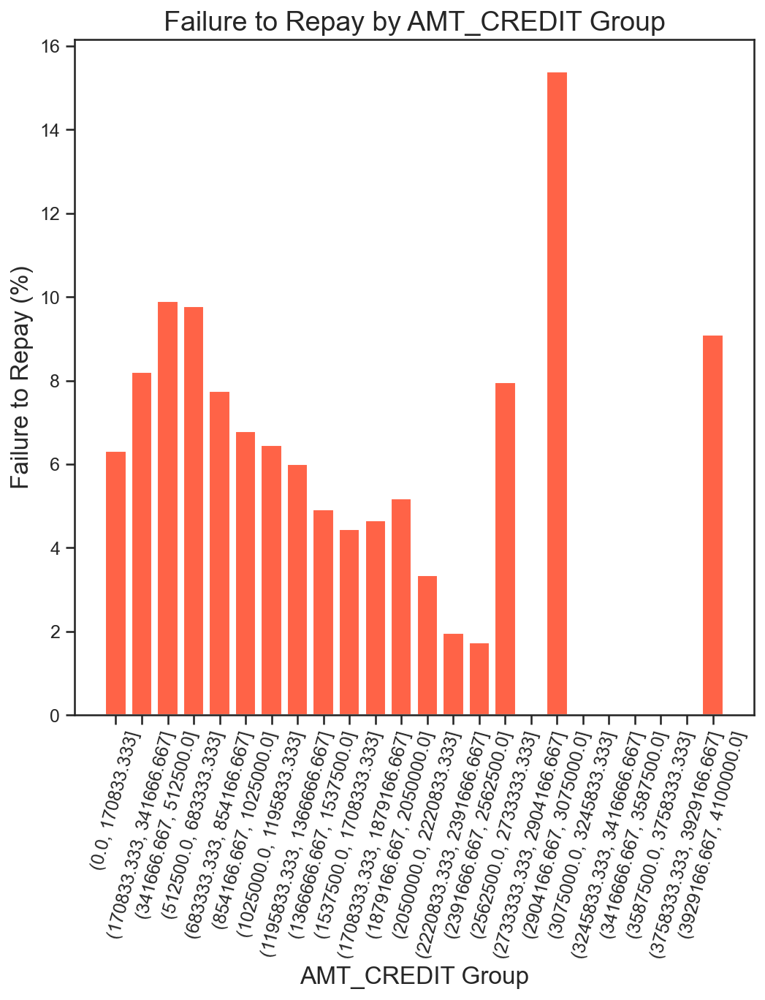

In [41]:
# Make a copy of the dataframe
df_AMT_credit = df_app[["TARGET", "AMT_CREDIT"]]

failure_to_repay_graph(df_AMT_credit,
                       variable="AMT_CREDIT",
                       bins=np.linspace(0, 4.1e+06, num=25))

**Variable "AMT_ANNUITY"**

This variable corresponds to the annuity amount.

In [42]:
# Know the proportion of missing values
print("Percent of missing values:", missing_data_var(df_app,
                                                     "AMT_ANNUITY"))

Percent of missing values: 0.010105121331630433


In [43]:
# Get the descriptive statistics
df_app["AMT_ANNUITY"].describe()

count    356219.000000
mean      27425.560657
std       14732.808190
min        1615.500000
25%       16731.000000
50%       25078.500000
75%       34960.500000
max      258025.500000
Name: AMT_ANNUITY, dtype: float64

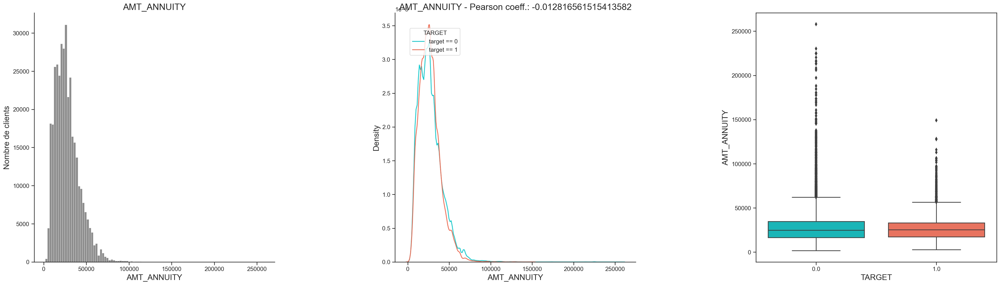

In [44]:
# Plot the distribution histogram
hist_distrib_target(df_app, "AMT_ANNUITY")

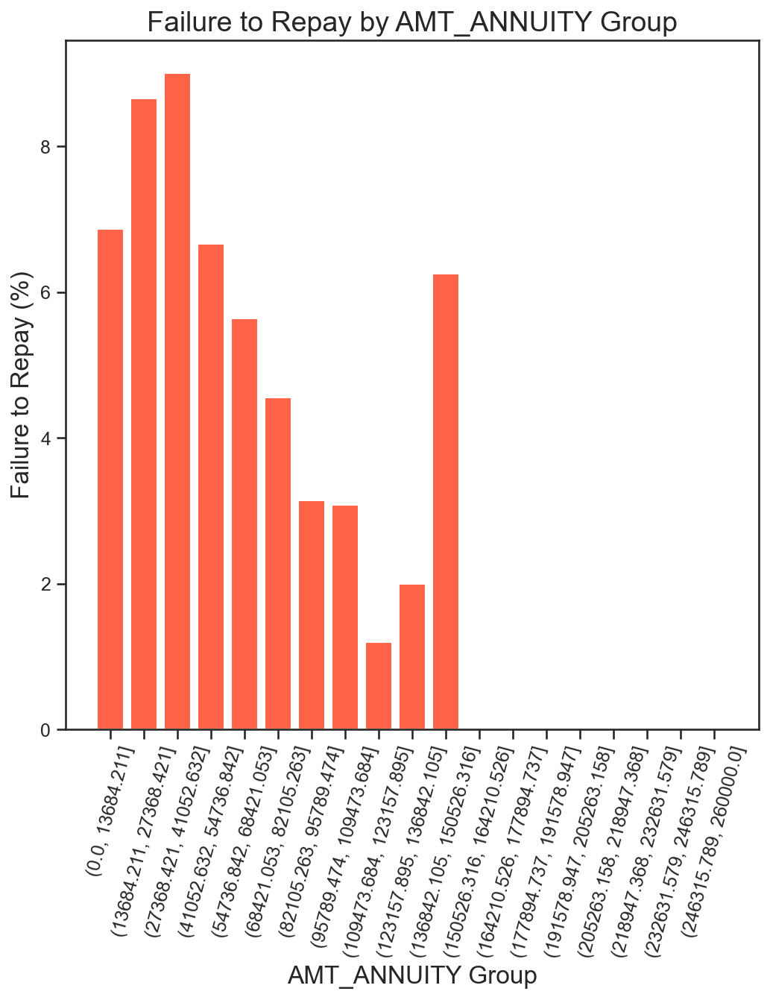

In [45]:
# Make a copy of the dataframe
df_AMT_annuity = df_app[["TARGET", "AMT_ANNUITY"]]

failure_to_repay_graph(df_AMT_annuity,
                       variable="AMT_ANNUITY",
                       bins=np.linspace(0, 260000, num=20))

**Variable "AMT_GOODS_PRICE"**

For consumer loans, it is the price of the goods for which the loan is given.

In [46]:
# Know the proportion of missing values
print("Percent of missing values:", missing_data_var(df_app,
                                                     "AMT_GOODS_PRICE"))

Percent of missing values: 0.07803399250536834


In [47]:
# Get the descriptive statistics
df_app["AMT_GOODS_PRICE"].describe()

count    3.559770e+05
mean     5.280200e+05
std      3.660650e+05
min      4.050000e+04
25%      2.340000e+05
50%      4.500000e+05
75%      6.750000e+05
max      4.050000e+06
Name: AMT_GOODS_PRICE, dtype: float64

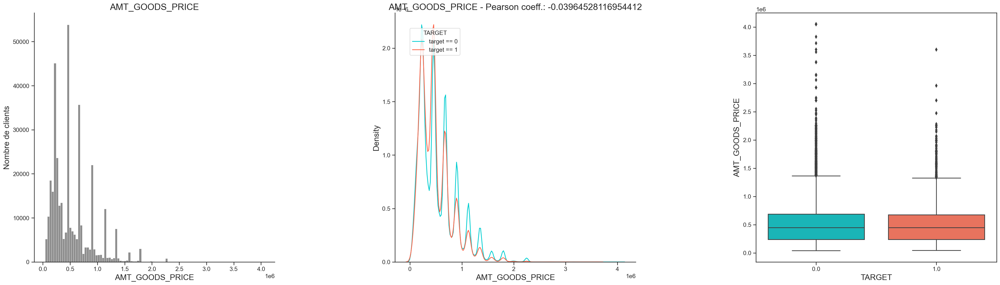

In [48]:
# Plot the distribution histogram
hist_distrib_target(df_app, "AMT_GOODS_PRICE")

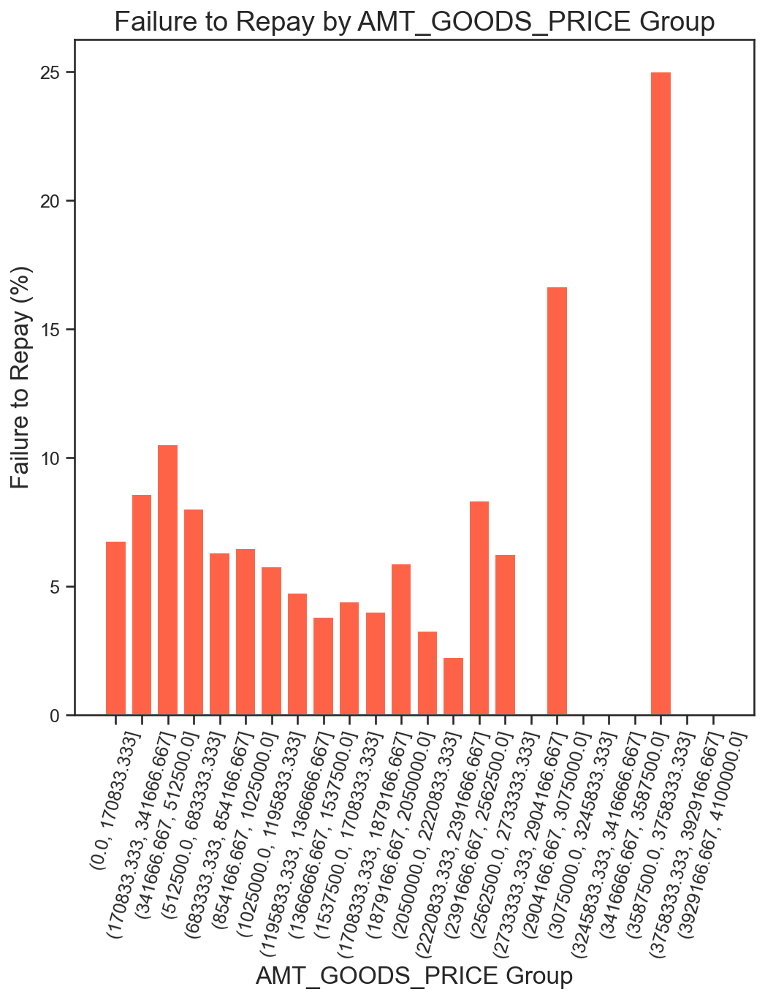

In [49]:
# Make a copy of the dataframe
df_amt_goods = df_app[["TARGET", "AMT_GOODS_PRICE"]]

failure_to_repay_graph(df_amt_goods,
                       variable="AMT_GOODS_PRICE",
                       bins=np.linspace(0, 4.1e+06, num=25))

**Variable "DAYS_REGISTRATION"**

How many days before the application did client change his registration,time only relative to the application.

In [50]:
# Know the proportion of missing values
print("Percent of missing values:", missing_data_var(df_app,
                                                     "DAYS_REGISTRATION"))

Percent of missing values: 0.0


In [51]:
# Get the descriptive statistics
df_app["DAYS_REGISTRATION"].describe()

count    356255.000000
mean      -4983.593527
std        3526.968986
min      -24672.000000
25%       -7477.000000
50%       -4502.000000
75%       -1995.000000
max           0.000000
Name: DAYS_REGISTRATION, dtype: float64

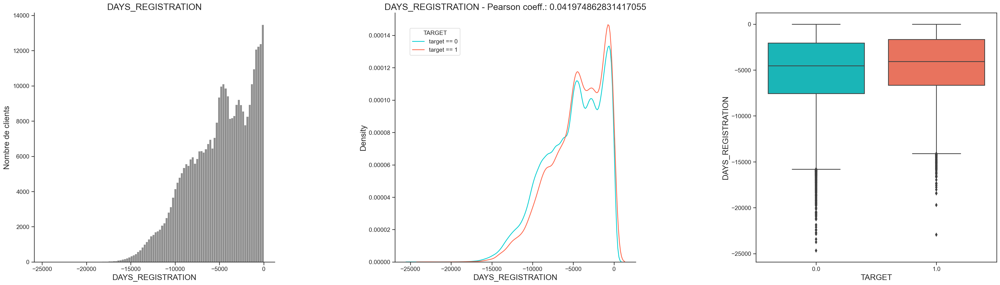

In [52]:
# Plot the distribution histogram
hist_distrib_target(df_app, "DAYS_REGISTRATION")

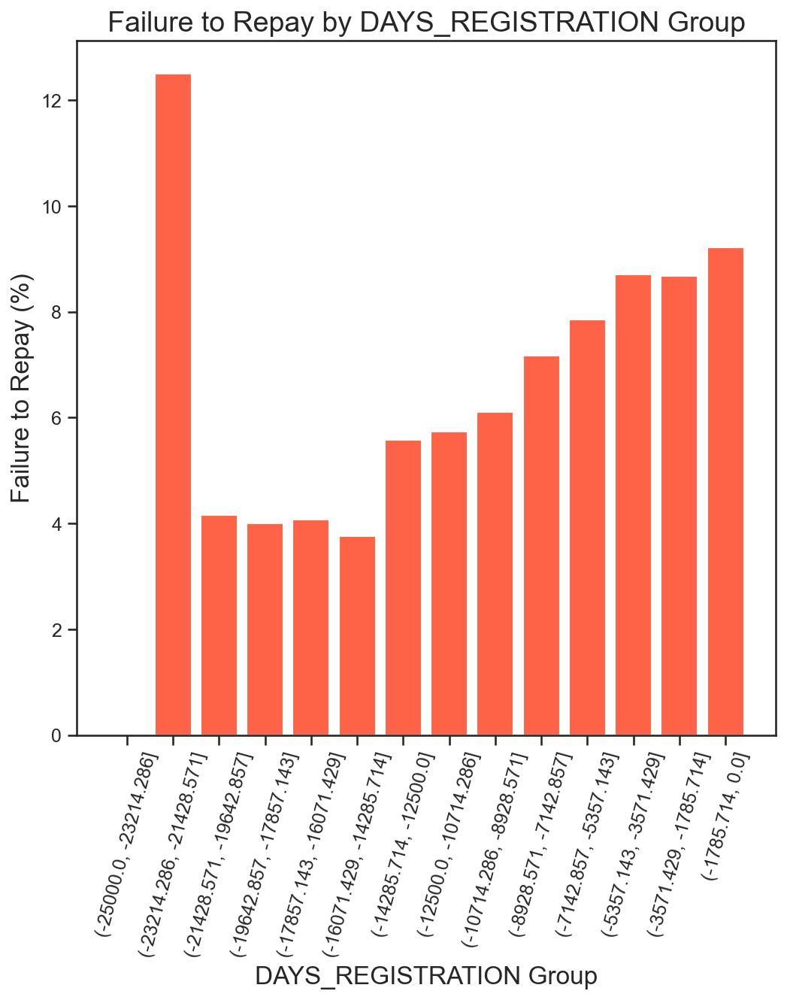

In [53]:
# Make a copy of the dataframe
df_days_reg = df_app[["TARGET", "DAYS_REGISTRATION"]]

failure_to_repay_graph(df_days_reg,
                       variable="DAYS_REGISTRATION",
                       bins=np.linspace(-25000, 0, num=15))

**Variable "DAYS_ID_PUBLISH"**

How many days before the application did client change the identity document with which he applied for the loan,time only relative to the application.

In [54]:
# Know the proportion of missing values
print("Percent of missing values:", missing_data_var(df_app,
                                                     "DAYS_ID_PUBLISH"))

Percent of missing values: 0.0


In [55]:
# Get the descriptive statistics
df_app["DAYS_ID_PUBLISH"].describe()

count    356255.000000
mean      -3002.071163
std        1517.901735
min       -7197.000000
25%       -4318.000000
50%       -3252.000000
75%       -1717.000000
max           0.000000
Name: DAYS_ID_PUBLISH, dtype: float64

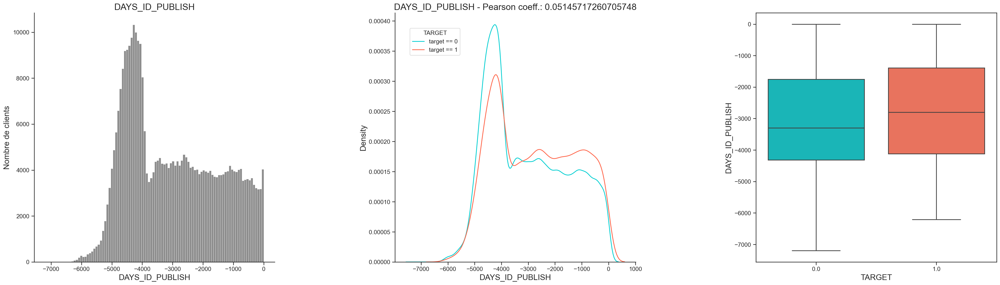

In [56]:
# Plot the distribution histogram
hist_distrib_target(df_app, "DAYS_ID_PUBLISH")

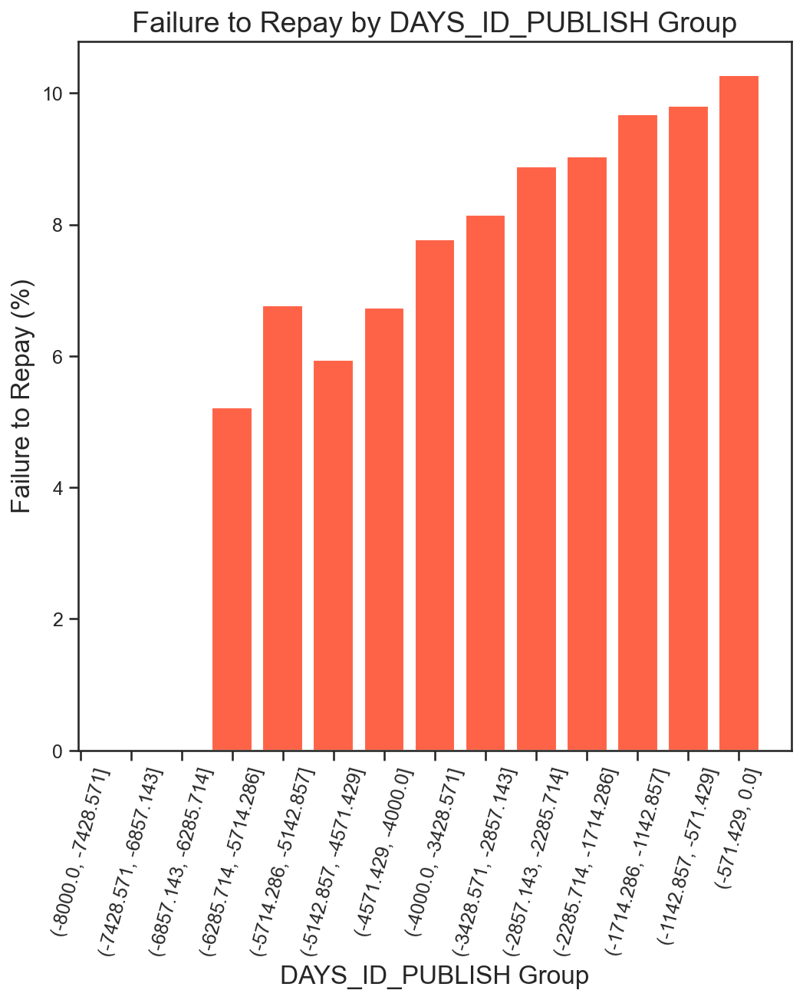

In [57]:
# Make a copy of the dataframe
df_days_id = df_app[["TARGET", "DAYS_ID_PUBLISH"]]

failure_to_repay_graph(df_days_id,
                       variable="DAYS_ID_PUBLISH",
                       bins=np.linspace(-8000, 0, num=15))

**Variable "CNT_CHILDREN"**

Number of children the client has

In [58]:
# Know the proportion of missing values
print("Percent of missing values:", missing_data_var(df_app,
                                                     "CNT_CHILDREN"))

Percent of missing values: 0.0


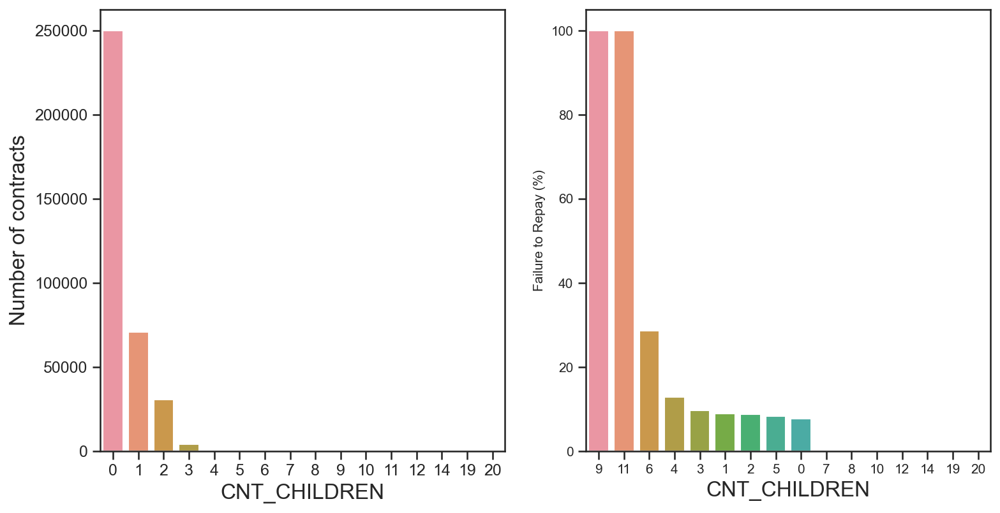

In [59]:
# Visualize the number of clients in each category
hist_distrib_cat(df_app, "CNT_CHILDREN")

Most of the clients taking a loan have no children. The number of loans associated with the clients with one children are 4 times smaller, the number of loans associated with the clients with two children are 8 times smaller; clients with 3, 4 or more children are much more rare.

As for repayment, clients with no children, 1, 2, 3, and 5 children have percents of no repayment around the average (10%). The clients with 4 and 6 children are above average in terms of percent of not paid back loans (over 25% for families with 6 children).

As for clients with 9 or 11 children, the percent of loans not repaid is 100%.

**Variable "CNT_FAM_MEMBERS"**

How many family members does client have

In [60]:
# Know the proportion of missing values
print("Percent of missing values:", missing_data_var(df_app,
                                                     "CNT_FAM_MEMBERS"))

Percent of missing values: 0.0005613956295350241


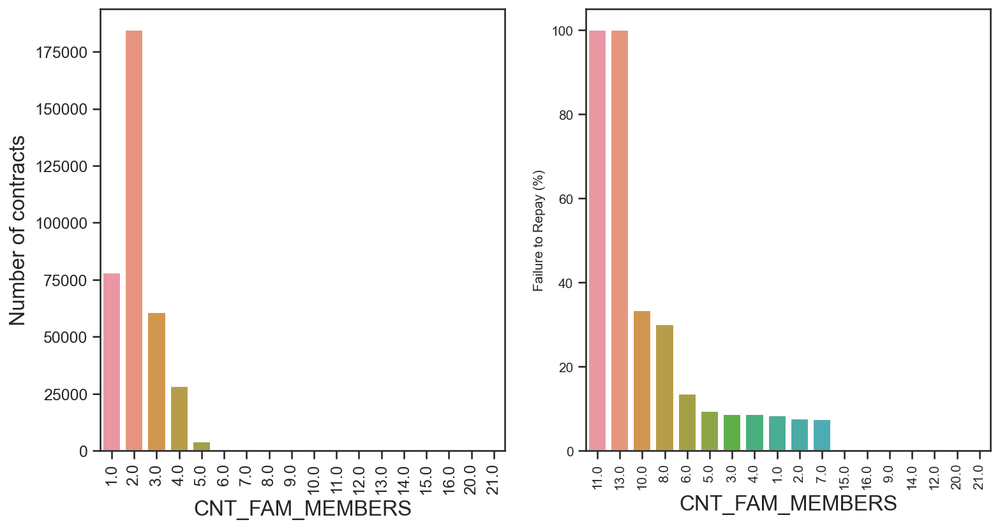

In [61]:
# Visualize the number of clients in each category
hist_distrib_cat(df_app, "CNT_FAM_MEMBERS", label_rotation=True)

Clients with family members of 2 are most numerous, followed by 1 (single persons), 3 (families with one child) and 4.

Clients with family size of 11 and 13 have 100% not repayment rate. Other families with 10 or 8 members have percents of not repayment of loans over 30%. Families with 6 or less members have repayment rates close to the 10% average.

**Variable "REGION_POPULATION_RELATIVE"**

In [62]:
# Know the proportion of missing values
print("Percent of missing values:", missing_data_var(df_app,
                                                     "REGION_POPULATION_RELATIVE"))

Percent of missing values: 0.0


In [63]:
# Get the descriptive statistics
df_app["REGION_POPULATION_RELATIVE"].describe()

count    356255.000000
mean          0.020917
std           0.013915
min           0.000253
25%           0.010006
50%           0.018850
75%           0.028663
max           0.072508
Name: REGION_POPULATION_RELATIVE, dtype: float64

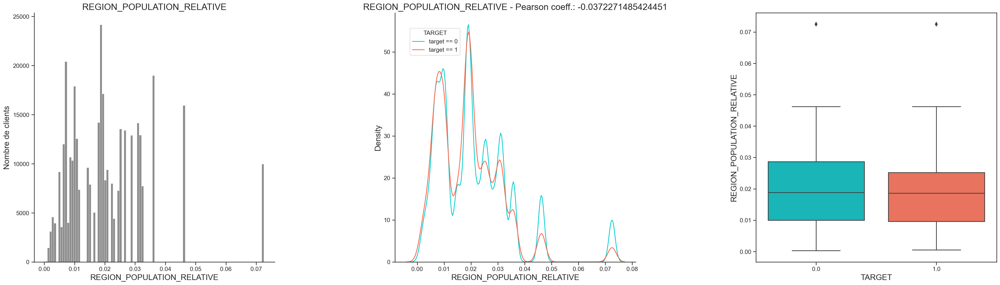

In [64]:
# Plot the distribution histogram
hist_distrib_target(df_app, "REGION_POPULATION_RELATIVE")


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


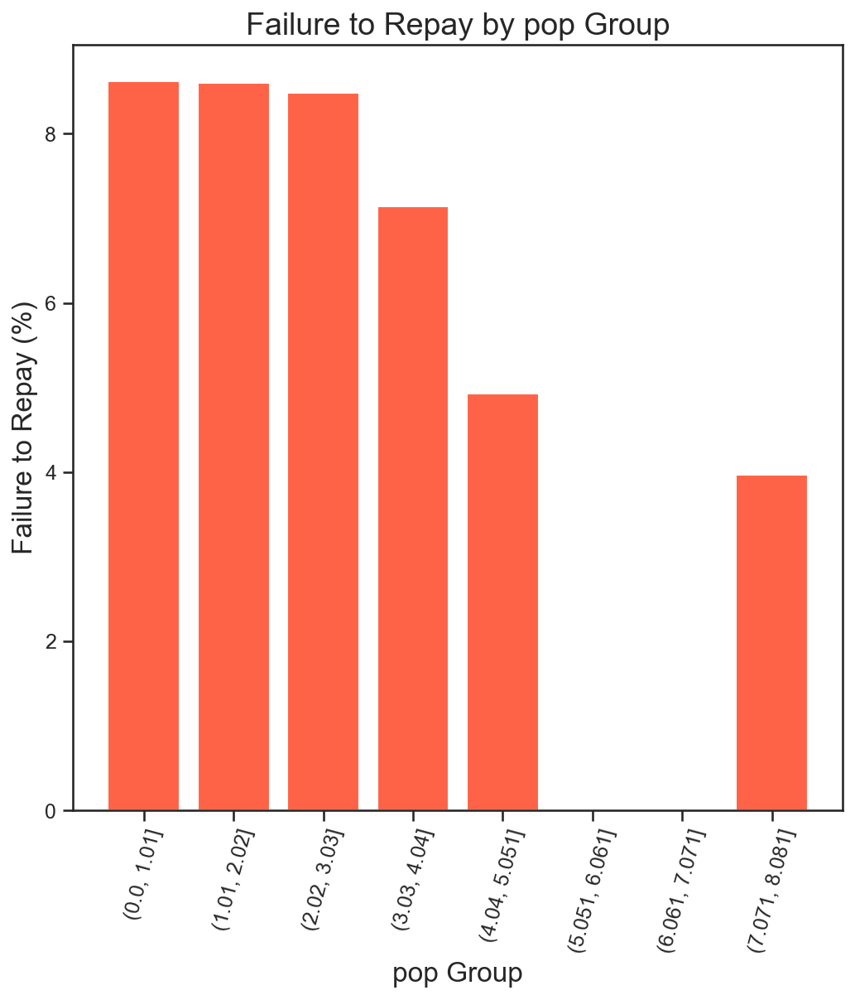

In [65]:
# Make a copy of the dataframe
df_reg = df_app[["TARGET", "REGION_POPULATION_RELATIVE"]]
df_reg["pop"] = df_reg["REGION_POPULATION_RELATIVE"] * 100

failure_to_repay_graph(df_reg,
                       variable="pop",
                       bins=np.linspace(0, 100, num=100))

**Variables that flag client coordinate**

Percent of missing values: 0.0


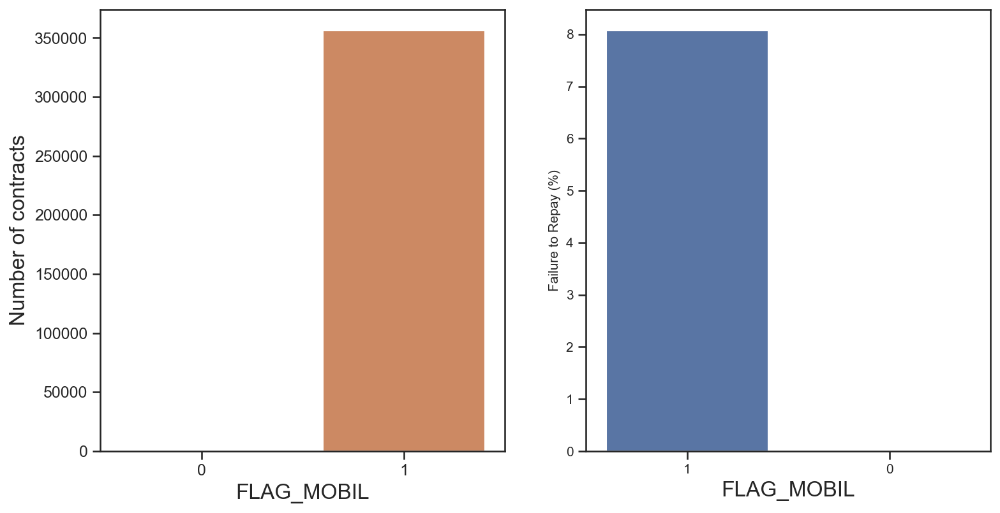

Percent of missing values: 0.0


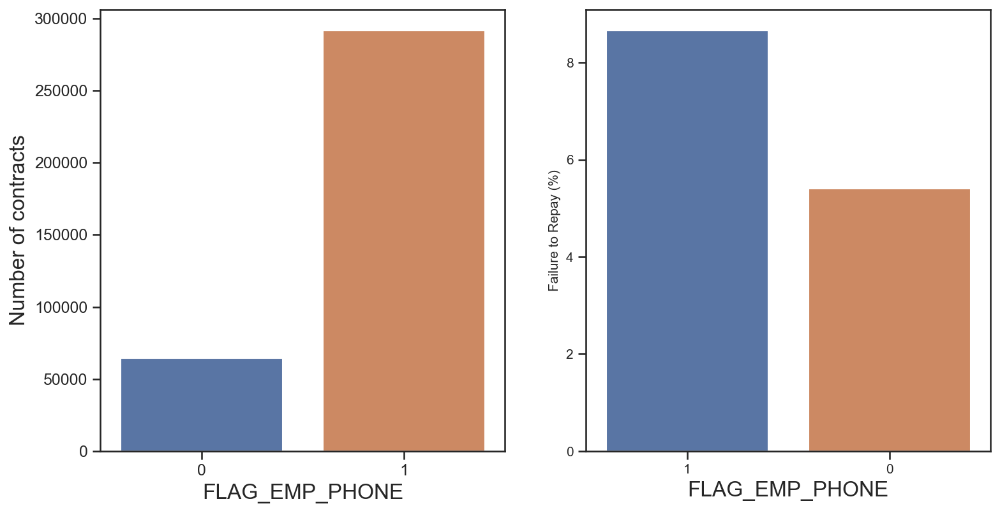

Percent of missing values: 0.0


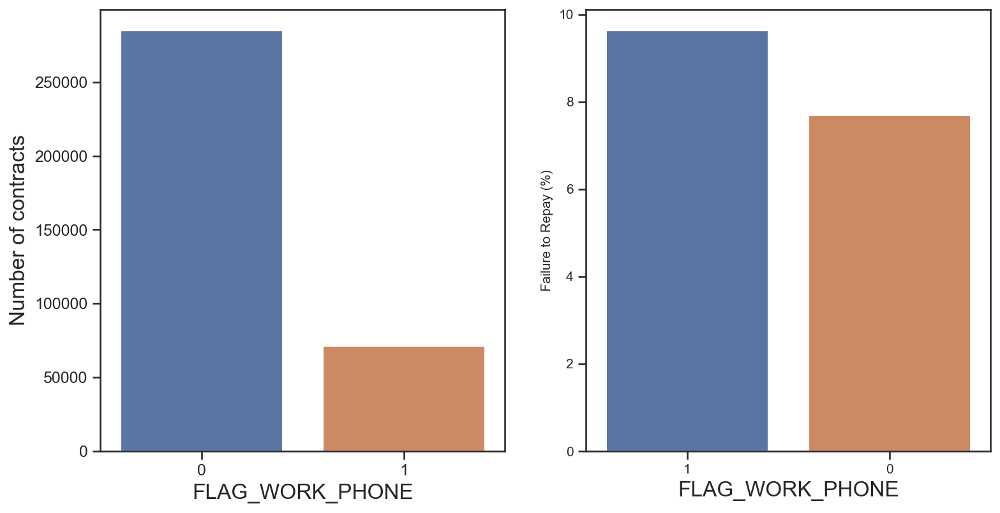

Percent of missing values: 0.0


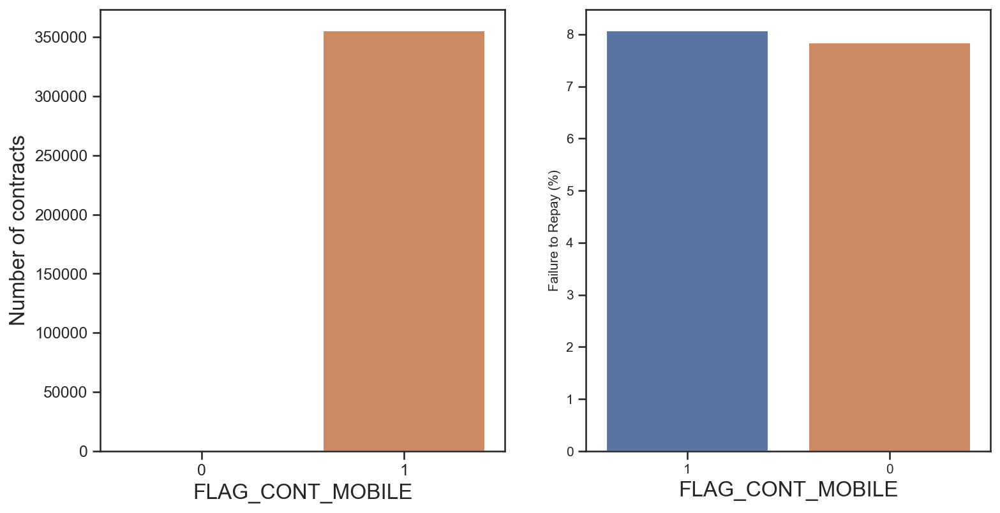

Percent of missing values: 0.0


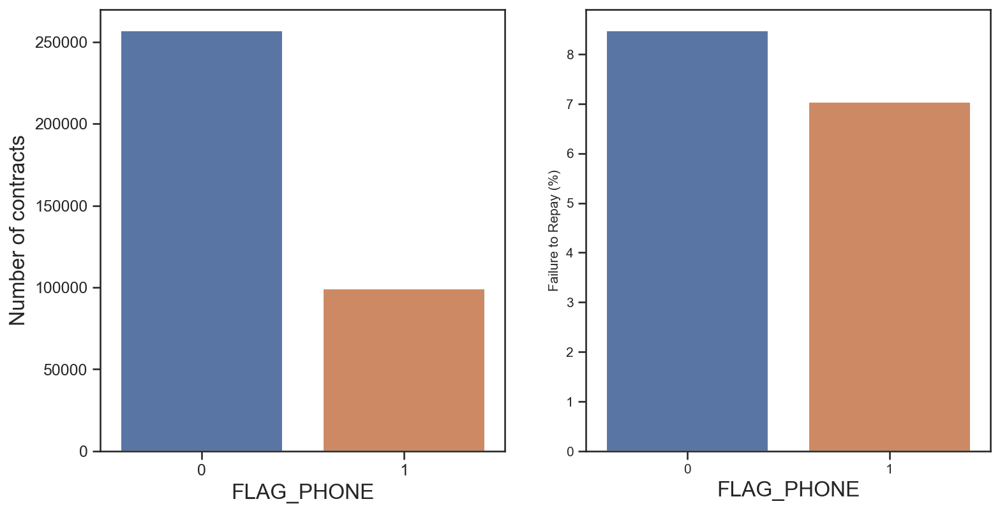

Percent of missing values: 0.0


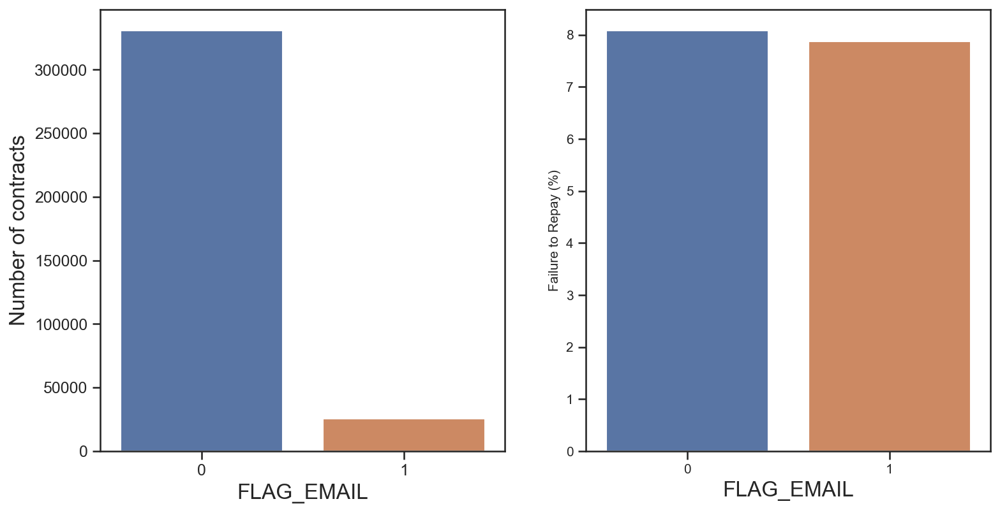

In [66]:
# Create a list with the variables
flag_coord_variables = ["FLAG_MOBIL",
                        "FLAG_EMP_PHONE",
                        "FLAG_WORK_PHONE",
                        "FLAG_CONT_MOBILE",
                        "FLAG_PHONE",
                        "FLAG_EMAIL"]

for var in flag_coord_variables:
    # Know the proportion of missing values
    print("Percent of missing values:", missing_data_var(df_app, var))
    hist_distrib_cat(df_app, var)

**Variables about region rating**

Percent of missing values: 0.0


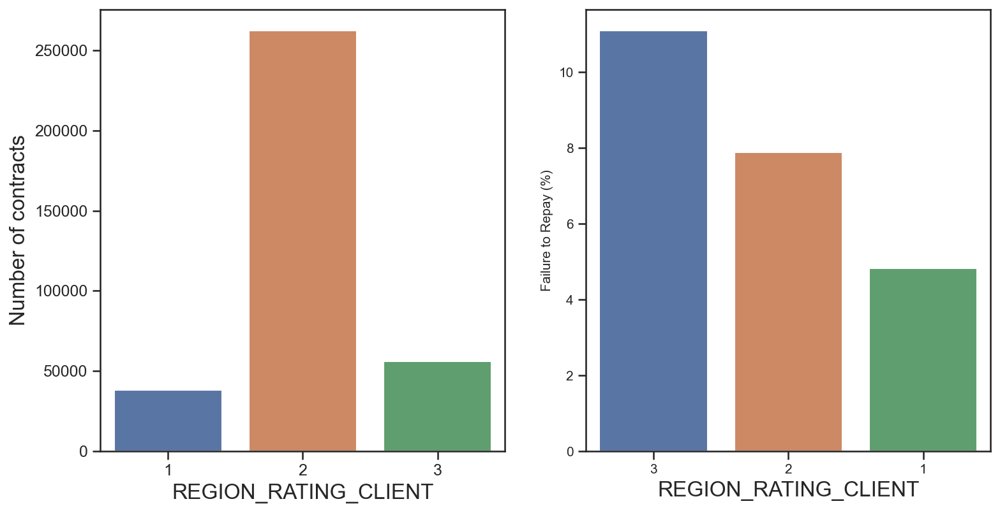

Percent of missing values: 0.0


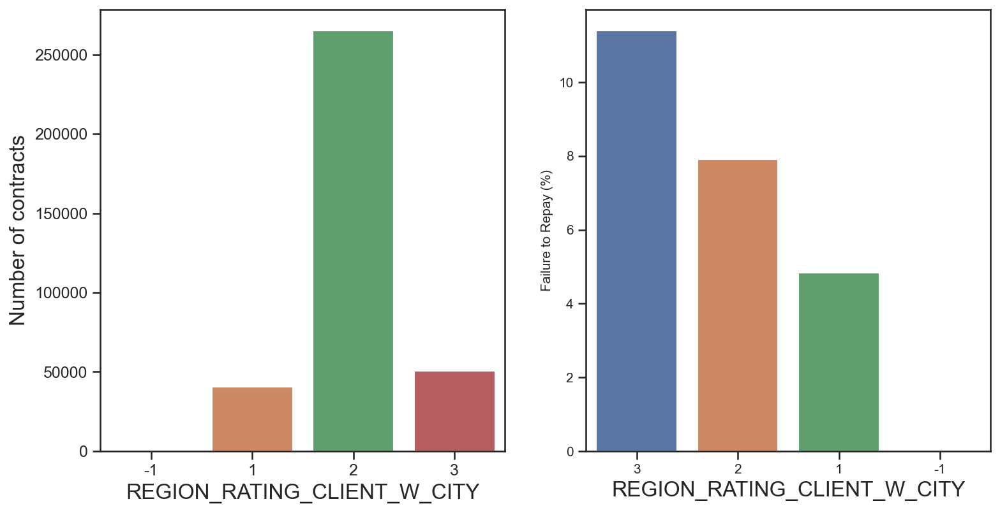

In [67]:
region_rating_variables = ["REGION_RATING_CLIENT",
                           "REGION_RATING_CLIENT_W_CITY"]

for var in region_rating_variables:
    # Know the proportion of missing values
    print("Percent of missing values:", missing_data_var(df_app, var))
    hist_distrib_cat(df_app, var)

In [68]:
# Know the number of outliers (client with value -1)
df_app["REGION_RATING_CLIENT_W_CITY"].value_counts()

 2    265260
 3     50652
 1     40342
-1         1
Name: REGION_RATING_CLIENT_W_CITY, dtype: int64

In [69]:
# Drop the outlier
index_to_drop = df_app.index[df_app["REGION_RATING_CLIENT_W_CITY"] == -1]
df_app.drop(index=index_to_drop, axis=0, inplace=True)

**Varibles about region or city work**

For REG_REGION_NOT_LIVE_REGION
Percent of missing values: 0.0
Correlation_coefficient with target: 0.005575944520908482


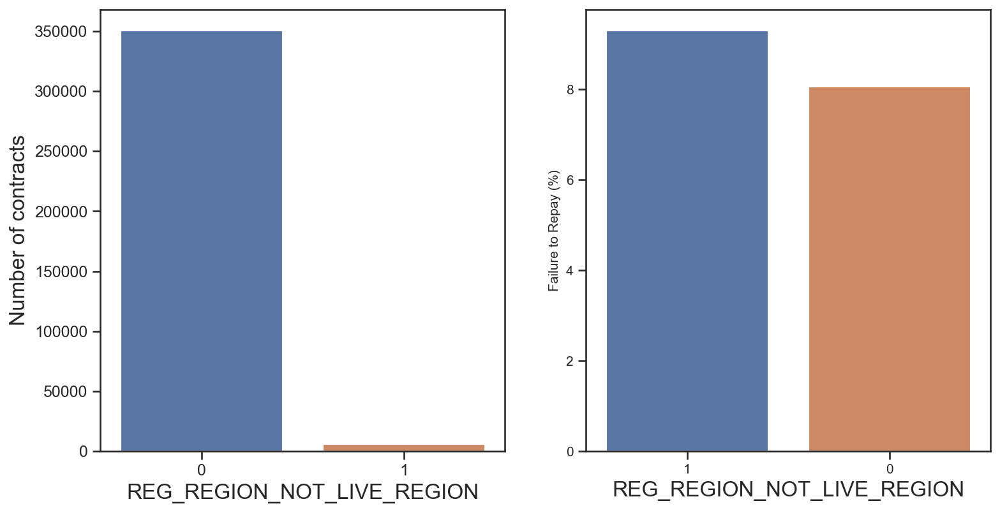

For REG_REGION_NOT_WORK_REGION
Percent of missing values: 0.0
Correlation_coefficient with target: 0.006941907545371594


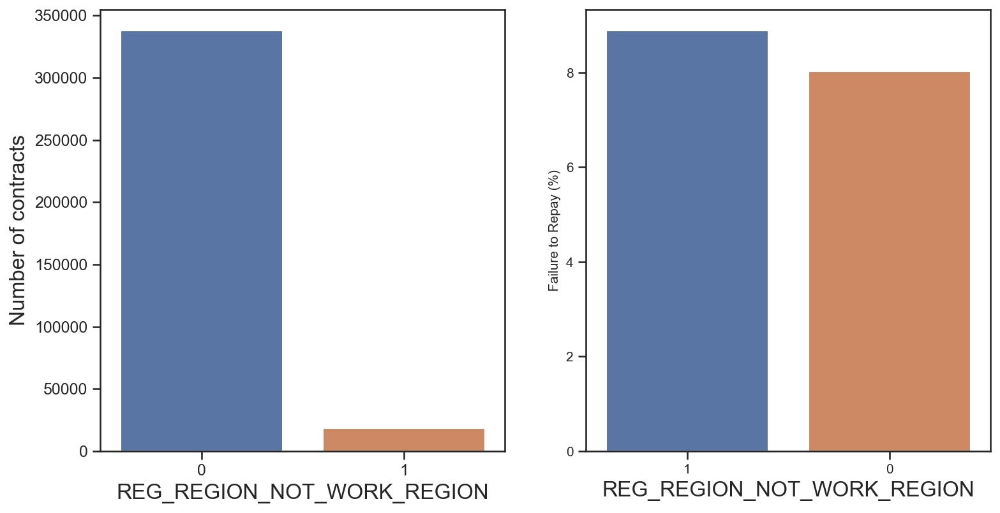

For LIVE_REGION_NOT_WORK_REGION
Percent of missing values: 0.0
Correlation_coefficient with target: 0.002819479184158835


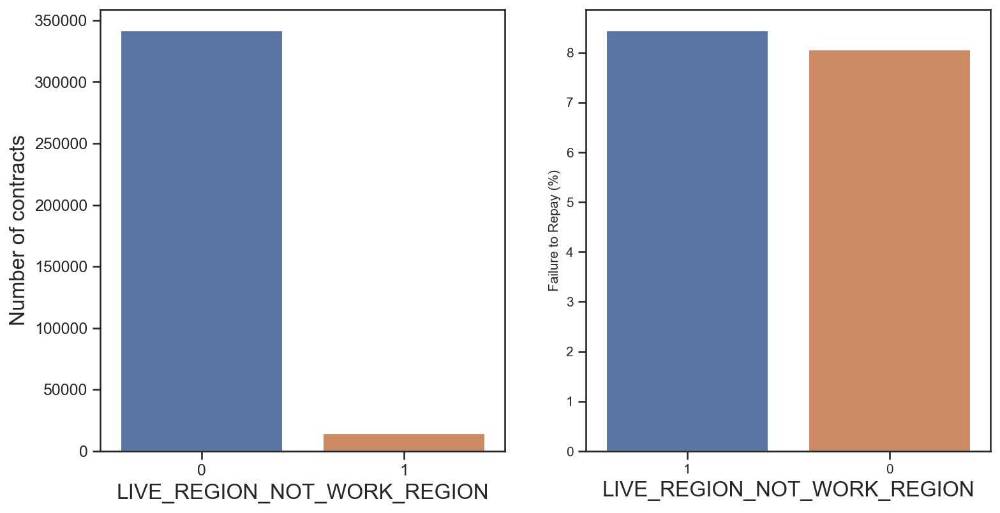

For REG_CITY_NOT_LIVE_CITY
Percent of missing values: 0.0
Correlation_coefficient with target: 0.04439537480570117


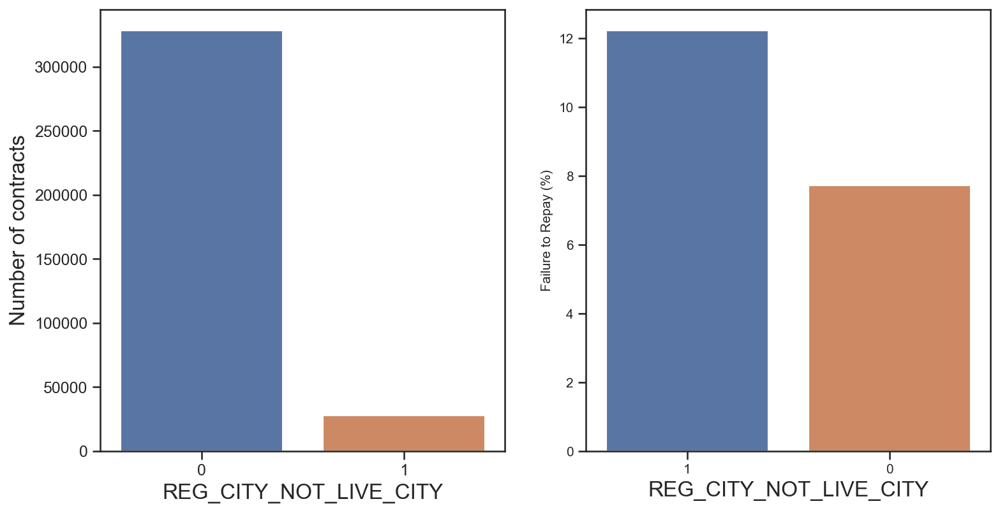

For REG_CITY_NOT_WORK_CITY
Percent of missing values: 0.0
Correlation_coefficient with target: 0.0509944643681266


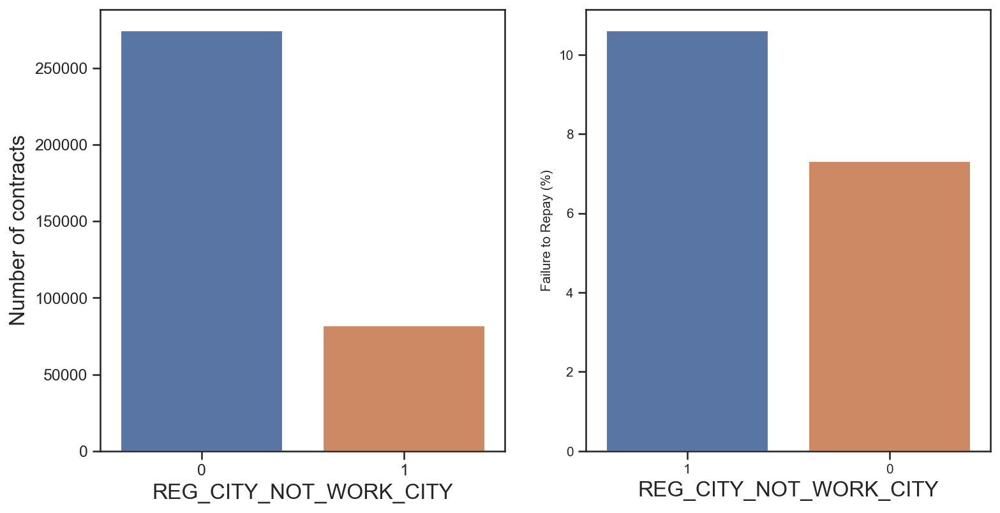

For LIVE_CITY_NOT_WORK_CITY
Percent of missing values: 0.0
Correlation_coefficient with target: 0.03251834110149901


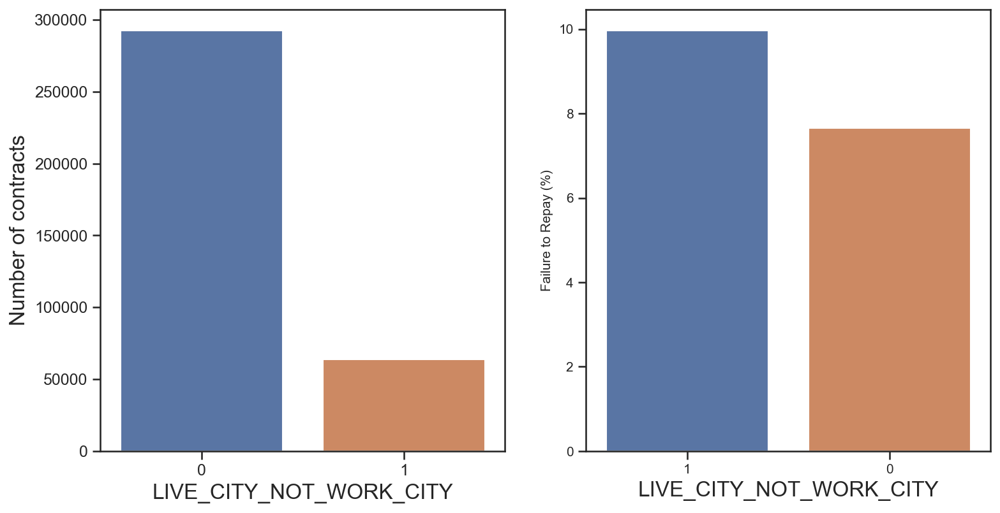

In [70]:
region_city_variables = ["REG_REGION_NOT_LIVE_REGION",
                         "REG_REGION_NOT_WORK_REGION",
                         "LIVE_REGION_NOT_WORK_REGION",
                         "REG_CITY_NOT_LIVE_CITY",
                         "REG_CITY_NOT_WORK_CITY",
                         "LIVE_CITY_NOT_WORK_CITY"]

for var in region_city_variables:
    # Know the proportion of missing values
    print("For", var)
    print("Percent of missing values:", missing_data_var(df_app, var))
    corr_coeff = df_app["TARGET"].corr(df_app[var])
    print("Correlation_coefficient with target:", corr_coeff)
    hist_distrib_cat(df_app, var)

**Variables "exterior source"**

These variables correspond to normalized scores of external data sources. "EXT_SOURCE_1" was delete from the dataset because of the high proportion of missing values. I will look at "EXT_SOURCE_2" and "EXT_SOURCE_3".

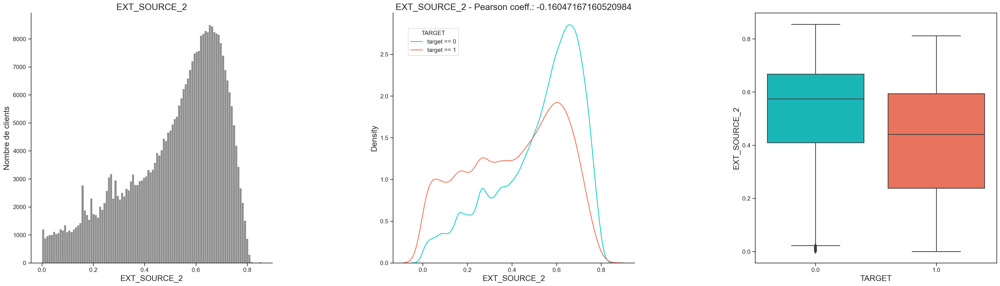

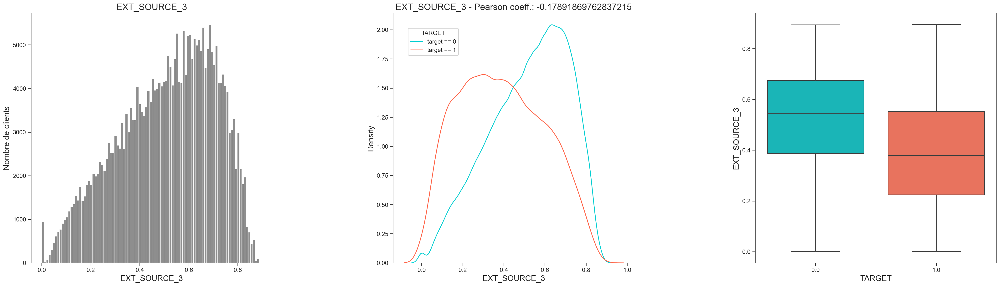

In [71]:
# Plot the distribution of these variables
hist_distrib_target(df_app, "EXT_SOURCE_2")
hist_distrib_target(df_app, "EXT_SOURCE_3")

Text(0.5, 1.0, 'Correlation Heatmap')

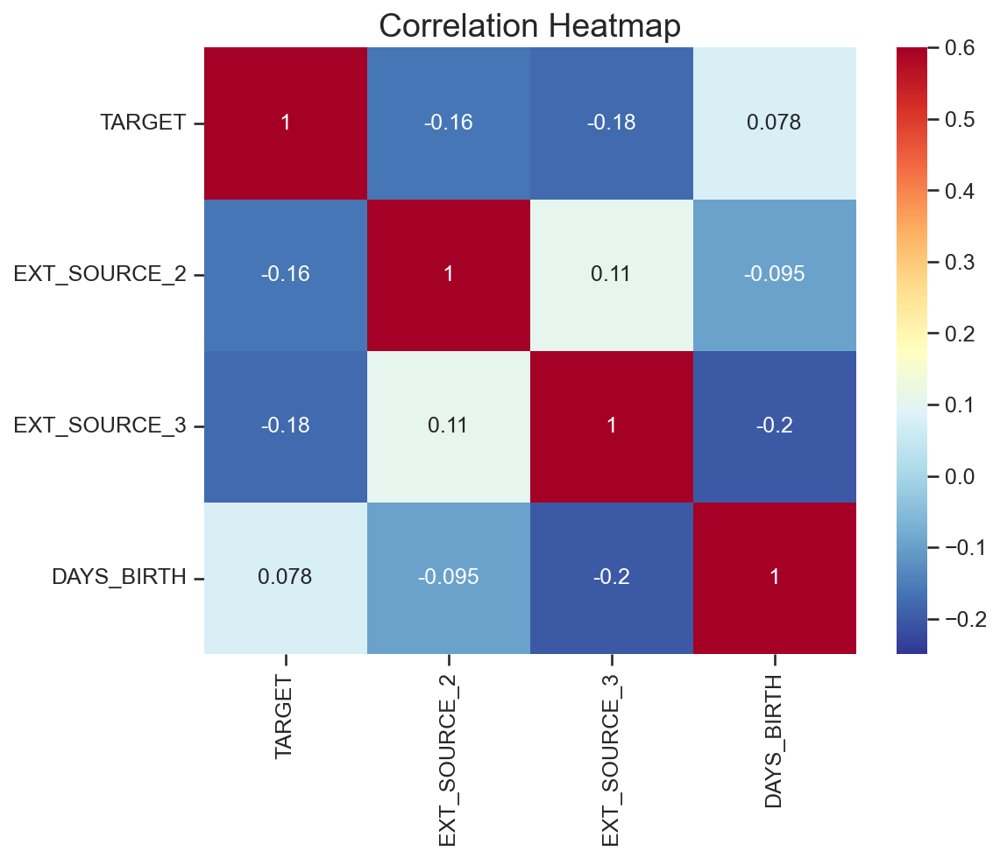

In [72]:
# Calculate the correlation matrix
df_ext_data = df_app[["TARGET",
                      "EXT_SOURCE_2",
                      "EXT_SOURCE_3",
                      "DAYS_BIRTH"]]
ext_data_corrs = df_ext_data.corr()

# Create a heatmap to show the correlation coefficient
plt.figure(figsize=(8, 6))
sns.heatmap(ext_data_corrs,
            cmap=plt.cm.RdYlBu_r,
            vmin=-0.25,
            annot=True,
            vmax=0.6)
plt.title('Correlation Heatmap')

The two EXT_SOURCE features have negative correlations with the target, indicating that as the value of the EXT_SOURCE increases, the client is more likely to repay the loan.

**Variables about social circle**

For OBS_30_CNT_SOCIAL_CIRCLE
Percent of missing values: 0.29473353281647363
Correlation_coefficient with target: 0.009130665702776389


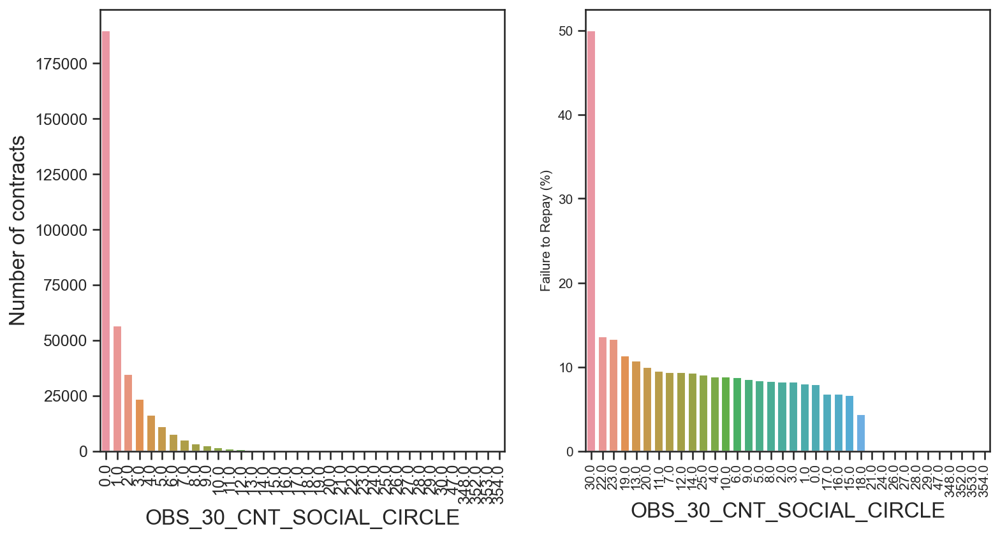

For DEF_30_CNT_SOCIAL_CIRCLE
Percent of missing values: 0.29473353281647363
Correlation_coefficient with target: 0.032247579253044396


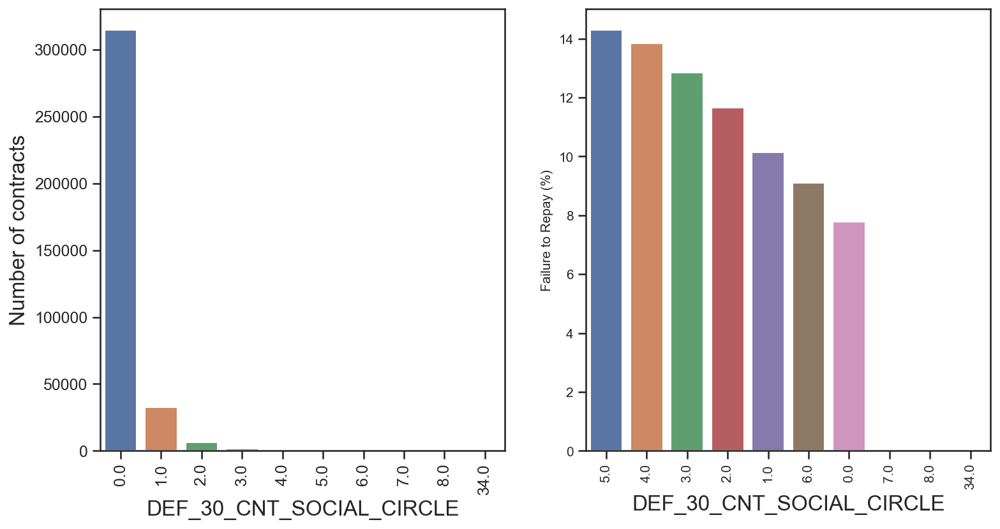

For OBS_60_CNT_SOCIAL_CIRCLE
Percent of missing values: 0.29473353281647363
Correlation_coefficient with target: 0.00902214363021487


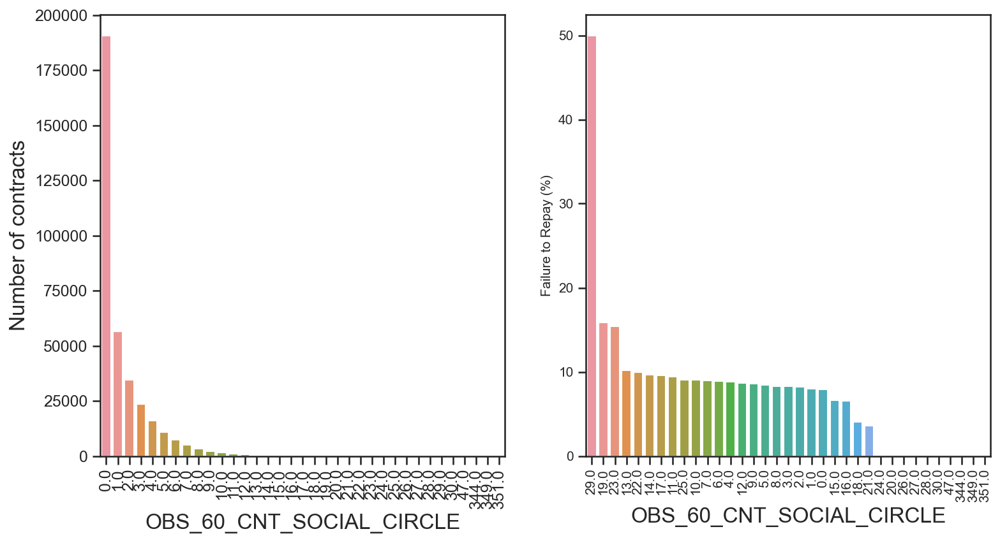

For DEF_60_CNT_SOCIAL_CIRCLE
Percent of missing values: 0.29473353281647363
Correlation_coefficient with target: 0.031276472126436465


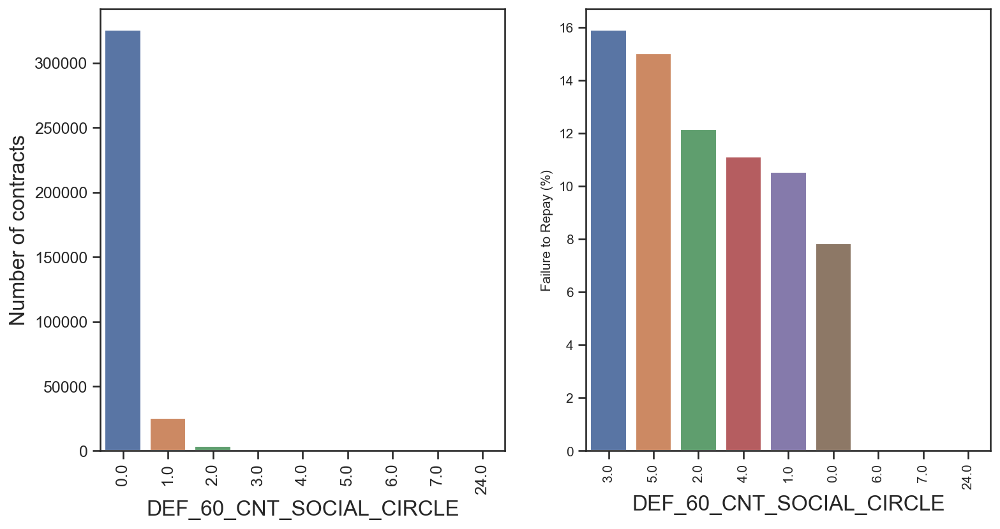

In [73]:
social_circle_variables = ["OBS_30_CNT_SOCIAL_CIRCLE",
                           "DEF_30_CNT_SOCIAL_CIRCLE",
                           "OBS_60_CNT_SOCIAL_CIRCLE",
                           "DEF_60_CNT_SOCIAL_CIRCLE"]

for var in social_circle_variables:
    # Know the proportion of missing values
    print("For", var)
    print("Percent of missing values:", missing_data_var(df_app, var))
    corr_coeff = df_app["TARGET"].corr(df_app[var])
    print("Correlation_coefficient with target:", corr_coeff)
    hist_distrib_cat(df_app, var, label_rotation=True)

**Variable "DAYS_LAST_PHONE_CHANGE"**

In [74]:
# Know the proportion of missing values
print("Percent of missing values:", missing_data_var(df_app,
                                                     "DAYS_LAST_PHONE_CHANGE"))

Percent of missing values: 0.00028069860268235586


In [75]:
# Get the descriptive statistics
df_app["DAYS_LAST_PHONE_CHANGE"].describe()

count    356253.000000
mean       -978.581719
std         835.064914
min       -4361.000000
25%       -1592.000000
50%        -771.000000
75%        -286.000000
max           0.000000
Name: DAYS_LAST_PHONE_CHANGE, dtype: float64

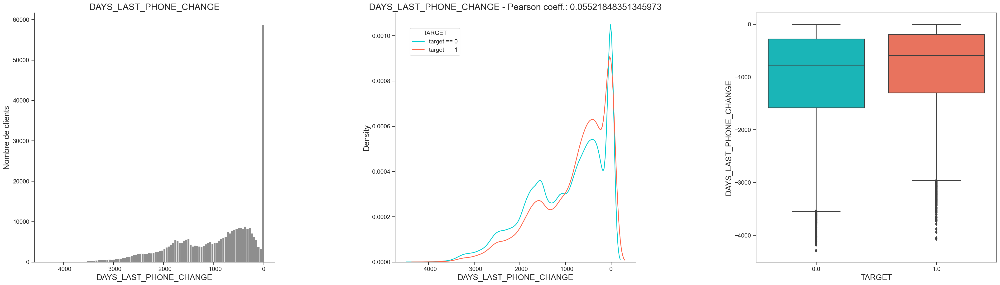

In [76]:
# Plot the distribution histogram
hist_distrib_target(df_app, "DAYS_LAST_PHONE_CHANGE")

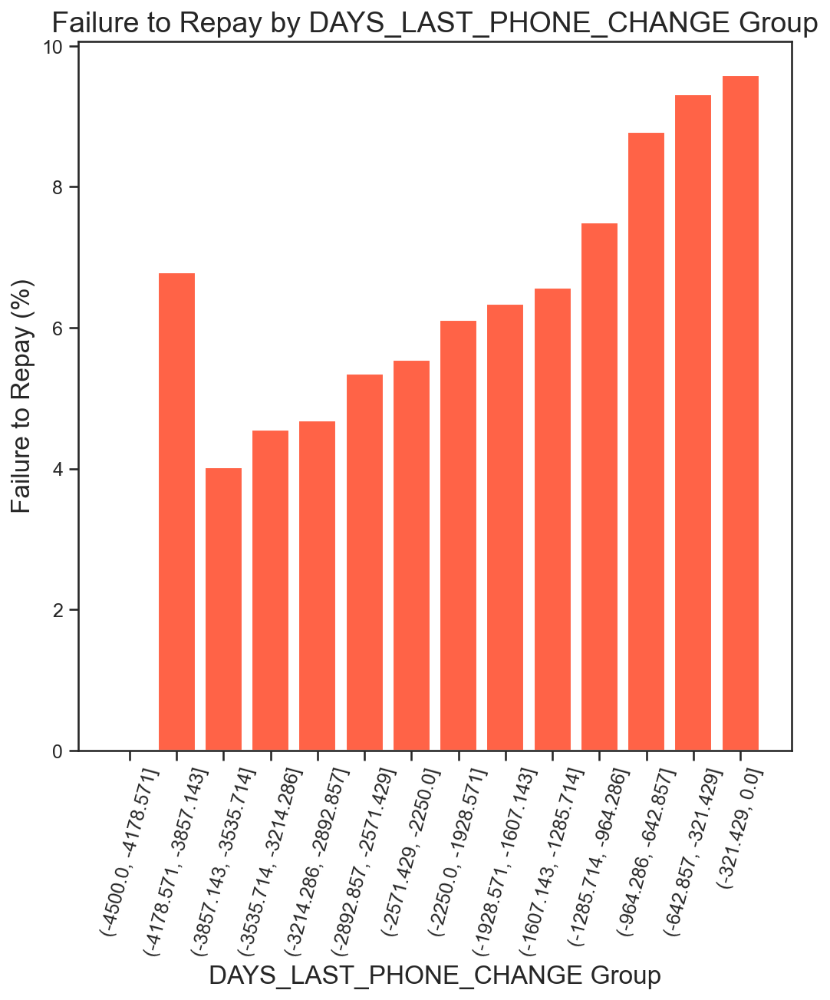

In [77]:
# Make a copy of the dataframe
df_phone = df_app[["TARGET", "DAYS_LAST_PHONE_CHANGE"]]

failure_to_repay_graph(df_phone,
                       variable="DAYS_LAST_PHONE_CHANGE",
                       bins=np.linspace(-4500, 0, num=15))

**Variables about flag documents**

For FLAG_DOCUMENT_2
Percent of missing values: 0.0
Correlation_coefficient with target: 0.005417144279619342


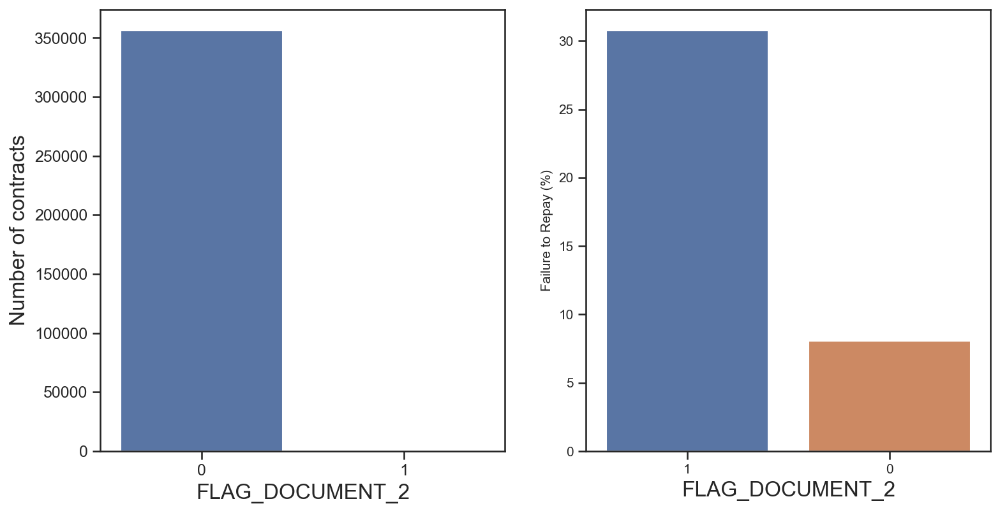

For FLAG_DOCUMENT_3
Percent of missing values: 0.0
Correlation_coefficient with target: 0.04434634685114483


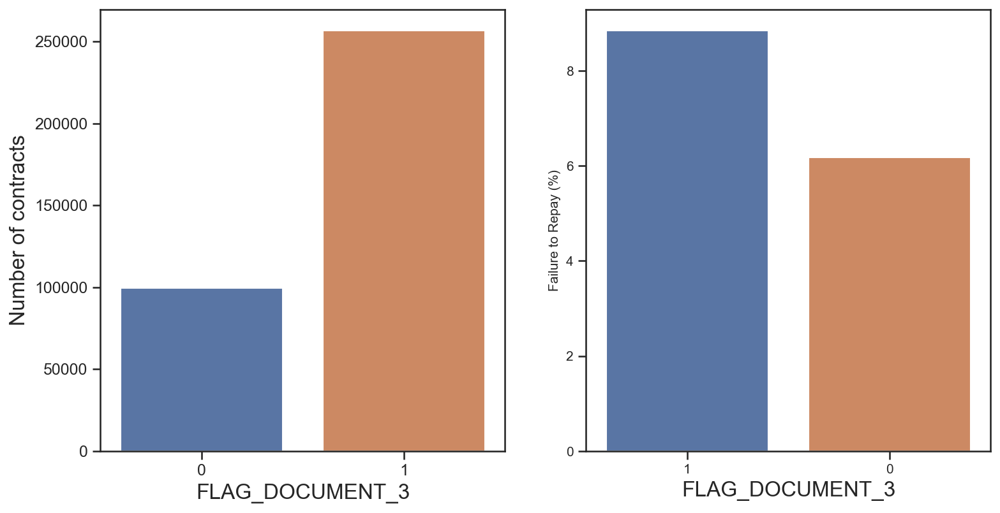

For FLAG_DOCUMENT_4
Percent of missing values: 0.0
Correlation_coefficient with target: -0.0026720821701620616


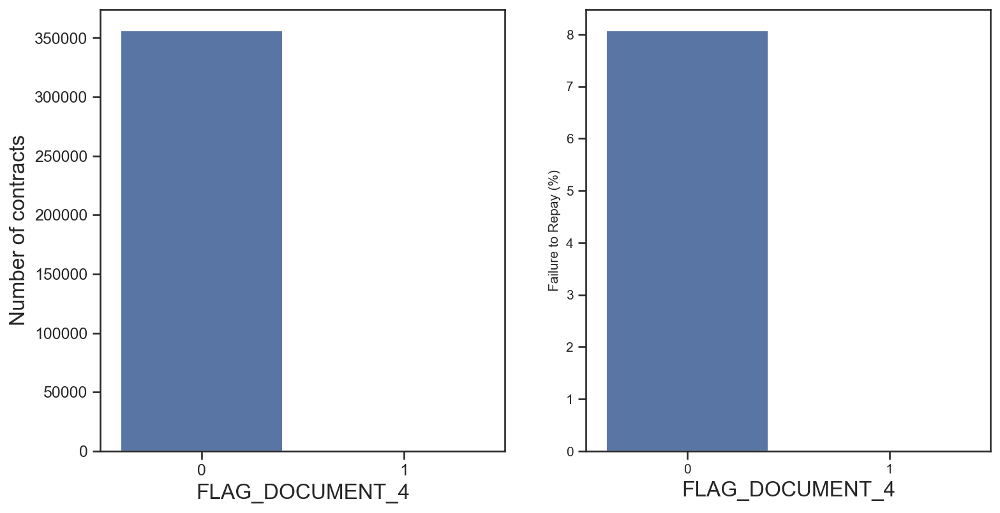

For FLAG_DOCUMENT_5
Percent of missing values: 0.0
Correlation_coefficient with target: -0.000315777416646229


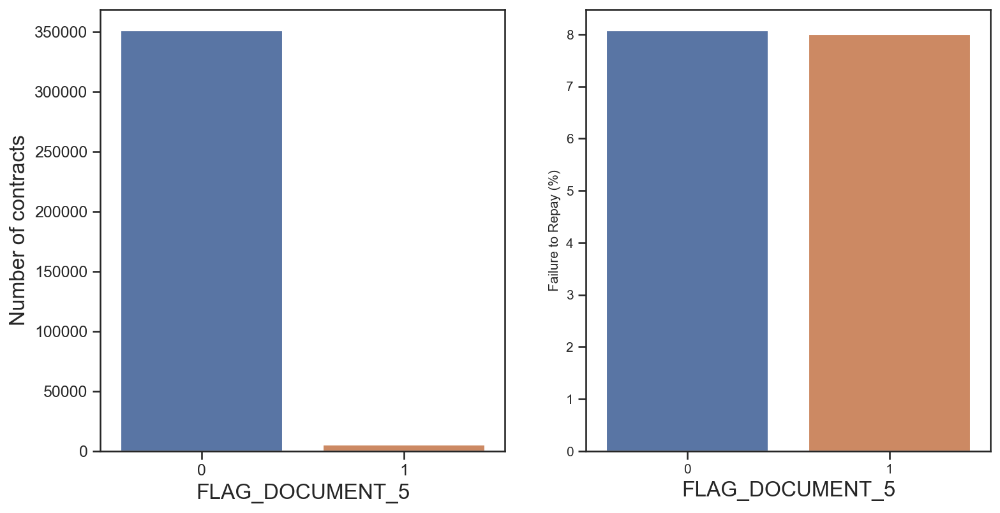

For FLAG_DOCUMENT_6
Percent of missing values: 0.0
Correlation_coefficient with target: -0.028601893973061232


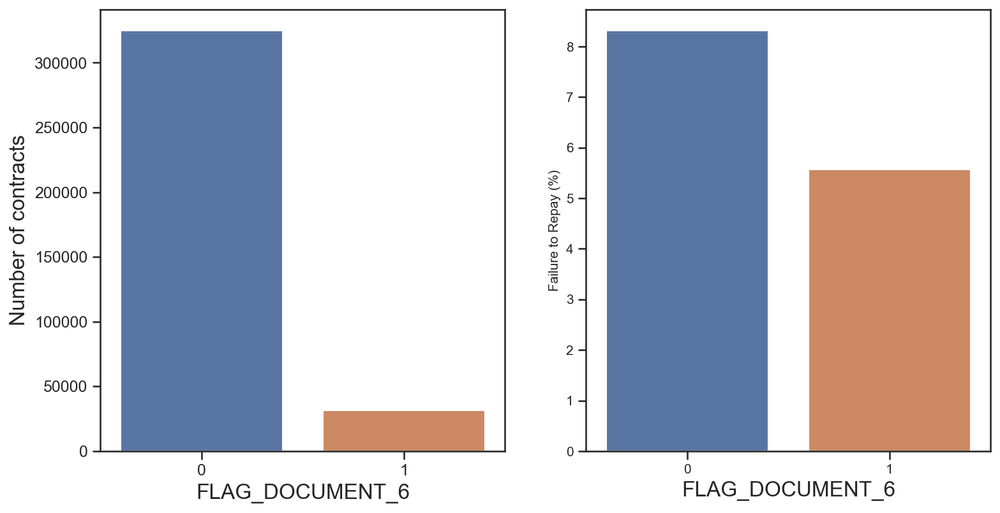

For FLAG_DOCUMENT_7
Percent of missing values: 0.0
Correlation_coefficient with target: -0.0015195031600878978


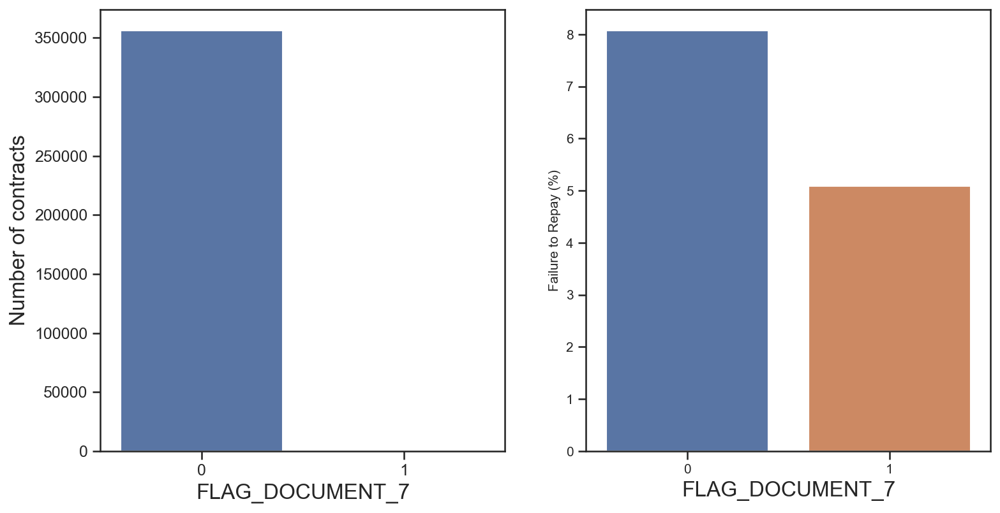

For FLAG_DOCUMENT_8
Percent of missing values: 0.0
Correlation_coefficient with target: -0.008040384466056628


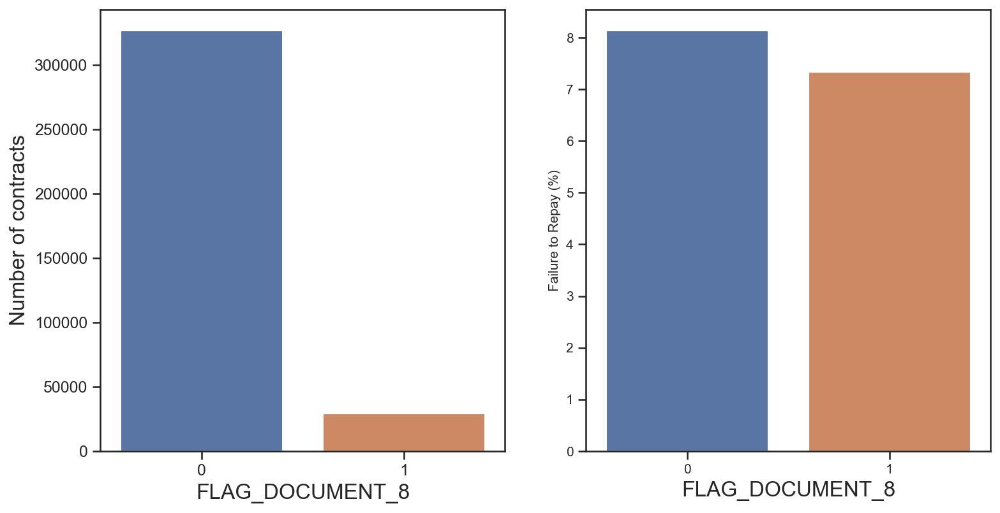

For FLAG_DOCUMENT_9
Percent of missing values: 0.0
Correlation_coefficient with target: -0.004352408580842186


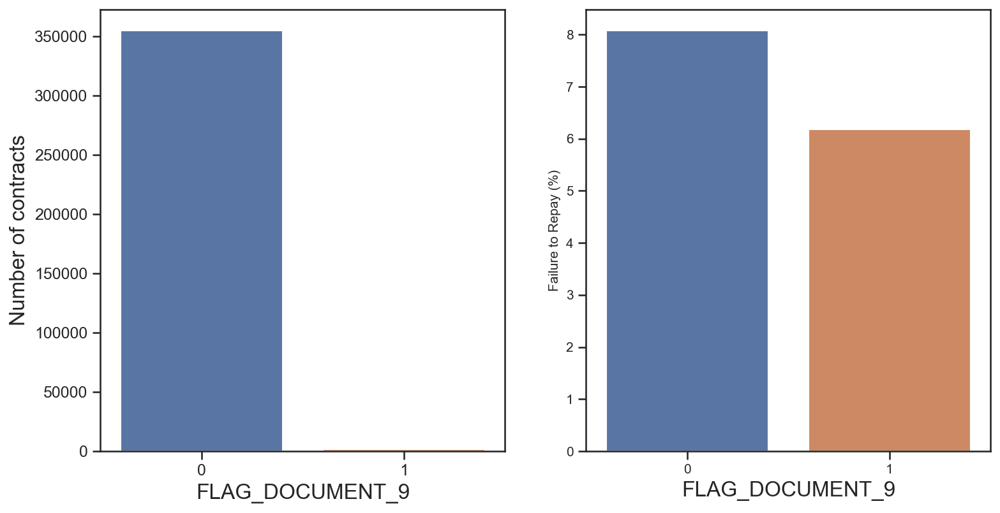

For FLAG_DOCUMENT_10
Percent of missing values: 0.0
Correlation_coefficient with target: -0.0014138915975241157


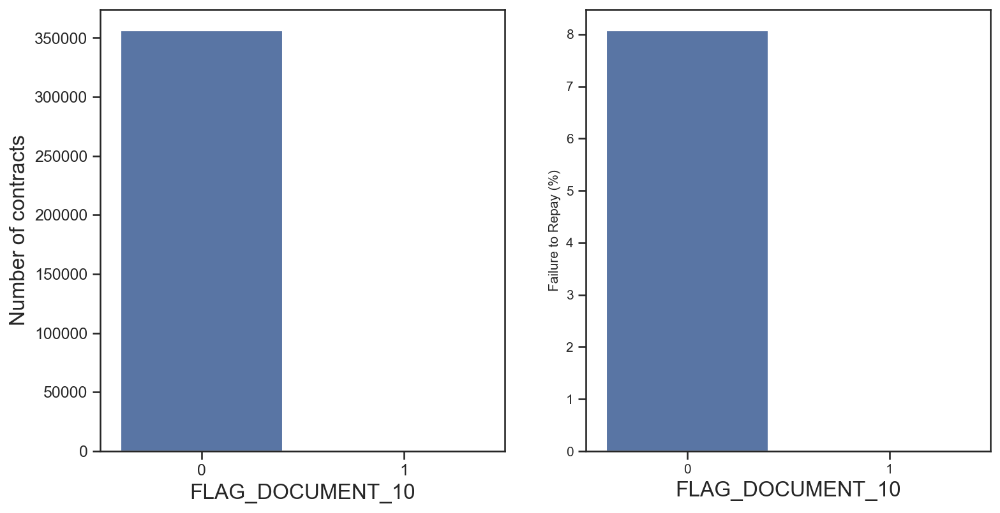

For FLAG_DOCUMENT_11
Percent of missing values: 0.0
Correlation_coefficient with target: -0.004229349652160109


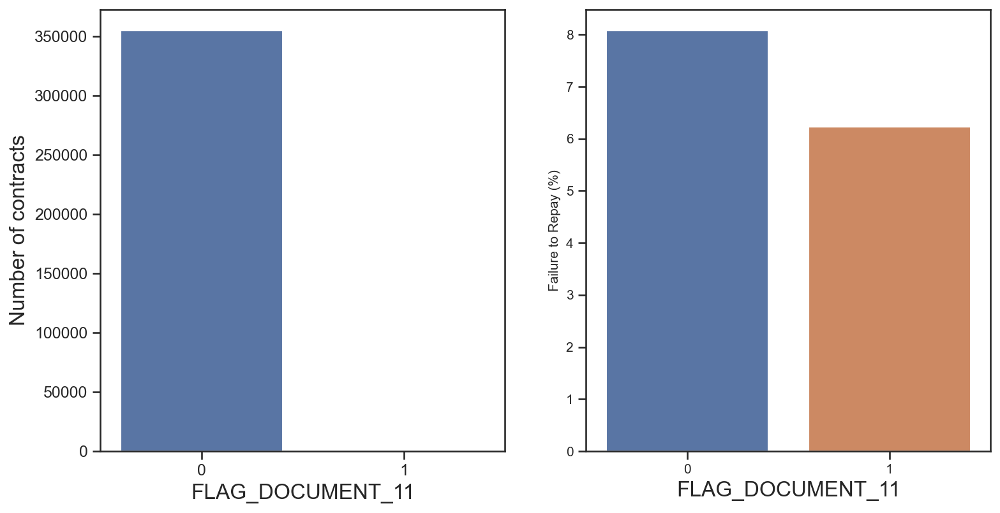

For FLAG_DOCUMENT_12
Percent of missing values: 0.0
Correlation_coefficient with target: -0.0007557507043578934


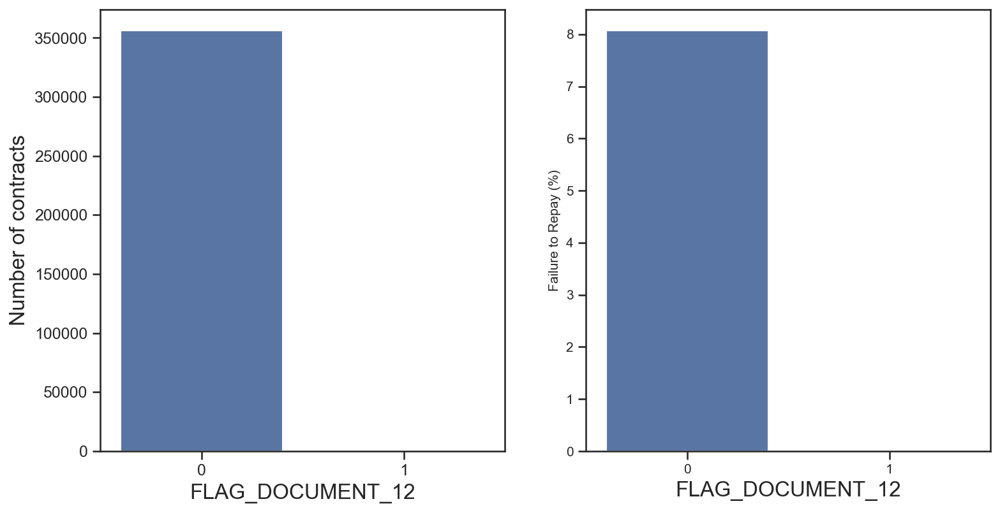

For FLAG_DOCUMENT_13
Percent of missing values: 0.0
Correlation_coefficient with target: -0.011583222341419458


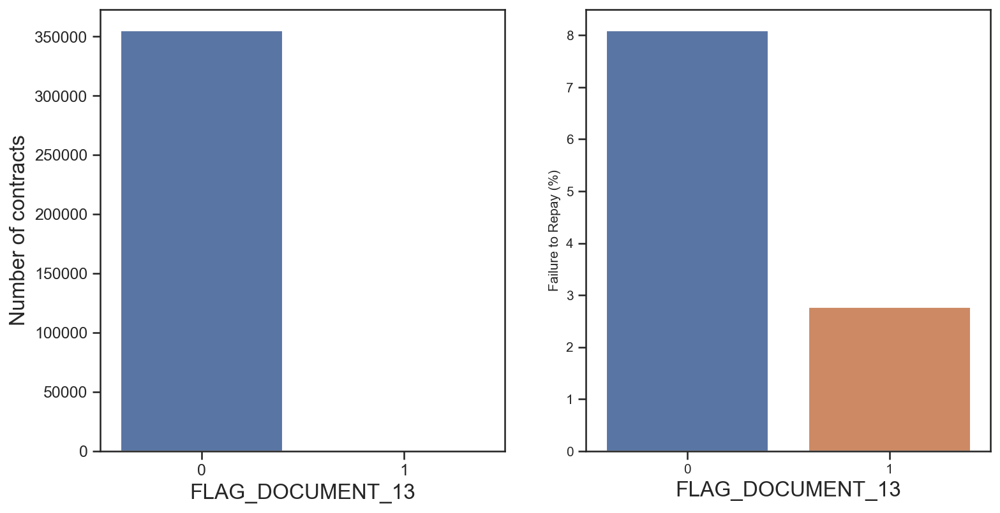

For FLAG_DOCUMENT_14
Percent of missing values: 0.0
Correlation_coefficient with target: -0.009463821935576967


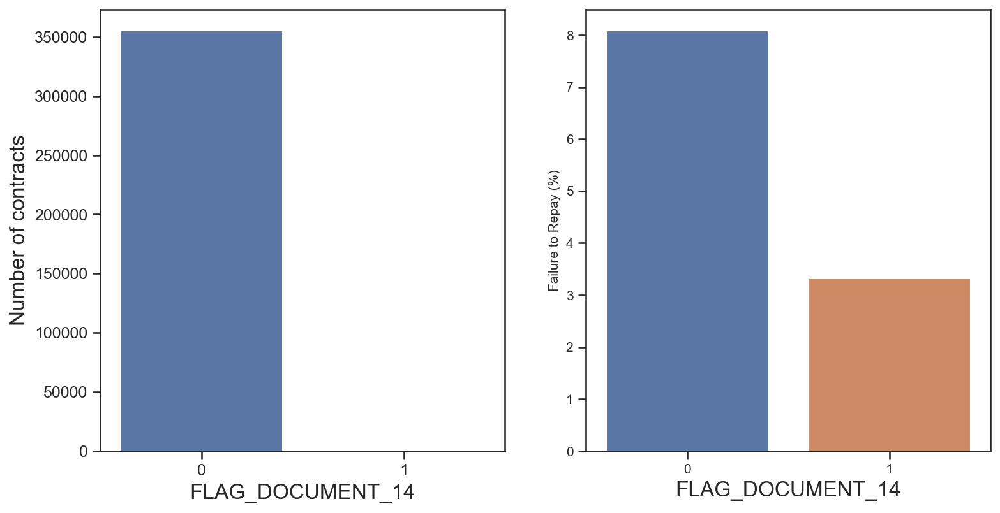

For FLAG_DOCUMENT_15
Percent of missing values: 0.0
Correlation_coefficient with target: -0.0065356575840949775


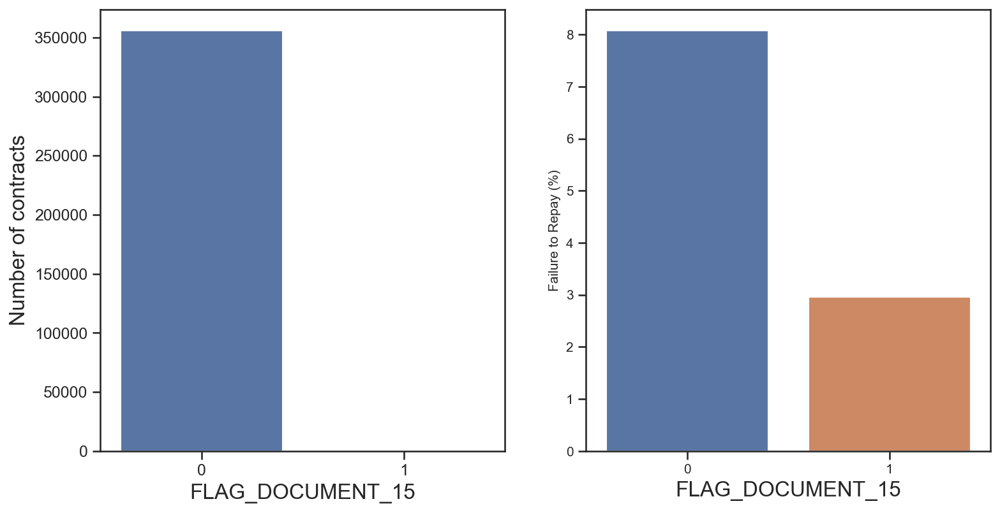

For FLAG_DOCUMENT_16
Percent of missing values: 0.0
Correlation_coefficient with target: -0.011614671588293528


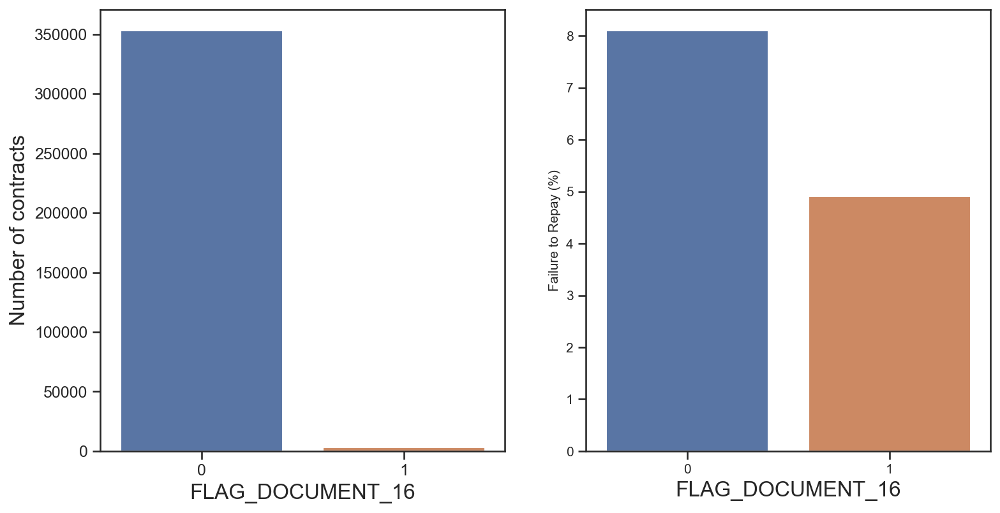

For FLAG_DOCUMENT_17
Percent of missing values: 0.0
Correlation_coefficient with target: -0.0033775691474138875


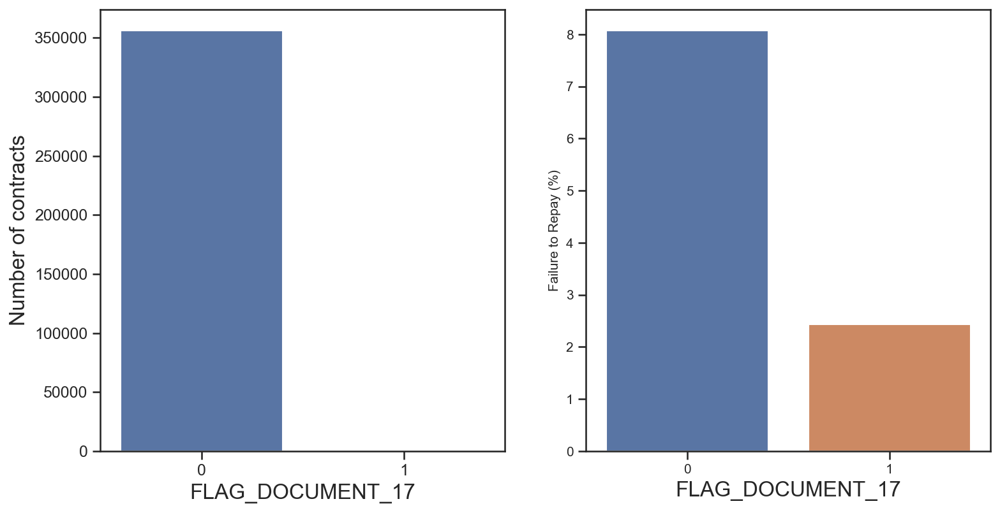

For FLAG_DOCUMENT_18
Percent of missing values: 0.0
Correlation_coefficient with target: -0.007952385099462464


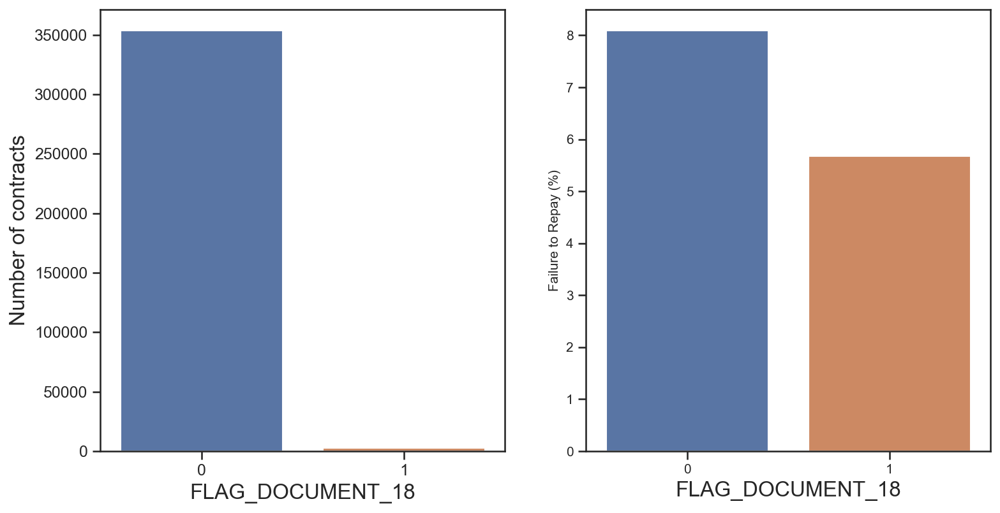

For FLAG_DOCUMENT_19
Percent of missing values: 0.0
Correlation_coefficient with target: -0.0013575183243008384


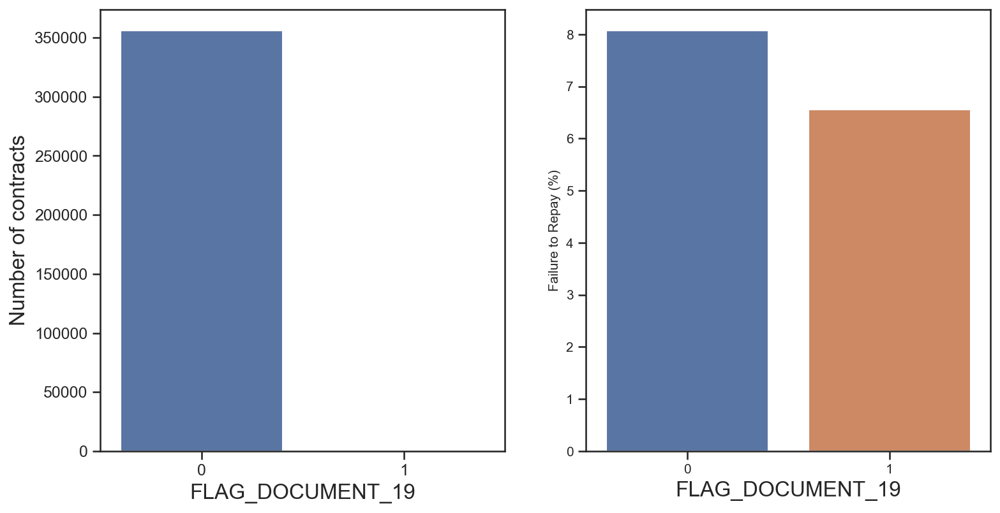

For FLAG_DOCUMENT_20
Percent of missing values: 0.0
Correlation_coefficient with target: 0.00021539355797720446


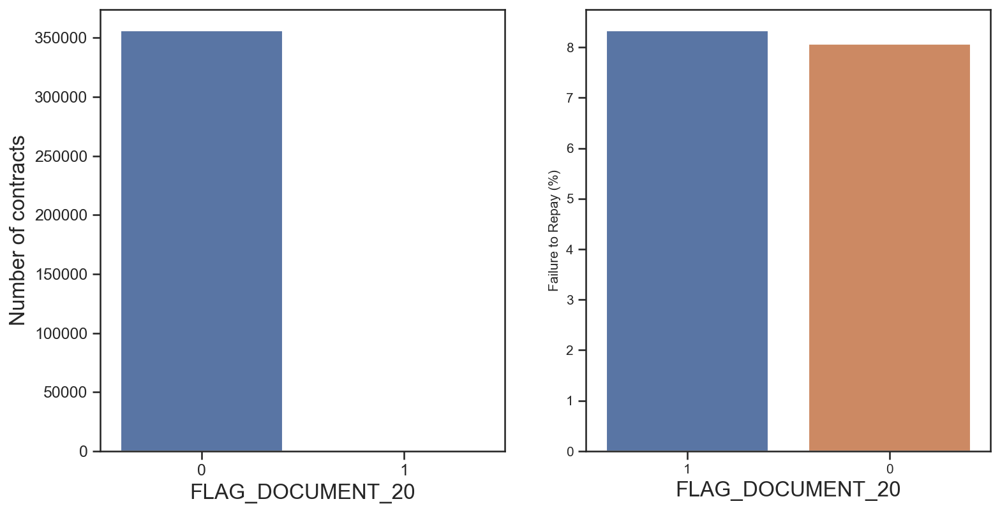

For FLAG_DOCUMENT_21
Percent of missing values: 0.0
Correlation_coefficient with target: 0.0037086250293065426


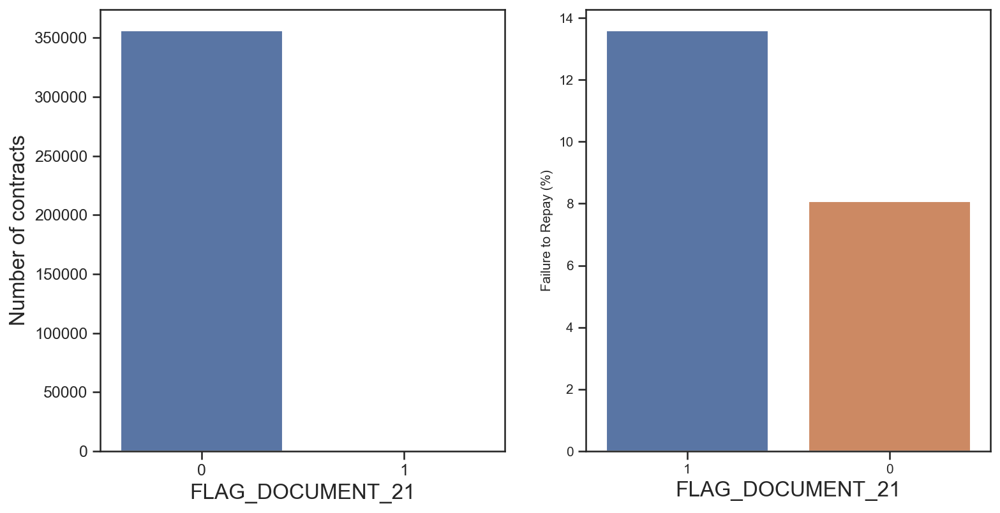

In [78]:
flag_doc_variables = ["FLAG_DOCUMENT_2",
                      "FLAG_DOCUMENT_3",
                      "FLAG_DOCUMENT_4",
                      "FLAG_DOCUMENT_5",
                      "FLAG_DOCUMENT_6",
                      "FLAG_DOCUMENT_7",
                      "FLAG_DOCUMENT_8",
                      "FLAG_DOCUMENT_9",
                      "FLAG_DOCUMENT_10",
                      "FLAG_DOCUMENT_11",
                      "FLAG_DOCUMENT_12",
                      "FLAG_DOCUMENT_13",
                      "FLAG_DOCUMENT_14",
                      "FLAG_DOCUMENT_15",
                      "FLAG_DOCUMENT_16",
                      "FLAG_DOCUMENT_17",
                      "FLAG_DOCUMENT_18",
                      "FLAG_DOCUMENT_19",
                      "FLAG_DOCUMENT_20",
                      "FLAG_DOCUMENT_21"]

for var in flag_doc_variables:
    # Know the proportion of missing values
    print("For", var)
    print("Percent of missing values:", missing_data_var(df_app, var))
    corr_coeff = df_app["TARGET"].corr(df_app[var])
    print("Correlation_coefficient with target:", corr_coeff)
    hist_distrib_cat(df_app, var)

**Variables about AMT_REQ_CREDIT_BUREAU**

For AMT_REQ_CREDIT_BUREAU_HOUR
Percent of missing values: 13.352271132394304
Correlation_coefficient with target: 0.0009304246096947507


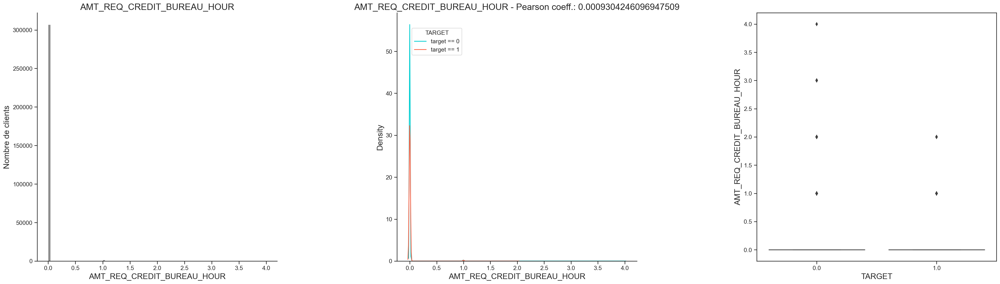

For AMT_REQ_CREDIT_BUREAU_DAY
Percent of missing values: 13.352271132394304
Correlation_coefficient with target: 0.0027044013780416834


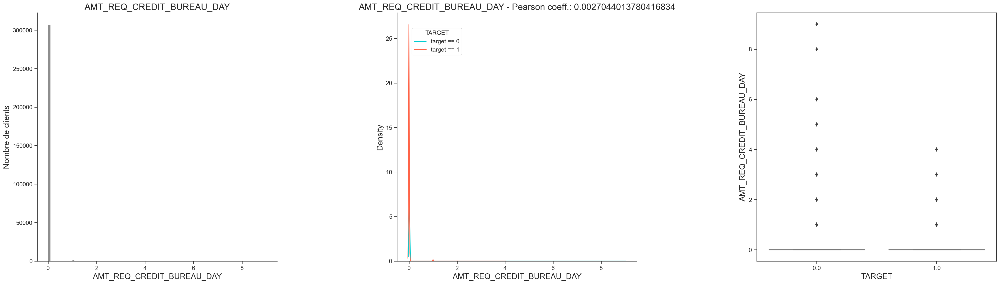

For AMT_REQ_CREDIT_BUREAU_WEEK
Percent of missing values: 13.352271132394304
Correlation_coefficient with target: 0.0007877117489034495


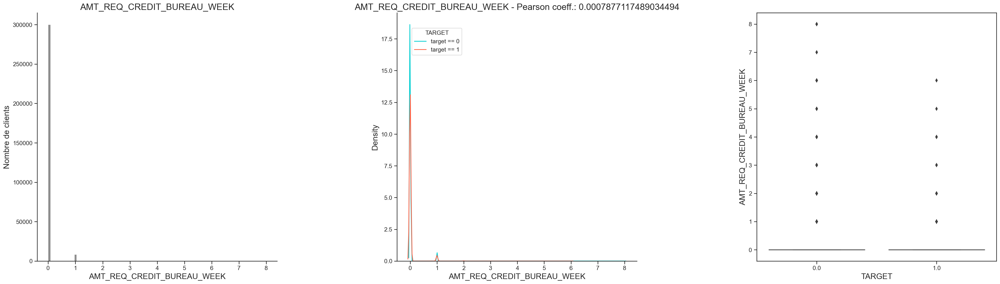

For AMT_REQ_CREDIT_BUREAU_MON
Percent of missing values: 13.352271132394304
Correlation_coefficient with target: -0.01246241922813866


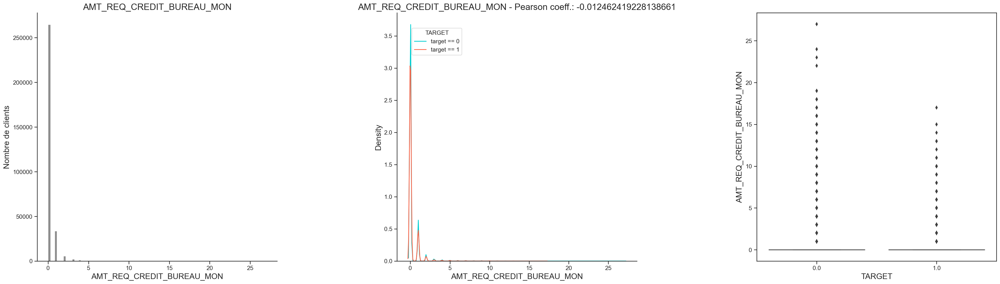

For AMT_REQ_CREDIT_BUREAU_QRT
Percent of missing values: 13.352271132394304
Correlation_coefficient with target: -0.0020219274353456473


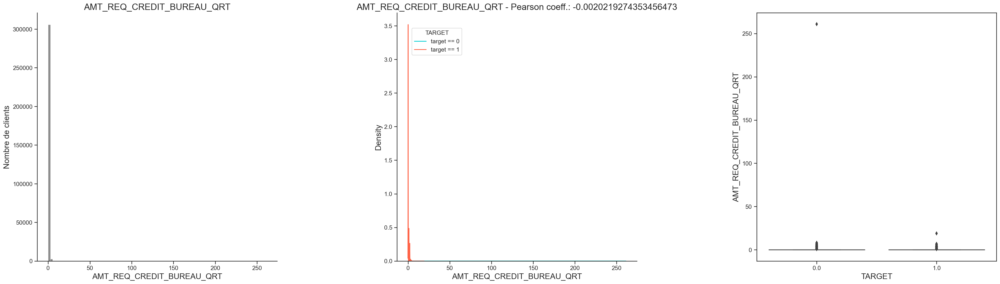

For AMT_REQ_CREDIT_BUREAU_YEAR
Percent of missing values: 13.352271132394304
Correlation_coefficient with target: 0.019929858569466705


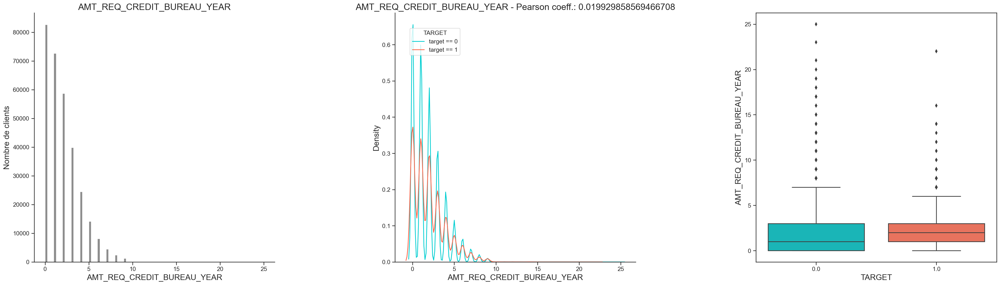

In [79]:
amt_req_variables = ["AMT_REQ_CREDIT_BUREAU_HOUR",
                     "AMT_REQ_CREDIT_BUREAU_DAY",
                     "AMT_REQ_CREDIT_BUREAU_WEEK",
                     "AMT_REQ_CREDIT_BUREAU_MON",
                     "AMT_REQ_CREDIT_BUREAU_QRT",
                     "AMT_REQ_CREDIT_BUREAU_YEAR"]

for var in amt_req_variables:
    # Know the proportion of missing values
    print("For", var)
    print("Percent of missing values:", missing_data_var(df_app, var))
    corr_coeff = df_app["TARGET"].corr(df_app[var])
    print("Correlation_coefficient with target:", corr_coeff)
    hist_distrib_target(df_app, var)

**Variable "HOUR_APPR_PROCESS_START"**

In [80]:
# Know the proportion of missing values
print("Percent of missing values:", missing_data_var(df_app,
                                                     "HOUR_APPR_PROCESS_START"))

Percent of missing values: 0.0


In [81]:
# Get the descriptive statistics
df_app["HOUR_APPR_PROCESS_START"].describe()

count    356254.000000
mean         12.055752
std           3.267580
min           0.000000
25%          10.000000
50%          12.000000
75%          14.000000
max          23.000000
Name: HOUR_APPR_PROCESS_START, dtype: float64

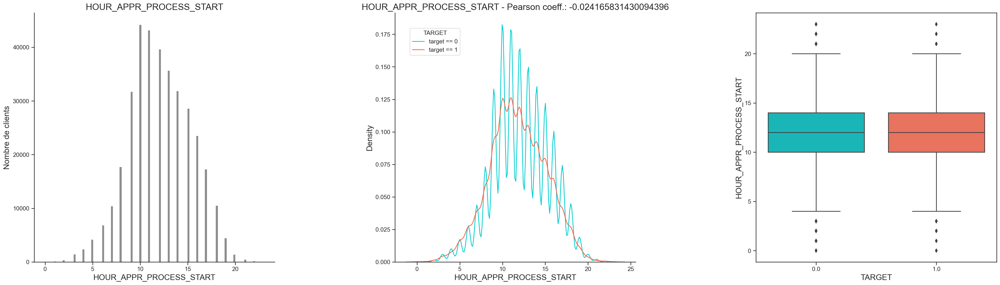

In [82]:
# Plot the distribution histogram
hist_distrib_target(df_app, "HOUR_APPR_PROCESS_START")

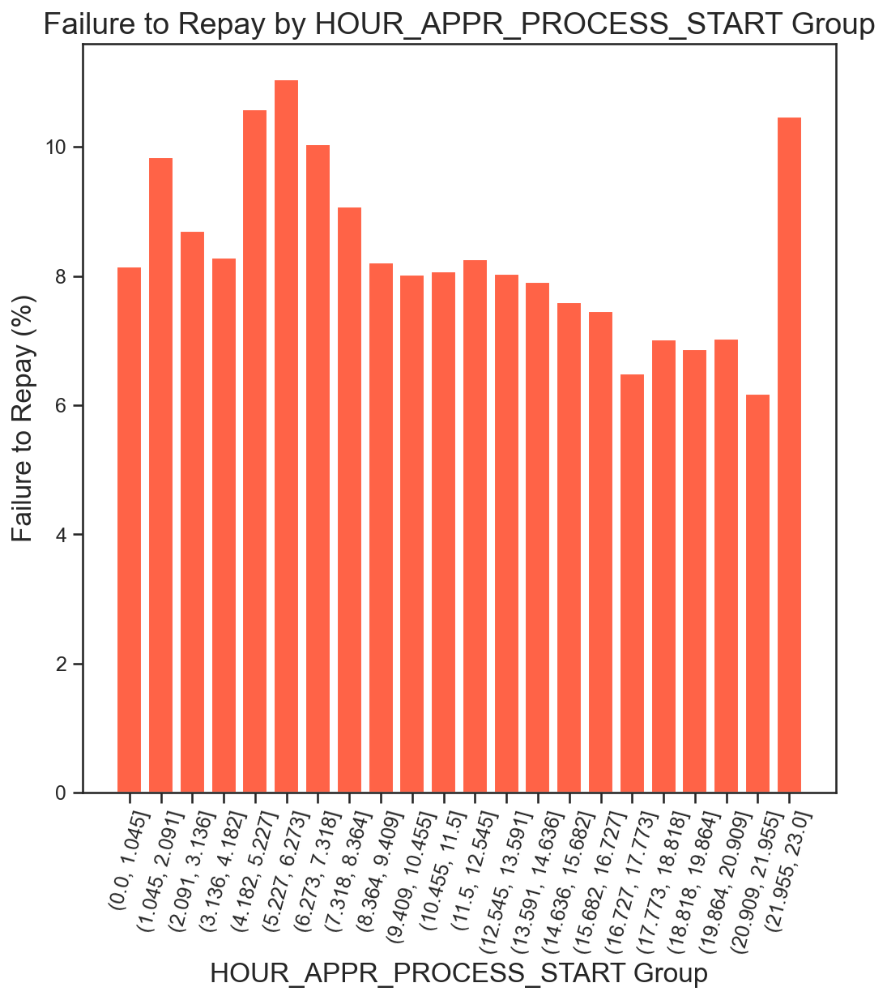

In [83]:
# Make a copy of the dataframe
df_phone = df_app[["TARGET", "HOUR_APPR_PROCESS_START"]]

failure_to_repay_graph(df_phone,
                       variable="HOUR_APPR_PROCESS_START",
                       bins=np.linspace(0, 23, num=23))

<code style="background:lightyellow;color:black">Back to <a href="#C0">Table of contents</a></code>

#### <div class="alert alert-block alert-info"><a name="C2133">2.1.3.3 Categorical variables</a></div>


In [84]:
# Get the number of categories for each variables
df_app.select_dtypes('object').apply(pd.Series.nunique, axis=0)

NAME_CONTRACT_TYPE             2
CODE_GENDER                    3
FLAG_OWN_CAR                   2
FLAG_OWN_REALTY                2
NAME_TYPE_SUITE                7
NAME_INCOME_TYPE               8
NAME_EDUCATION_TYPE            5
NAME_FAMILY_STATUS             6
NAME_HOUSING_TYPE              6
OCCUPATION_TYPE               18
WEEKDAY_APPR_PROCESS_START     7
ORGANIZATION_TYPE             58
dtype: int64

**Variable "NAME_CONTRACT_TYPE"**

In [85]:
# Know the proportion of missing values
print("Percent of missing values:", missing_data_var(df_app,
                                                     "NAME_CONTRACT_TYPE"))

Percent of missing values: 0.0


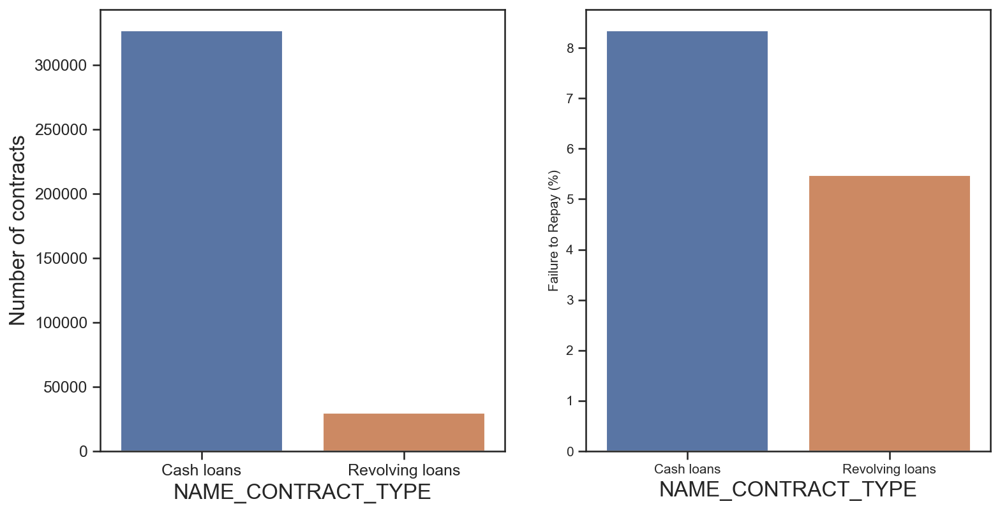

In [86]:
# Visualize the number of clients in each category
hist_distrib_cat(df_app, "NAME_CONTRACT_TYPE")

Contract type Revolving loans are just a small fraction (10%) from the total number of loans. In the same time, a larger amount of Revolving loans, comparing with their frequency, are not repaid.

**Variable "CODE_GENDER"**

In [87]:
# Know the proportion of missing values
print("Percent of missing values:", missing_data_var(df_app,
                                                     "CODE_GENDER"))

Percent of missing values: 0.0


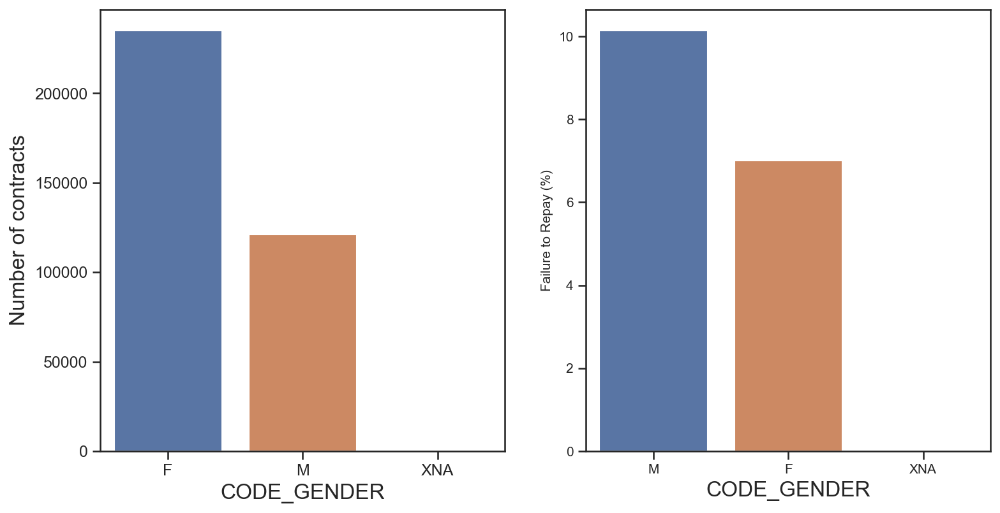

In [88]:
# Visualize the number of clients in each category
hist_distrib_cat(df_app, "CODE_GENDER")

What is XNA gender? How many client this category represents?

In [89]:
df_app["CODE_GENDER"].value_counts()

F      235125
M      121125
XNA         4
Name: CODE_GENDER, dtype: int64

In [90]:
# Drop client with XNA code gender
index_to_drop = df_app.index[df_app["CODE_GENDER"] == "XNA"]
df_app.drop(index=index_to_drop, axis=0, inplace=True)

The number of female clients is almost double the number of male clients. Looking to the percent of defaulted credits, males have a higher chance of not returning their loans (~10%), comparing with women (~7%).

**Variable "FLAG_OWN_CAR"**

In [91]:
# Know the proportion of missing values
print("Percent of missing values:", missing_data_var(df_app,
                                                     "FLAG_OWN_CAR"))

Percent of missing values: 0.0


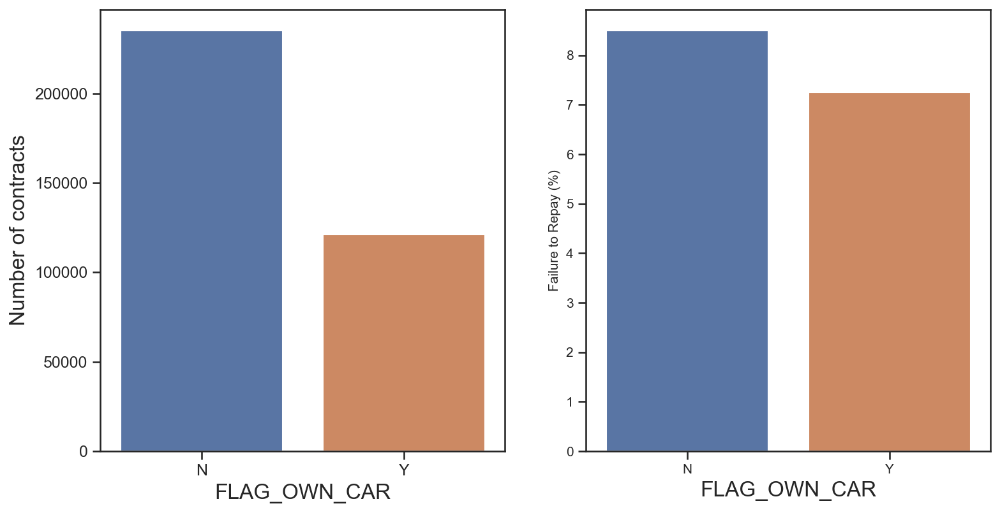

In [92]:
# Visualize the number of clients in each category
hist_distrib_cat(df_app, "FLAG_OWN_CAR")

The clients that owns a car are almost a half of the ones that doesn't own one. The clients that owns a car are less likely to not repay a car that the ones that own. Both categories have not-repayment rates around 8%.

**Variable "FLAG_OWN_REALTY"**

In [93]:
# Know the proportion of missing values
print("Percent of missing values:", missing_data_var(df_app,
                                                     "FLAG_OWN_REALTY"))

Percent of missing values: 0.0


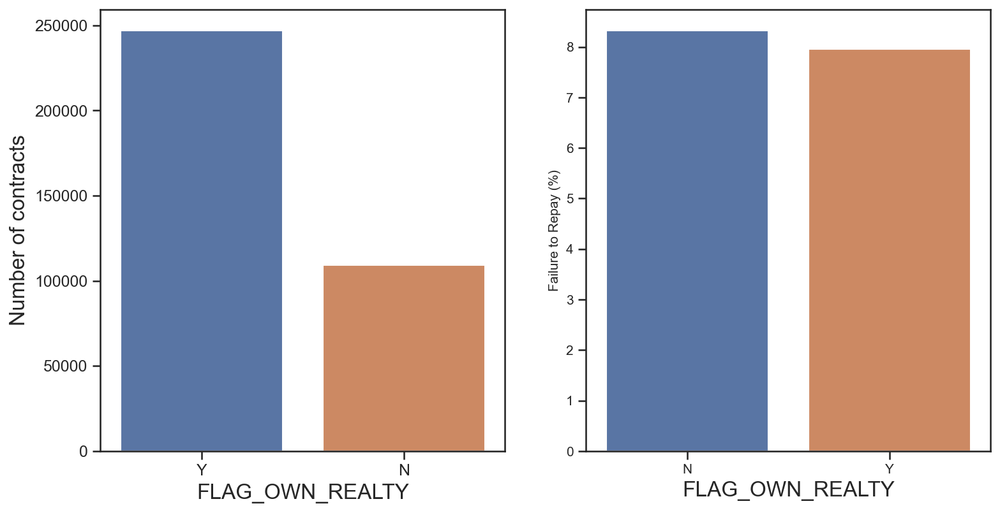

In [94]:
# Visualize the number of clients in each category
hist_distrib_cat(df_app, "FLAG_OWN_REALTY")

The clients that owns real estate are more than double of the ones that doesn't own. Both categories (owning real estate or not owning) have not-repayment rates less than 8%

**Variable "NAME_TYPE_SUITE"**

In [95]:
# Know the proportion of missing values
print("Percent of missing values:", missing_data_var(df_app,
                                                     "NAME_TYPE_SUITE"))

Percent of missing values: 0.6183859649122807


In [96]:
# Give the "Unknown" category for missing values
df_app["NAME_TYPE_SUITE"] = df_app["NAME_TYPE_SUITE"].fillna("Unknown")

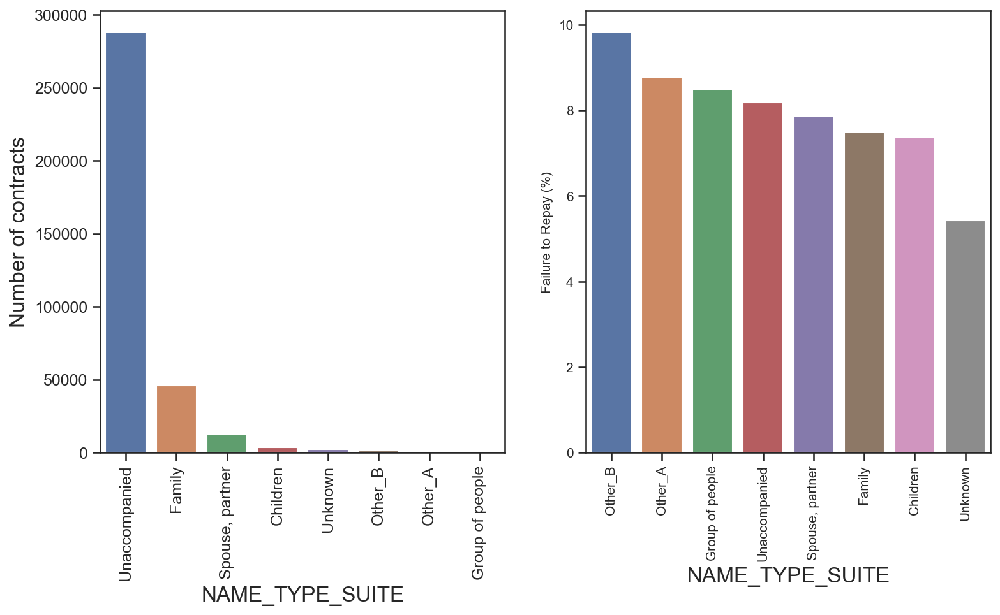

In [97]:
# Visualize the number of clients in each category
hist_distrib_cat(df_app,
                 "NAME_TYPE_SUITE",
                 label_rotation=True)

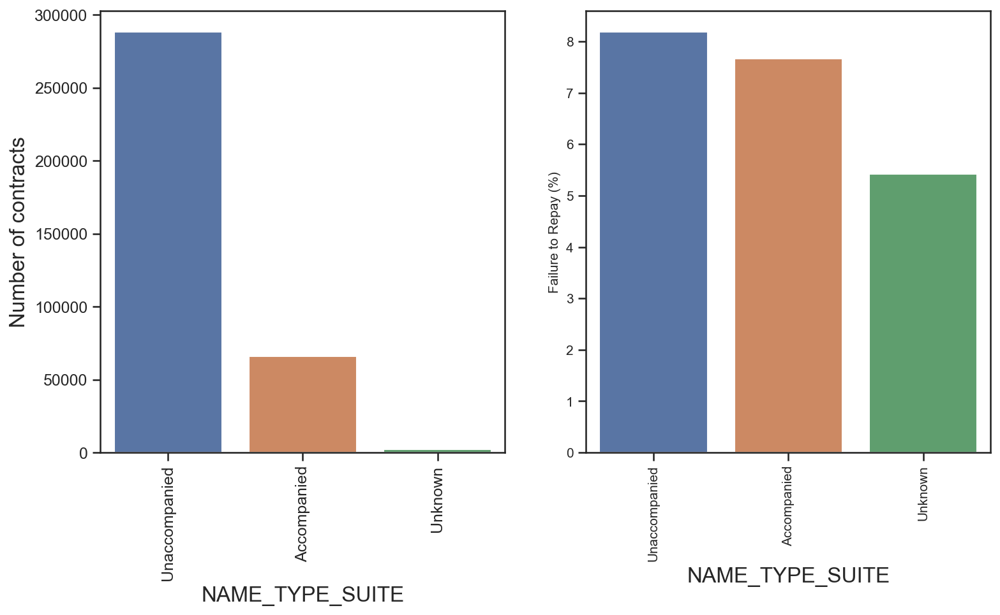

In [98]:
df_app = rename_cat_type_suite(df_app, "NAME_TYPE_SUITE")

# Visualize the number of clients in each category
hist_distrib_cat(df_app,
                 "NAME_TYPE_SUITE",
                 label_rotation=True)

**Variable "NAME_INCOME_TYPE"**

In [99]:
# Know the proportion of missing values
print("Percent of missing values:", missing_data_var(df_app,
                                                     "NAME_INCOME_TYPE"))

Percent of missing values: 0.0


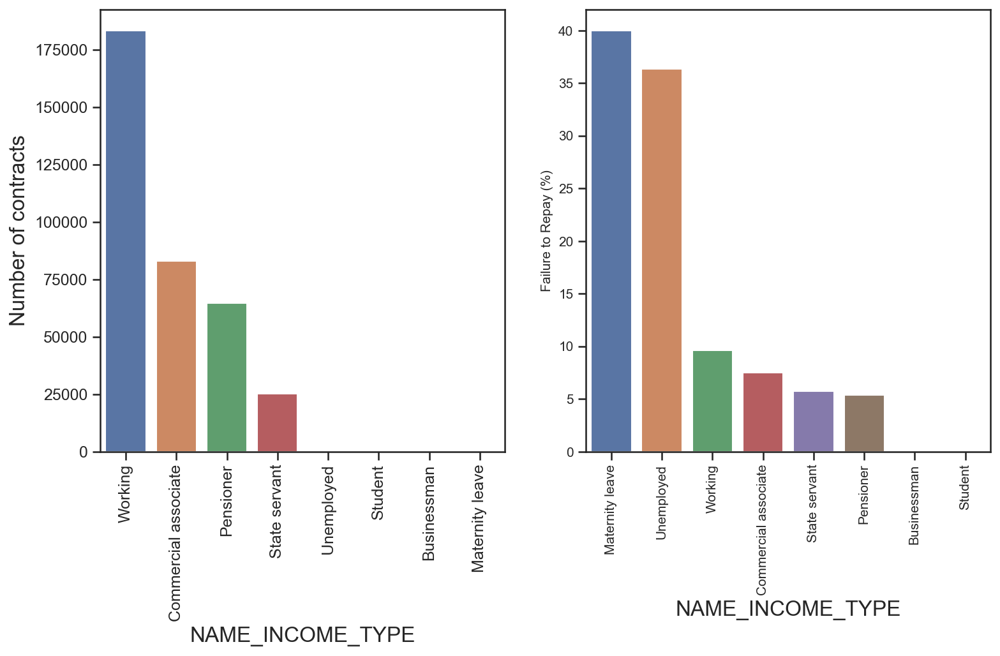

In [100]:
# Visualize the number of clients in each category
hist_distrib_cat(df_app,
                 "NAME_INCOME_TYPE",
                 label_rotation=True)

Most of applicants for loans are income from Working, followed by Commercial associate, Pensioner and State servant.

The applicants with the type of income Maternity leave have almost 40% ratio of not returning loans, followed by Unemployed (37%). The rest of types of incomes are under the average of 10% for not returning loans.

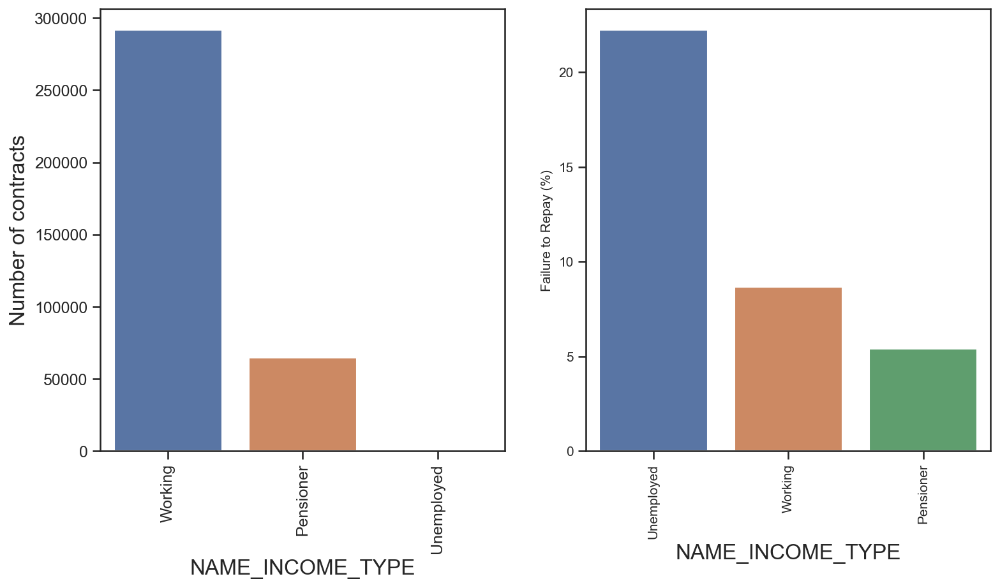

In [101]:
df_app = rename_cat_income_type(df_app, "NAME_INCOME_TYPE")
# Visualize the number of clients in each category
hist_distrib_cat(df_app,
                 "NAME_INCOME_TYPE",
                 label_rotation=True)

**Variable "NAME_EDUCATION_TYPE"**

In [102]:
# Know the proportion of missing values
print("Percent of missing values:", missing_data_var(df_app,
                                                     "NAME_EDUCATION_TYPE"))

Percent of missing values: 0.0


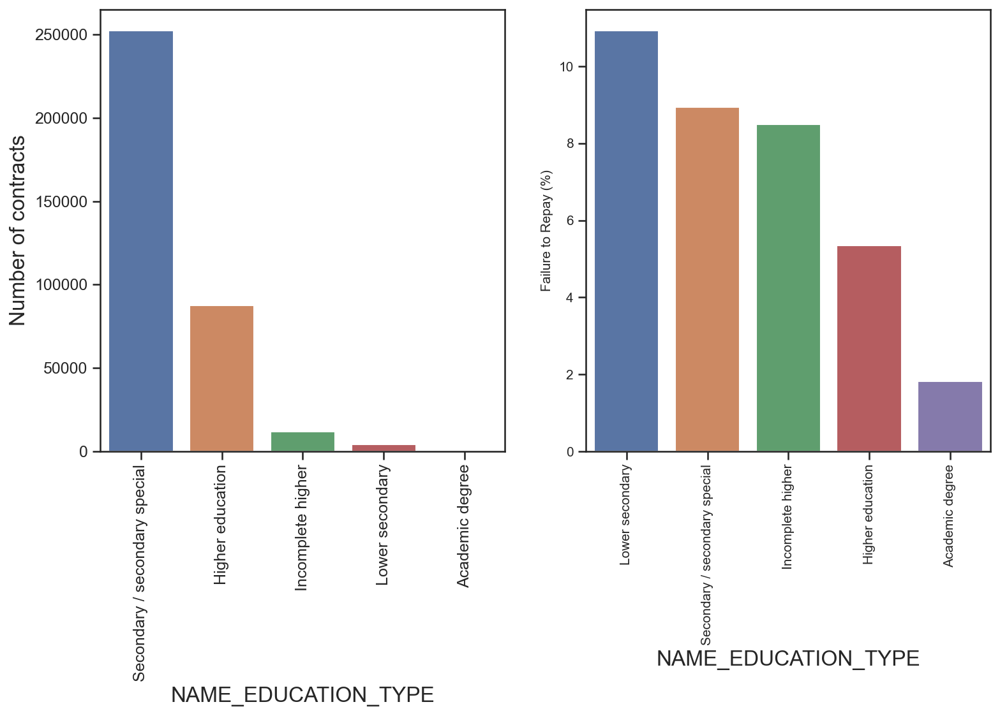

In [103]:
# Visualize the number of clients in each category
hist_distrib_cat(df_app, "NAME_EDUCATION_TYPE", label_rotation=True)

Majority of the clients have Secondary / secondary special education, followed by clients with Higher education. Only a very small number having an academic degree.

The Lower secondary category, although rare, have the largest rate of not returning the loan (11%). The people with Academic degree have less than 2% not-repayment rate

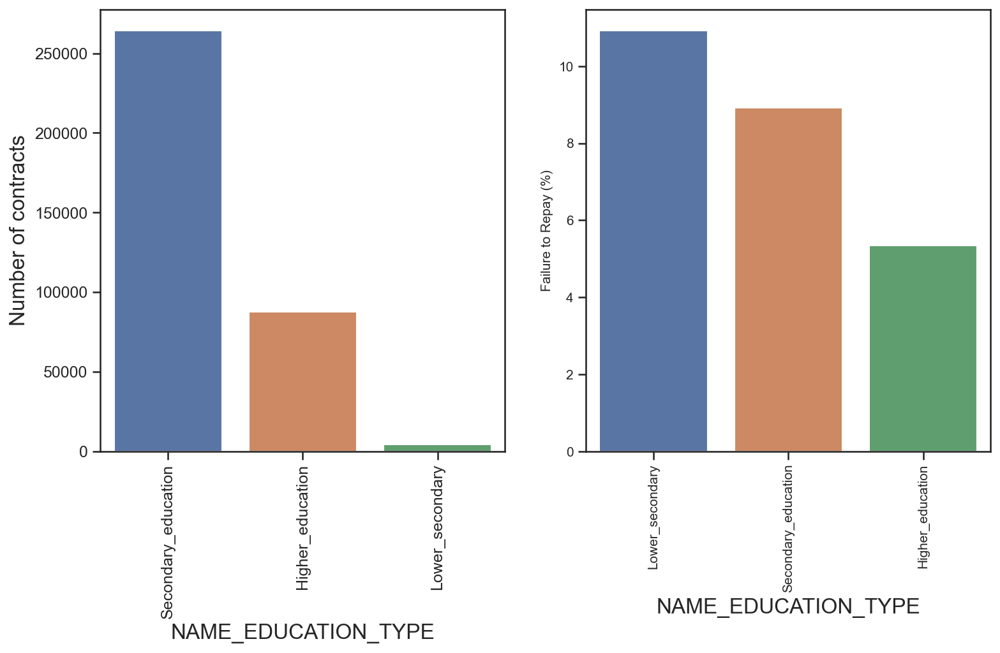

In [104]:
# Rename categories
df_app = rename_cat_education_type(df_app)
# Visualize the number of clients in each category
hist_distrib_cat(df_app,
                 "NAME_EDUCATION_TYPE",
                 label_rotation=True)

**Variable "NAME_FAMILY_STATUS"**

In [105]:
# Know the proportion of missing values
print("Percent of missing values:", missing_data_var(df_app,
                                                     "NAME_FAMILY_STATUS"))

Percent of missing values: 0.0


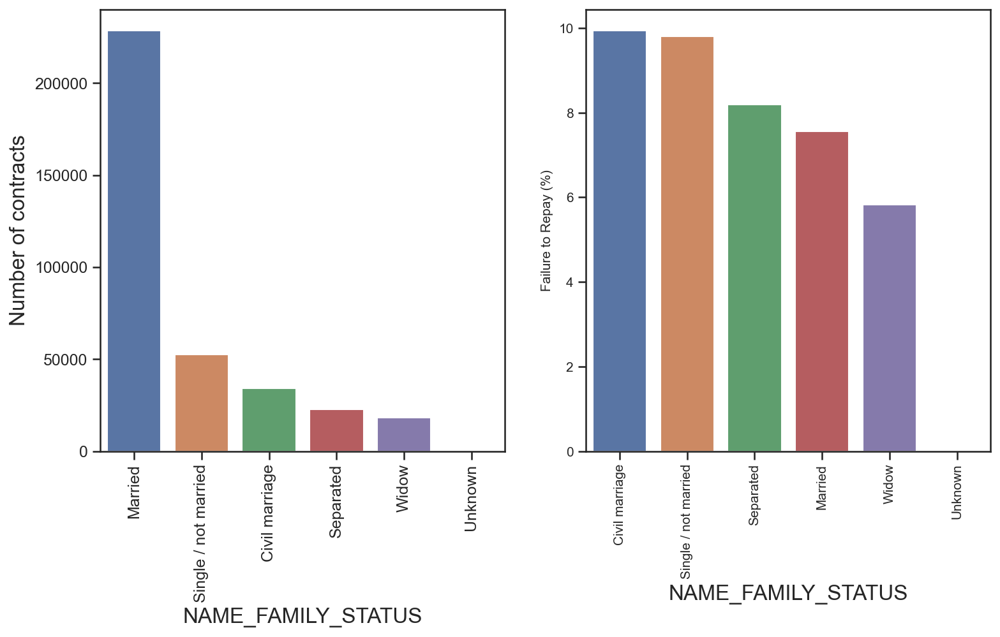

In [106]:
# Visualize the number of clients in each category
hist_distrib_cat(df_app,
                 "NAME_FAMILY_STATUS",
                 label_rotation=True,
                 horizontal_layout=True)

Most of clients are married, followed by Single/not married and civil marriage.

In terms of percentage of not repayment of loan, Civil marriage has the highest percent of not repayment (10%), with Widow the lowest (exception being Unknown).

In [107]:
unknown = df_app.loc[df_app["NAME_FAMILY_STATUS"] == "Unknown"]
unknown

,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,...,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR,Test,YEARS_BIRTH
41982,148605,0.0,Revolving loans,M,N,Y,0,450000.0,675000.0,33750.0,...,0,0,NaN,NaN,NaN,NaN,NaN,NaN,False,33.961644
187348,317181,0.0,Revolving loans,F,N,Y,0,202500.0,585000.0,29250.0,...,0,0,0.0,0.0,0.0,0.0,0.0,1.0,False,35.189041


In [108]:
df_app.drop(index=unknown.index, axis=0, inplace=True)

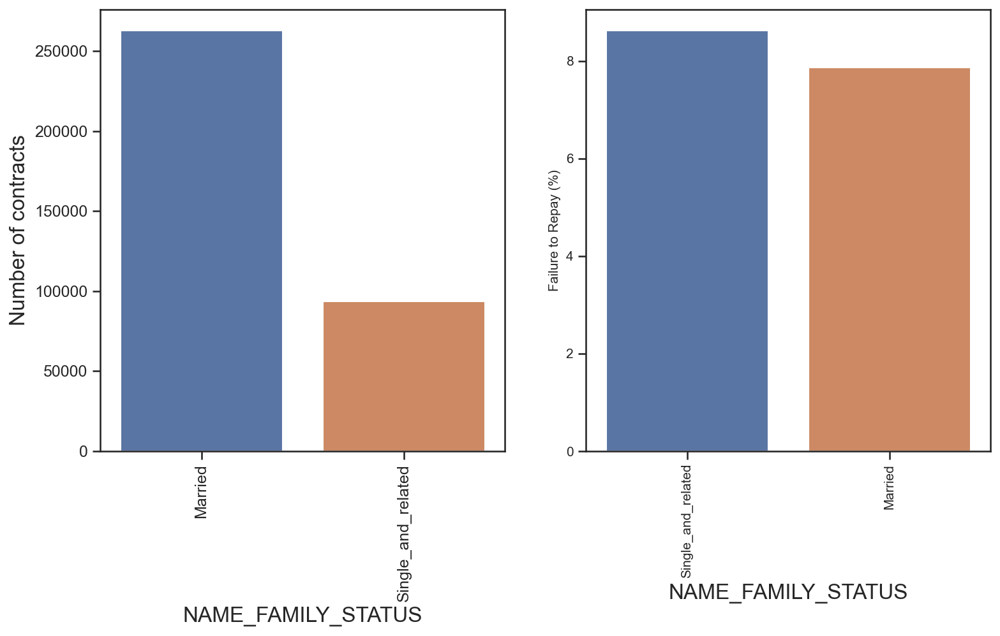

In [109]:
# Rename categories
df_app = rename_cat_family_status(df_app, "NAME_FAMILY_STATUS")
# Visualize the number of clients in each category
hist_distrib_cat(df_app,
                 "NAME_FAMILY_STATUS",
                 label_rotation=True)

**Variable "NAME_HOUSING TYPE"**

In [110]:
# Know the proportion of missing values
print("Percent of missing values:", missing_data_var(df_app,
                                                     "NAME_HOUSING_TYPE"))

Percent of missing values: 0.0


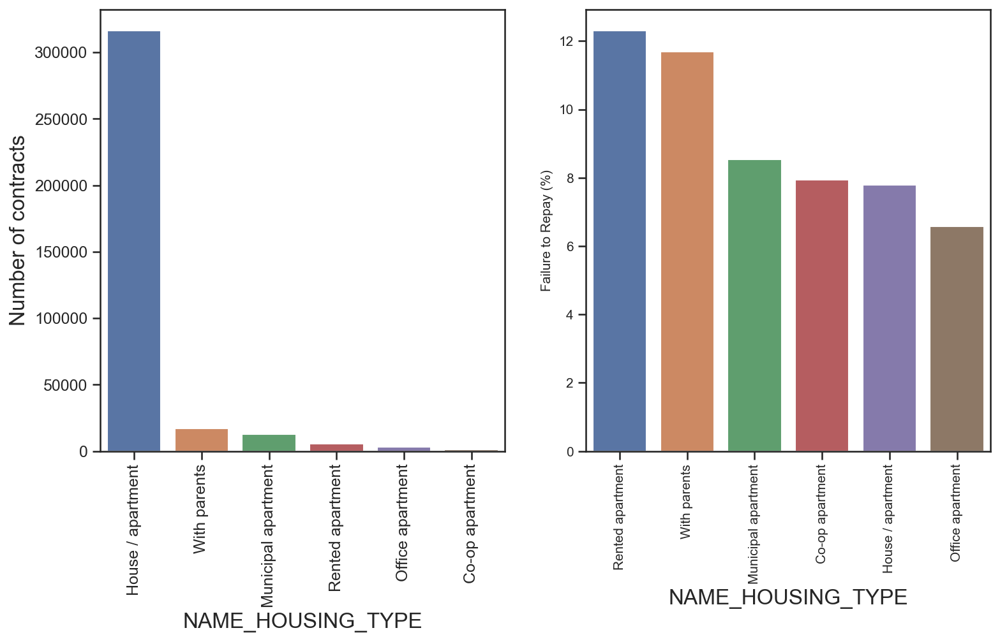

In [111]:
# Visualize the number of clients in each category
hist_distrib_cat(df_app, "NAME_HOUSING_TYPE", label_rotation=True)

Over 250,000 applicants for credits registered their housing as House/apartment. Following categories have a very small number of clients (With parents, Municipal appartment).

From these categories, Rented apartment and With parents have higher than 10% not-repayment rate.

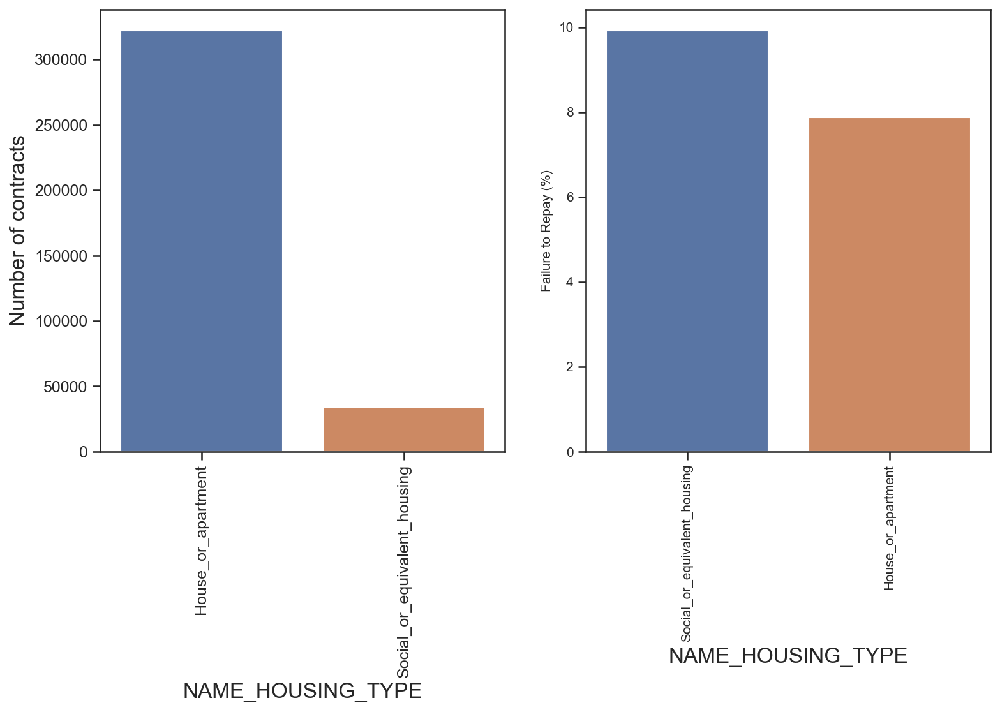

In [112]:
# Rename categories
df_app = rename_cat_housing_type(df_app)
# Visualize the number of clients in each category
hist_distrib_cat(df_app,
                 "NAME_HOUSING_TYPE",
                 label_rotation=True)

**Variable "ORGANIZATION_TYPE"**

In [113]:
# Know the proportion of missing values
print("Percent of missing values:", missing_data_var(df_app,
                                                     "ORGANIZATION_TYPE"))

Percent of missing values: 0.0


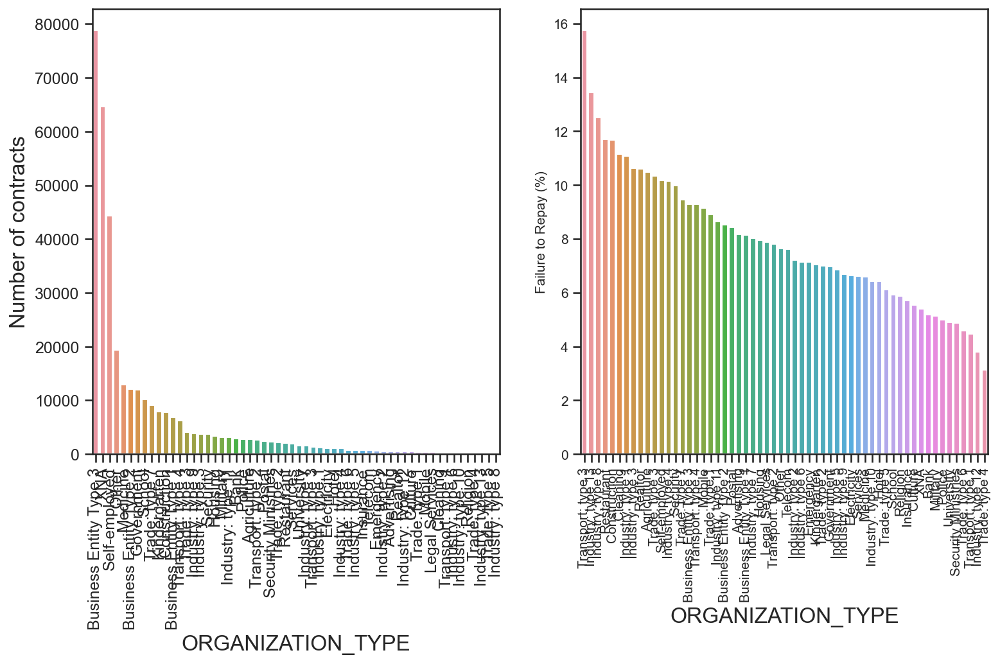

In [114]:
# Visualize the number of clients in each category
hist_distrib_cat(df_app, "ORGANIZATION_TYPE", label_rotation=True)

Organizations with highest percent of loans not repaid are Transport: type 3 (16%), Industry: type 13 (13.5%), Industry: type 8 (12.5%) and Restaurant (less than 12%).

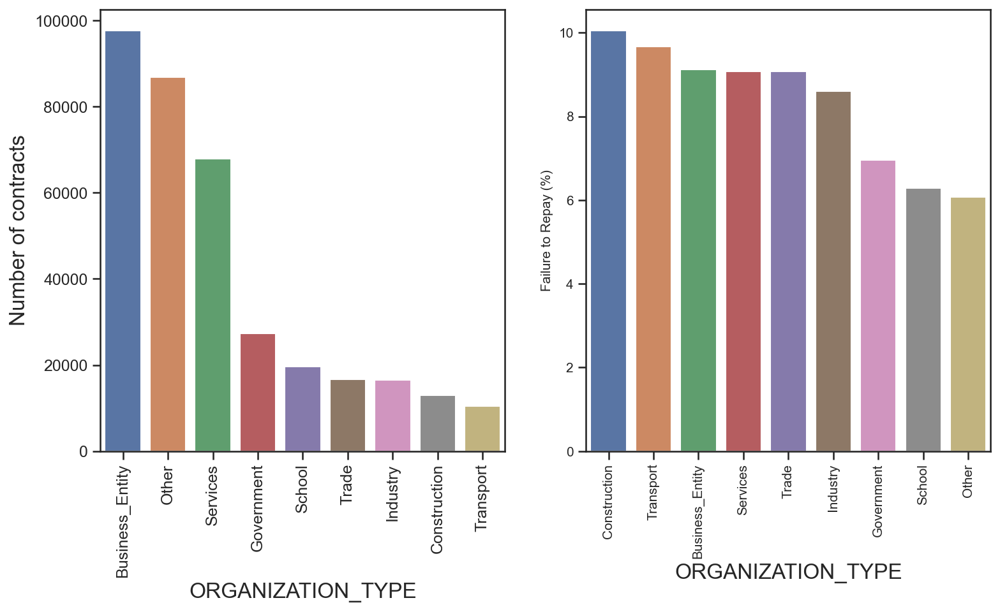

In [115]:
# Rename categories
df_app = rename_organization_type(df_app)
# Visualize the number of clients in each category
hist_distrib_cat(df_app,
                 "ORGANIZATION_TYPE",
                 label_rotation=True)

**Variable "OCCUPATION_TYPE"**

In [116]:
# Know the proportion of missing values
print("Percent of missing values:", missing_data_var(df_app,
                                                     "OCCUPATION_TYPE"))

Percent of missing values: 31.437088769621162


In [117]:
# Fill missing values with "Unknown"
df_app["OCCUPATION_TYPE"] = (df_app["OCCUPATION_TYPE"].fillna("Unknown"))

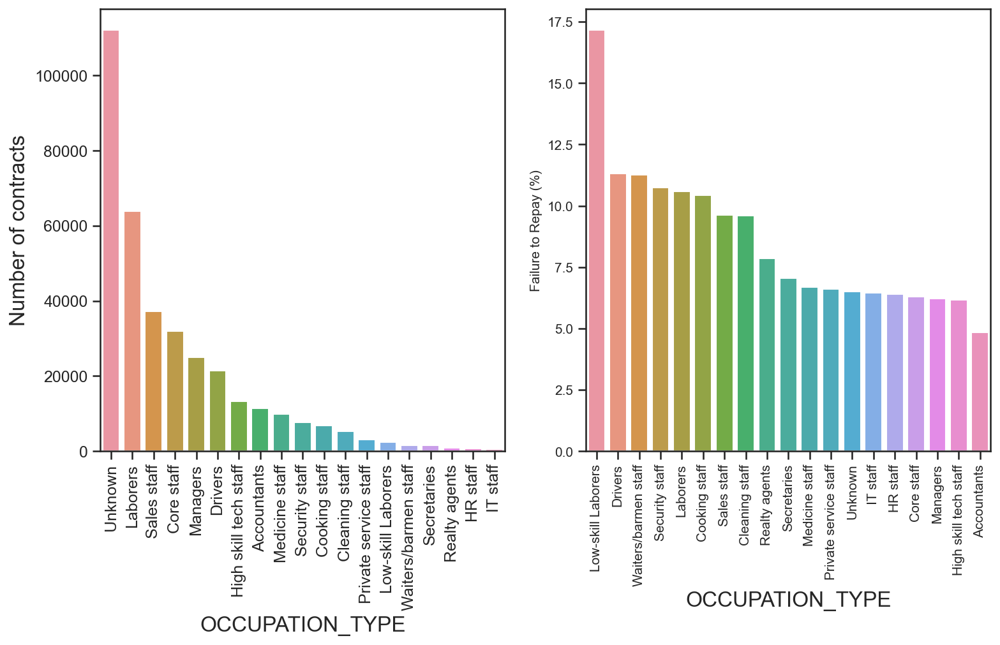

In [118]:
# Visualize the number of clients in each category
hist_distrib_cat(df_app, "OCCUPATION_TYPE", label_rotation=True)

Most of the loans are taken by Laborers, followed by Sales staff. IT staff take the lowest amount of loans.

The category with highest percent of not repaid loans are Low-skill Laborers (above 17%), followed by Drivers and Waiters/barmen staff, Security staff, Laborers and Cooking staff.

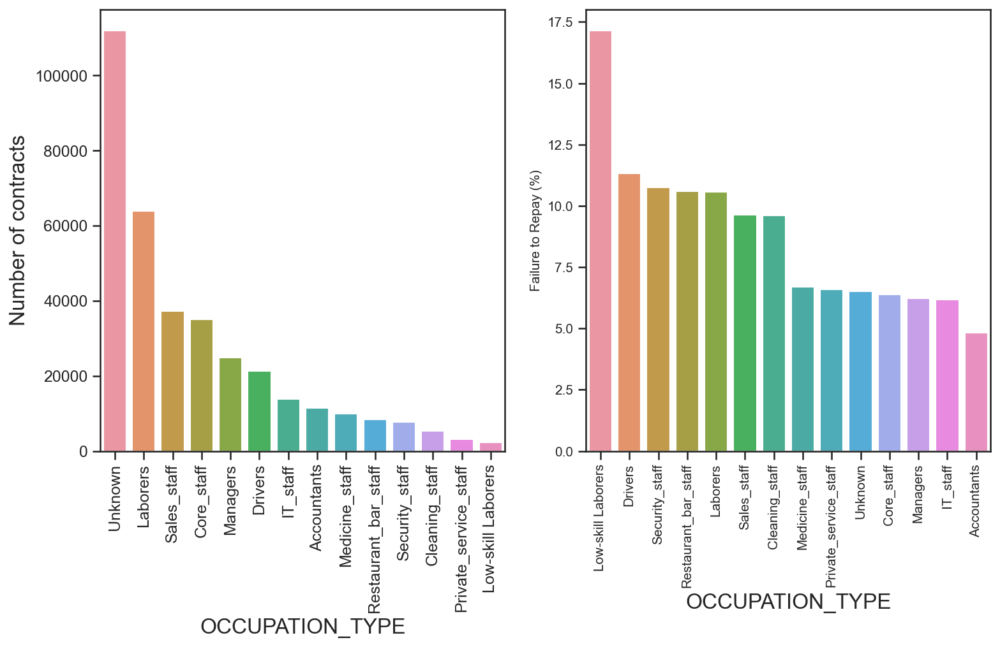

In [119]:
# Rename categories
df_app = rename_cat_occupation_type(df_app)
# Visualize the number of clients in each category
hist_distrib_cat(df_app,
                 "OCCUPATION_TYPE",
                 label_rotation=True)

<code style="background:lightyellow;color:black">Back to <a href="#C0">Table of contents</a></code>

#### <div class="alert alert-block alert-info"><a name="C2134">2.1.3.4 Feature engineering</a></div>

The feature engineering is based on: https://www.kaggle.com/code/jsaguiar/lightgbm-with-simple-features?scriptVersionId=6025993.

I will create 4 variables:
- CREDIT_INCOME_PERCENT: percentage of credit amount in relation to client's income
- ANNUITY_INCOME_PERCENT: percentage of loan annuity in relation to client income
- CREDIT_TERM: duration of repayment in months
- DAYS_EMPLOYED_PERCENT: percentage of days worked in relation to the client's age.

In [120]:
df_app_domain = df_app.copy()

df_app_domain["CREDIT_INCOME_PERCENT"] = (df_app_domain["AMT_CREDIT"]
                                          / df_app_domain["AMT_INCOME_TOTAL"])
df_app_domain["ANNUITY_INCOME_PERCENT"] = (df_app_domain["AMT_ANNUITY"] * 100
                                           / df_app_domain["AMT_INCOME_TOTAL"])
df_app_domain["CREDIT_TERM"] = (df_app_domain["AMT_CREDIT"]
                                / df_app_domain["AMT_ANNUITY"])
df_app_domain["DAYS_EMPLOYED_PERCENT"] = (df_app_domain["DAYS_EMPLOYED"]
                                          / df_app_domain["DAYS_BIRTH"])

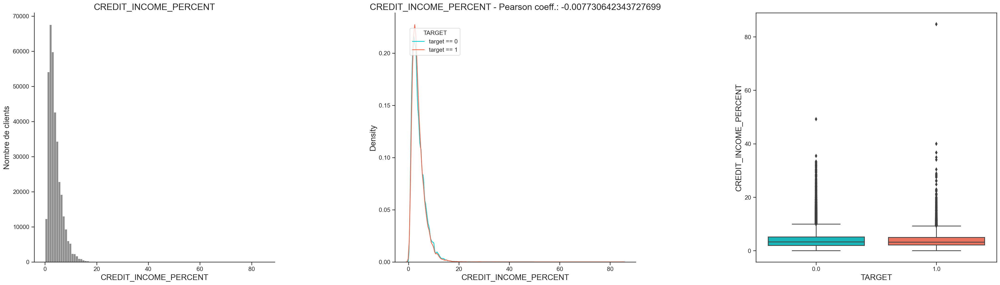

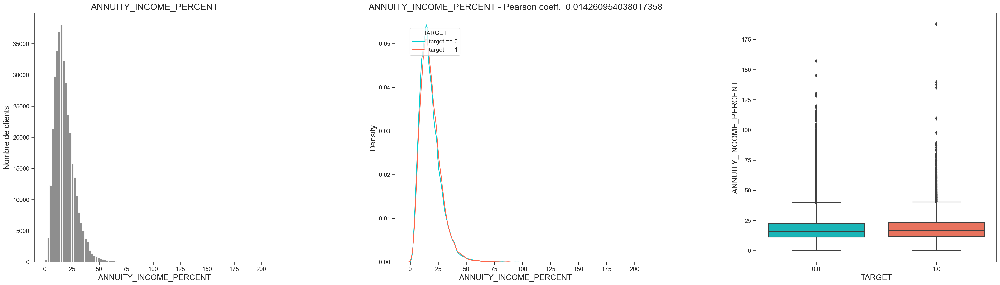

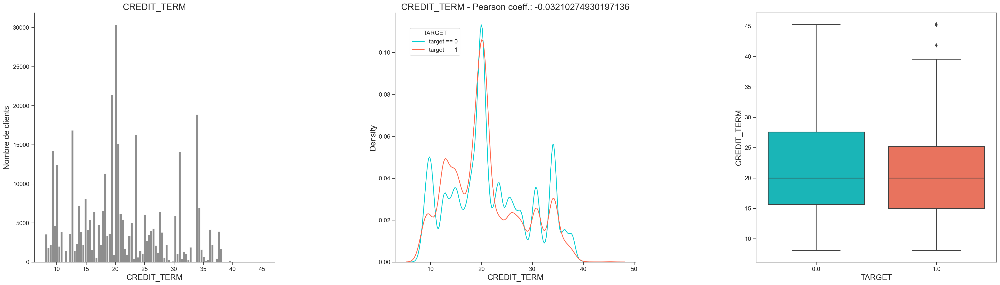

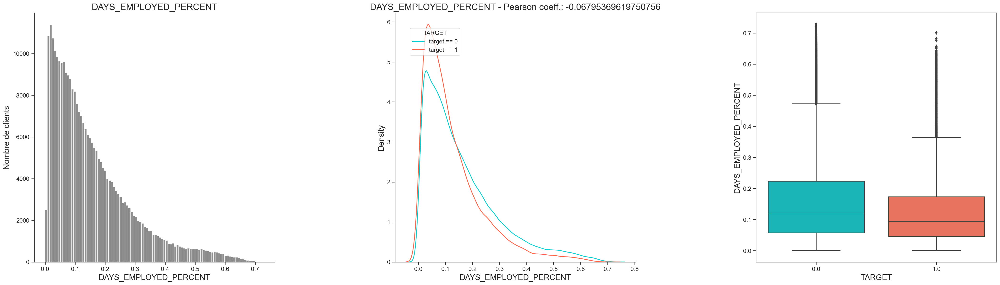

In [121]:
# Create a list with new variables
new_variables = ['CREDIT_INCOME_PERCENT',
                 'ANNUITY_INCOME_PERCENT',
                 'CREDIT_TERM',
                 'DAYS_EMPLOYED_PERCENT']

# iterate through the new features
for feature in new_variables:
    hist_distrib_target(df_app_domain, feature)

In [122]:
# Delete not useful variables
df_app_domain.drop(["YEARS_BIRTH"], axis=1, inplace=True)

In [123]:
# Define the repository to save
path_to_save = "C:/Users/virgi/OneDrive/Desktop/Projet7_github/Data_dashboard/"

In [124]:
# Save the dataframe df_app
df_app_domain.to_csv(path_to_save + "df_app_only.csv", index=False)

<code style="background:lightyellow;color:black">Back to <a href="#C0">Table of contents</a></code>

## <div class="alert alert-block alert-info"><a name="C22">2.2. "bureau_application" dataset</a></div>

This dataset contains monthly balances of previous credits in Credit Bureau.

### <div class="alert alert-block alert-info"><a name="C221">2.2.1. Dataset discovery</a></div>

In [125]:
# Load the dataframe
df_bureau_balance = pd.read_csv("Data_original/bureau_balance.csv")

# Display the 5 first raws
df_bureau_balance.head()

,SK_ID_BUREAU,MONTHS_BALANCE,STATUS
0,5715448,0,C
1,5715448,-1,C
2,5715448,-2,C
3,5715448,-3,C
4,5715448,-4,C


In [126]:
# Display dataframe shape
print("The dataframe consists of",
      df_bureau_balance.shape[0], "raws and",
      df_bureau_balance.shape[1], "columns")

The dataframe consists of 27299925 raws and 3 columns


In [127]:
# Check for duplicate values
print("Number of duplicate values:", df_bureau_balance.duplicated().sum())

Number of duplicate values: 0


In [128]:
# Check for duplicate values on  SK_ID_BUREAU
n = df_bureau_balance.duplicated(subset="SK_ID_BUREAU").sum()
print(f"column: SK_ID_BUREAU -> duplicat: {n}")

column: SK_ID_BUREAU -> duplicat: 26482530


In [129]:
# Display the 10 variables with the most missing values
missing_data(df_bureau_balance).head(3)

,Total,Percent
SK_ID_BUREAU,0,0.0
MONTHS_BALANCE,0,0.0
STATUS,0,0.0


<AxesSubplot:>

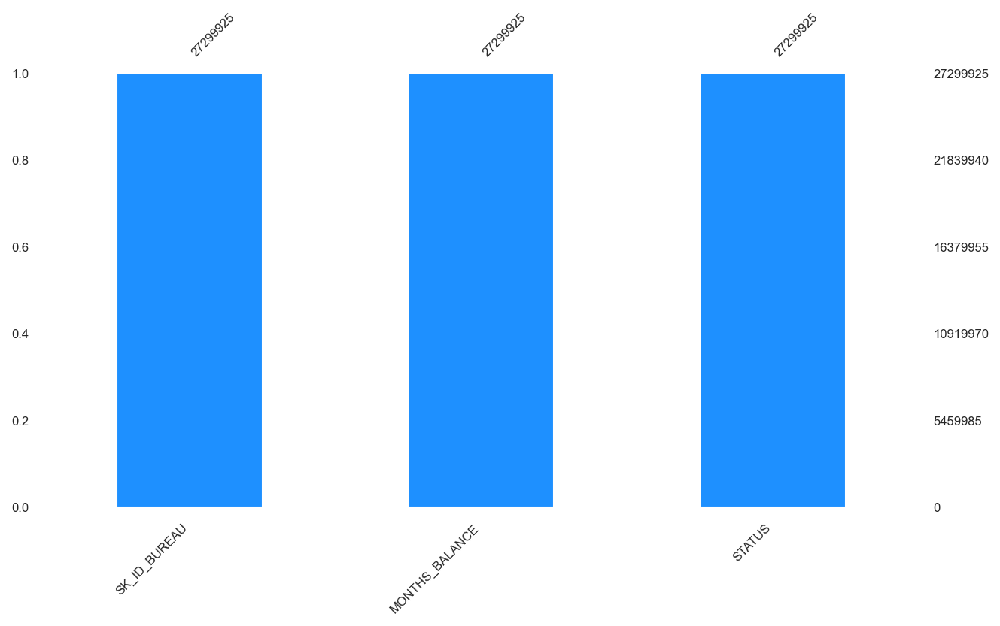

In [130]:
# Graph of the filling rate of the different variables
msno.bar(df_bureau_balance,
         color="dodgerblue",
         sort="ascending",
         figsize=(10, 5),
         fontsize=8)

This dataset contains no missing values.

<code style="background:lightyellow;color:black">Back to <a href="#C0">Table of contents</a></code>

### <div class="alert alert-block alert-info"><a name="C222">2.2.2. Feature engineering</a></div>

In [131]:
# Filter to exclude closed credit and unknown statur
df_tmp = df_bureau_balance.loc[df_bureau_balance["STATUS"] != "C"]
df_tmp = df_tmp.loc[df_tmp["STATUS"] != "X"]

In [132]:
# Filter to keep the status on the last 24 months
df_tmp = df_tmp.loc[df_tmp["MONTHS_BALANCE"] > -25]

In [133]:
# Group on SK_ID_BUREAU to get the most frequent status
df_tmp_grouped = df_tmp.groupby(["SK_ID_BUREAU"])["STATUS"].max().reset_index()

# Rename columns
df_tmp_grouped.columns = ["SK_ID_BUREAU", "MOST_FREQ_STATUS"]
df_tmp_grouped.head()

,SK_ID_BUREAU,MOST_FREQ_STATUS
0,5001711,0
1,5001712,0
2,5001717,0
3,5001718,1
4,5001720,1


<code style="background:lightyellow;color:black">Back to <a href="#C0">Table of contents</a></code>

## <div class="alert alert-block alert-info"><a name="C23">2.3. "bureau" dataframe</a></div>

All client's previous credits provided by other financial institutions that were reported to Credit Bureau (for clients who have a loan in our sample).

### <div class="alert alert-block alert-info"><a name="C231">2.3.1. Dataset discovery</a></div>

In [134]:
# Load the dataframe
df_bureau = pd.read_csv("Data_original/bureau.csv")

# Display the 5 first raws
df_bureau.head()

,SK_ID_CURR,SK_ID_BUREAU,CREDIT_ACTIVE,CREDIT_CURRENCY,DAYS_CREDIT,CREDIT_DAY_OVERDUE,DAYS_CREDIT_ENDDATE,DAYS_ENDDATE_FACT,AMT_CREDIT_MAX_OVERDUE,CNT_CREDIT_PROLONG,AMT_CREDIT_SUM,AMT_CREDIT_SUM_DEBT,AMT_CREDIT_SUM_LIMIT,AMT_CREDIT_SUM_OVERDUE,CREDIT_TYPE,DAYS_CREDIT_UPDATE,AMT_ANNUITY
0,215354,5714462,Closed,currency 1,-497,0,-153.0,-153.0,NaN,0,91323.0,0.0,NaN,0.0,Consumer credit,-131,NaN
1,215354,5714463,Active,currency 1,-208,0,1075.0,NaN,NaN,0,225000.0,171342.0,NaN,0.0,Credit card,-20,NaN
2,215354,5714464,Active,currency 1,-203,0,528.0,NaN,NaN,0,464323.5,NaN,NaN,0.0,Consumer credit,-16,NaN
3,215354,5714465,Active,currency 1,-203,0,NaN,NaN,NaN,0,90000.0,NaN,NaN,0.0,Credit card,-16,NaN
4,215354,5714466,Active,currency 1,-629,0,1197.0,NaN,77674.5,0,2700000.0,NaN,NaN,0.0,Consumer credit,-21,NaN


In [135]:
# Display dataframe shape
print("The dataframe consists of",
      df_bureau.shape[0], "raws and",
      df_bureau.shape[1], "columns.")

The dataframe consists of 1716428 raws and 17 columns.


In [136]:
# Check for duplicate values
print("Number of duplicate values:", df_bureau.duplicated().sum())

Number of duplicate values: 0


In [137]:
# Check for duplicate values on "SK_ID_CURR"
n = df_bureau.duplicated(subset="SK_ID_CURR").sum()
print(f"column: SK_ID_CURR -> duplicat: {n}")

column: SK_ID_CURR -> duplicat: 1410617


Some clients are present several times in this dataset indicated that they have had credit in the past from other loan agency.

In [138]:
# Display the 10 variables with the most missing values
missing_data(df_bureau).head(10)

,Total,Percent
AMT_ANNUITY,1226791,71.473490
AMT_CREDIT_MAX_OVERDUE,1124488,65.513264
DAYS_ENDDATE_FACT,633653,36.916958
AMT_CREDIT_SUM_LIMIT,591780,34.477415
AMT_CREDIT_SUM_DEBT,257669,15.011932
DAYS_CREDIT_ENDDATE,105553,6.149573
AMT_CREDIT_SUM,13,0.000757
CREDIT_ACTIVE,0,0.000000
CREDIT_CURRENCY,0,0.000000
DAYS_CREDIT,0,0.000000


<AxesSubplot:>

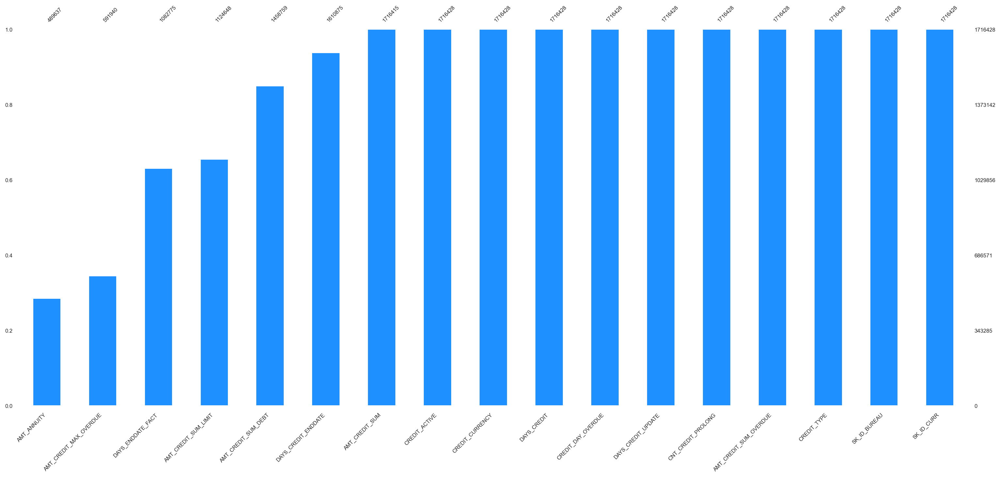

In [139]:
# Graph of the filling rate of the different variables
msno.bar(df_bureau,
         color="dodgerblue",
         sort="ascending",
         fontsize=8,
         orientation="bottom")

Six variables out of 17 show between 1 and 72% of missing values. These will be addressed as needed later in this notebook.

<code style="background:lightyellow;color:black">Back to <a href="#C0">Table of contents</a></code>

### <div class="alert alert-block alert-info"><a name="C232">2.3.2. EDA</a></div>

In [140]:
# Drop variables with more than 1% of missing values
df_bureau = remove_missing_columns(df_bureau, threshold=1)
df_bureau.shape

There are 6 columns with greater than 1% missing values.


(1716428, 11)

**Variable "CREDIT_ACTIVE"**

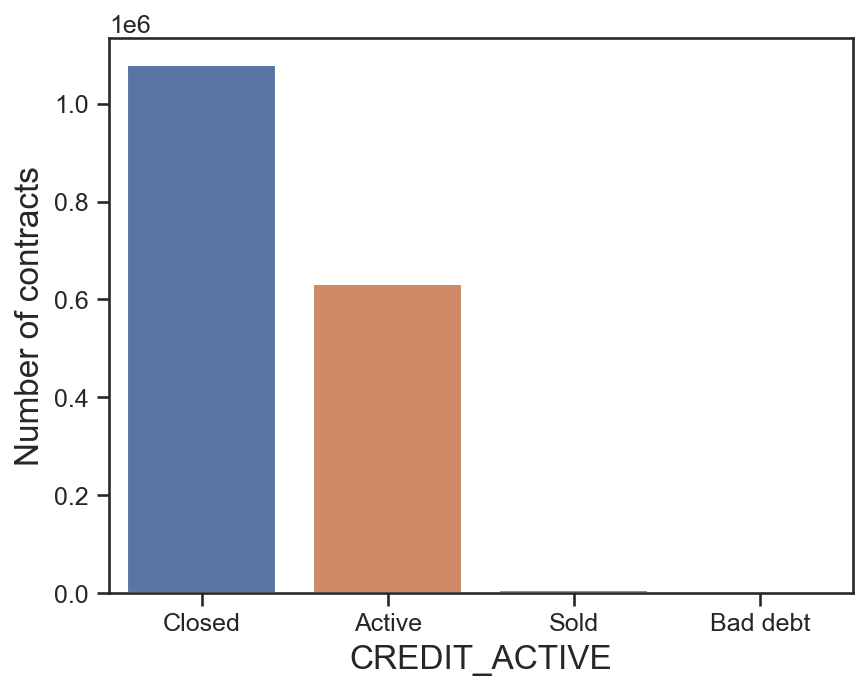

In [141]:
hist_distrib_cat_no_target(df_bureau, "CREDIT_ACTIVE")

**Variable "AMT_CREDIT_SUM"**

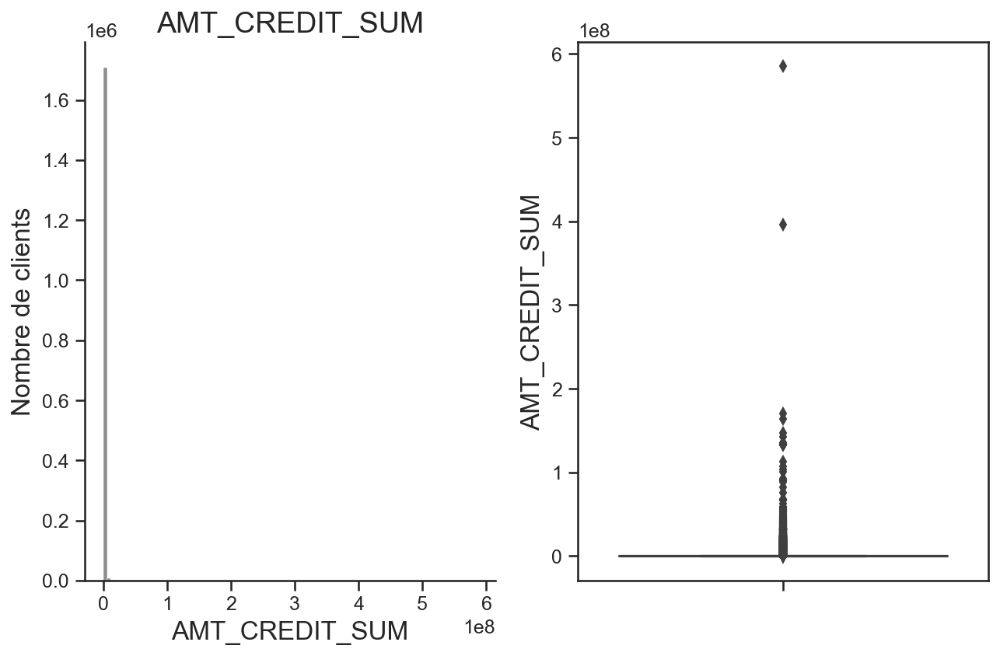

In [142]:
hist_distrib(df_bureau, "AMT_CREDIT_SUM")

**Variable "CREDIT_DAY_OVERDUE"**

Number of days past due on CB credit at the time of application for related loan in our sample

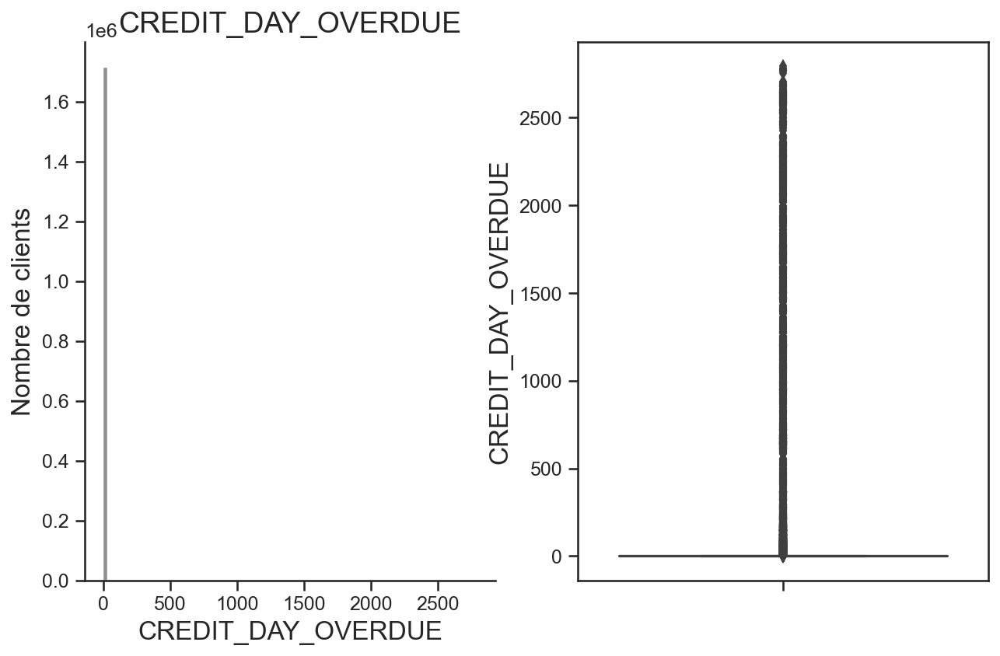

In [143]:
hist_distrib(df_bureau, "CREDIT_DAY_OVERDUE")

**Variable "DAYS_CREDIT"**

How many days before current application did client apply for Credit Bureau credit,time only relative to the application

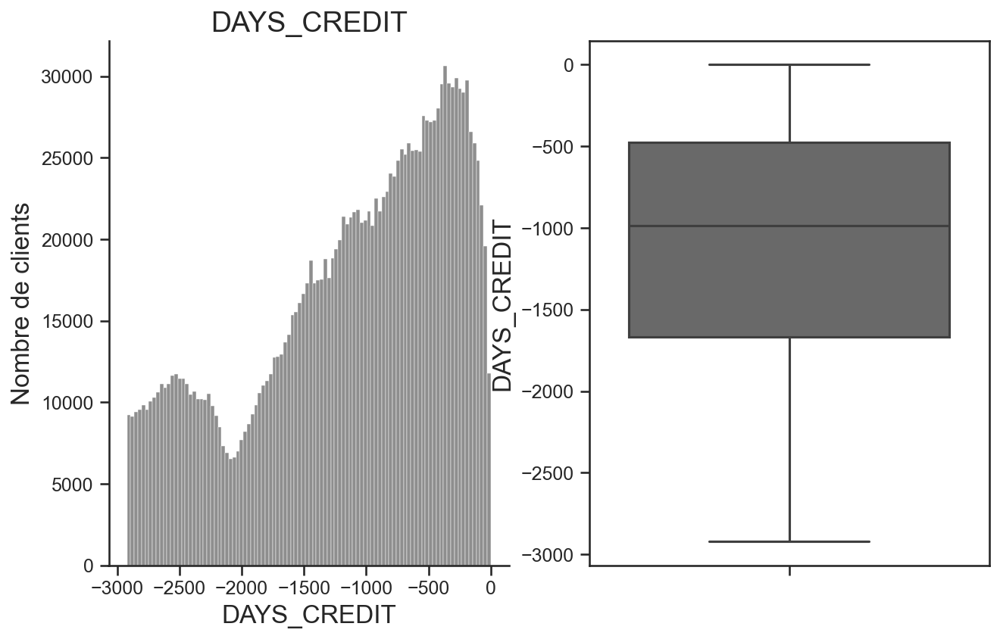

In [144]:
hist_distrib(df_bureau, "DAYS_CREDIT")

<code style="background:lightyellow;color:black">Back to <a href="#C0">Table of contents</a></code>

### <div class="alert alert-block alert-info"><a name="C233">2.3.3. Feature engineering</a></div>

**Merge with grouped data from "bureau balance" dataset**

In [145]:
df_bureau = df_bureau.merge(df_tmp_grouped, on="SK_ID_BUREAU", how="left")
df_bureau.head()

,SK_ID_CURR,SK_ID_BUREAU,CREDIT_ACTIVE,CREDIT_CURRENCY,DAYS_CREDIT,CREDIT_DAY_OVERDUE,CNT_CREDIT_PROLONG,AMT_CREDIT_SUM,AMT_CREDIT_SUM_OVERDUE,CREDIT_TYPE,DAYS_CREDIT_UPDATE,MOST_FREQ_STATUS
0,215354,5714462,Closed,currency 1,-497,0,0,91323.0,0.0,Consumer credit,-131,NaN
1,215354,5714463,Active,currency 1,-208,0,0,225000.0,0.0,Credit card,-20,NaN
2,215354,5714464,Active,currency 1,-203,0,0,464323.5,0.0,Consumer credit,-16,NaN
3,215354,5714465,Active,currency 1,-203,0,0,90000.0,0.0,Credit card,-16,NaN
4,215354,5714466,Active,currency 1,-629,0,0,2700000.0,0.0,Consumer credit,-21,NaN


In [146]:
# Fill missing value with "unknow"
df_bureau = df_bureau.fillna(value=({"MOST_FREQ_STATUS": "Unknow"}))

# Group by "SK_ID_CURR"
df_id_curr_gp = df_bureau.groupby(["SK_ID_CURR"]).agg({"SK_ID_BUREAU": "count",
                                                       "MOST_FREQ_STATUS": "max",
                                                       "CREDIT_DAY_OVERDUE": "mean",
                                                       "AMT_CREDIT_SUM": "mean",
                                                       }).reset_index()

df_id_curr_gp.columns = ["SK_ID_CURR",
                         "NB_CREDIT_bureau",
                         "MOST_FREQ_STATUS_bureau",
                         "MEAN_CREDIT_DAY_OVERDUE_bureau",
                         "MEAN_AMT_CREDIT_SUM_bureau"]
df_id_curr_gp.head()

,SK_ID_CURR,NB_CREDIT_bureau,MOST_FREQ_STATUS_bureau,MEAN_CREDIT_DAY_OVERDUE_bureau,MEAN_AMT_CREDIT_SUM_bureau
0,100001,7,Unknow,0.0,207623.571429
1,100002,8,Unknow,0.0,108131.945625
2,100003,4,Unknow,0.0,254350.125000
3,100004,2,Unknow,0.0,94518.900000
4,100005,3,0,0.0,219042.000000


**Create variables with numbers of closed and active credit**

In [147]:
# To get the number of active credit
df_tmp = df_bureau.loc[df_bureau["CREDIT_ACTIVE"] == "Active"]
df_tmp = df_tmp.groupby(["SK_ID_CURR"]).agg({"CREDIT_ACTIVE": "count"}).reset_index()
df_tmp.columns = ["SK_ID_CURR", "NB_ACTIVE_CREDIT_bureau"]
df_tmp.head()

,SK_ID_CURR,NB_ACTIVE_CREDIT_bureau
0,100001,3
1,100002,2
2,100003,1
3,100005,2
4,100008,1


In [148]:
# Merge with df_id_curr_gp
df_id_curr_gp = df_id_curr_gp.merge(df_tmp, on="SK_ID_CURR", how="left")

In [149]:
# To get the number of closed credit
df_tmp = df_bureau.loc[df_bureau["CREDIT_ACTIVE"] == "Closed"]
df_tmp = df_tmp.groupby(["SK_ID_CURR"]).agg({"CREDIT_ACTIVE": "count"}).reset_index()
df_tmp.columns = ["SK_ID_CURR", "NB_CLOSED_CREDIT_bureau"]
df_tmp.head()

,SK_ID_CURR,NB_CLOSED_CREDIT_bureau
0,100001,4
1,100002,6
2,100003,3
3,100004,2
4,100005,1


In [150]:
# Merge with df_id_curr_gp
df_id_curr_gp = df_id_curr_gp.merge(df_tmp, on="SK_ID_CURR", how="left")

In [151]:
missing_data(df_id_curr_gp)

,Total,Percent
NB_ACTIVE_CREDIT_bureau,53996,17.656657
NB_CLOSED_CREDIT_bureau,37886,12.388698
MEAN_AMT_CREDIT_SUM_bureau,2,0.000654
SK_ID_CURR,0,0.000000
NB_CREDIT_bureau,0,0.000000
MOST_FREQ_STATUS_bureau,0,0.000000
MEAN_CREDIT_DAY_OVERDUE_bureau,0,0.000000


In [152]:
# Fill missing value of MEAN_AMT_CREDIT_SUM_CB with mediane
df_id_curr_gp["MEAN_AMT_CREDIT_SUM_bureau"] = (df_id_curr_gp["MEAN_AMT_CREDIT_SUM_bureau"].fillna(
                                               df_id_curr_gp["MEAN_AMT_CREDIT_SUM_bureau"].median()))

# Fill missing value of other variables with 0
df_id_curr_gp["NB_ACTIVE_CREDIT_bureau"] = (df_id_curr_gp["NB_ACTIVE_CREDIT_bureau"].fillna(0))
df_id_curr_gp["NB_CLOSED_CREDIT_bureau"] = (df_id_curr_gp["NB_CLOSED_CREDIT_bureau"].fillna(0))

In [153]:
# Load df_app_only
df_app_only = pd.read_csv(path_to_save +"df_app_only.csv")
df_app_only.shape

(356248, 78)

In [154]:
# Merge datasets
df_app_bureau = df_app_only.merge(df_id_curr_gp, on="SK_ID_CURR", how="left")

In [155]:
# Look at the missing values
missing_data(df_app_bureau).head(10)

,Total,Percent
EXT_SOURCE_3,69632,19.545934
DAYS_EMPLOYED,64648,18.146909
DAYS_EMPLOYED_PERCENT,64648,18.146909
MOST_FREQ_STATUS_bureau,50443,14.159518
NB_CREDIT_bureau,50443,14.159518
NB_CLOSED_CREDIT_bureau,50443,14.159518
MEAN_CREDIT_DAY_OVERDUE_bureau,50443,14.159518
MEAN_AMT_CREDIT_SUM_bureau,50443,14.159518
NB_ACTIVE_CREDIT_bureau,50443,14.159518
TARGET,48743,13.682322


In [156]:
# Fill missing value with 0 (except for target)
var_to_fill = df_id_curr_gp.columns.tolist()
var_to_fill.remove("SK_ID_CURR")

for var in var_to_fill:
    df_app_bureau[var] = df_app_bureau[var].fillna(0)

In [157]:
# Save the dataframe
df_app_bureau.to_csv(path_to_save + "df_app_bureau.csv", index=False)

<code style="background:lightyellow;color:black">Back to <a href="#C0">Table of contents</a></code>

## <div class="alert alert-block alert-info"><a name="C24">2.4."credit_card_balance" dataframe</a></div>

Monthly balance snapshots of previous credit cards that the applicant has with Home Credit.

### <div class="alert alert-block alert-info"><a name="C241">2.4.1. Dataset discovery</a></div>

In [158]:
# Load the dataframe
df_credit_card_balance = pd.read_csv("Data_original/credit_card_balance.csv")

# Display the 5 first raws
df_credit_card_balance.head()

,SK_ID_PREV,SK_ID_CURR,MONTHS_BALANCE,AMT_BALANCE,AMT_CREDIT_LIMIT_ACTUAL,AMT_DRAWINGS_ATM_CURRENT,AMT_DRAWINGS_CURRENT,AMT_DRAWINGS_OTHER_CURRENT,AMT_DRAWINGS_POS_CURRENT,AMT_INST_MIN_REGULARITY,...,AMT_RECIVABLE,AMT_TOTAL_RECEIVABLE,CNT_DRAWINGS_ATM_CURRENT,CNT_DRAWINGS_CURRENT,CNT_DRAWINGS_OTHER_CURRENT,CNT_DRAWINGS_POS_CURRENT,CNT_INSTALMENT_MATURE_CUM,NAME_CONTRACT_STATUS,SK_DPD,SK_DPD_DEF
0,2562384,378907,-6,56.970,135000,0.0,877.5,0.0,877.5,1700.325,...,0.000,0.000,0.0,1,0.0,1.0,35.0,Active,0,0
1,2582071,363914,-1,63975.555,45000,2250.0,2250.0,0.0,0.0,2250.000,...,64875.555,64875.555,1.0,1,0.0,0.0,69.0,Active,0,0
2,1740877,371185,-7,31815.225,450000,0.0,0.0,0.0,0.0,2250.000,...,31460.085,31460.085,0.0,0,0.0,0.0,30.0,Active,0,0
3,1389973,337855,-4,236572.110,225000,2250.0,2250.0,0.0,0.0,11795.760,...,233048.970,233048.970,1.0,1,0.0,0.0,10.0,Active,0,0
4,1891521,126868,-1,453919.455,450000,0.0,11547.0,0.0,11547.0,22924.890,...,453919.455,453919.455,0.0,1,0.0,1.0,101.0,Active,0,0


In [159]:
# Display dataframe shape
print("The dataframe consists of",
      df_credit_card_balance.shape[0], "raws and",
      df_credit_card_balance.shape[1], "columns.")

The dataframe consists of 3840312 raws and 23 columns.


In [160]:
# Check for duplicate values
print("Number of duplicate values:",
      df_credit_card_balance.duplicated().sum())

Number of duplicate values: 0


In [161]:
# Check for duplicate values on "SK_ID_CURR"
n = df_credit_card_balance.duplicated(subset="SK_ID_CURR").sum()
print(f"column: SK_ID_CURR -> duplicat: {n}")

column: SK_ID_CURR -> duplicat: 3736754


In [162]:
# Display the 10 variables with the most missing values
missing_data(df_credit_card_balance).head(10)

,Total,Percent
AMT_PAYMENT_CURRENT,767988,19.998063
AMT_DRAWINGS_ATM_CURRENT,749816,19.524872
CNT_DRAWINGS_POS_CURRENT,749816,19.524872
AMT_DRAWINGS_OTHER_CURRENT,749816,19.524872
AMT_DRAWINGS_POS_CURRENT,749816,19.524872
CNT_DRAWINGS_OTHER_CURRENT,749816,19.524872
CNT_DRAWINGS_ATM_CURRENT,749816,19.524872
CNT_INSTALMENT_MATURE_CUM,305236,7.948208
AMT_INST_MIN_REGULARITY,305236,7.948208
SK_ID_PREV,0,0.000000


<AxesSubplot:>

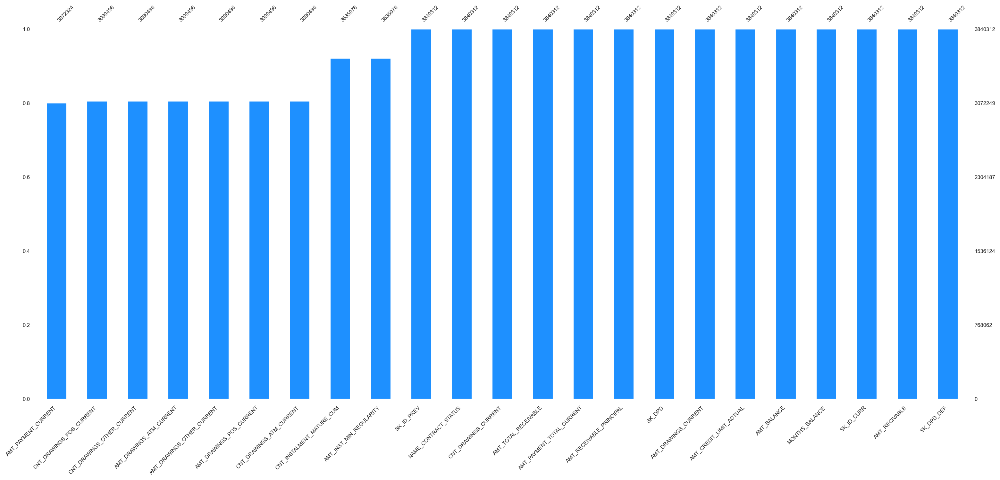

In [163]:
# Graph of the filling rate of the different variables
msno.bar(df_credit_card_balance,
         color="dodgerblue",
         sort="ascending",
         fontsize=8)

Nine variables contain until 20% of missing values. These will be addressed as needed later in this notebook.

<code style="background:lightyellow;color:black">Back to <a href="#C0">Table of contents</a></code>

### <div class="alert alert-block alert-info"><a name="C242">2.4.2. EDA</a></div>

In [164]:
# keep only data from last year.
df_tmp_cc = df_credit_card_balance.loc[df_credit_card_balance["MONTHS_BALANCE"] > -13]

**Variable "AMT_BALANCE"**

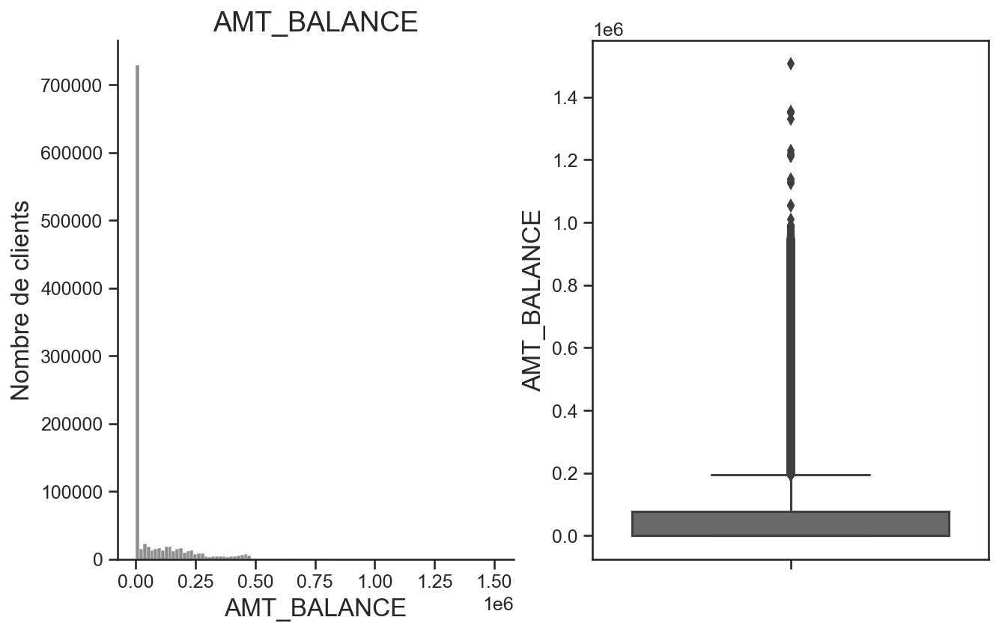

In [165]:
hist_distrib(df_tmp_cc, "AMT_BALANCE")

**Variable "AMT_PAYMENT_TOTAL_CURRENT"**

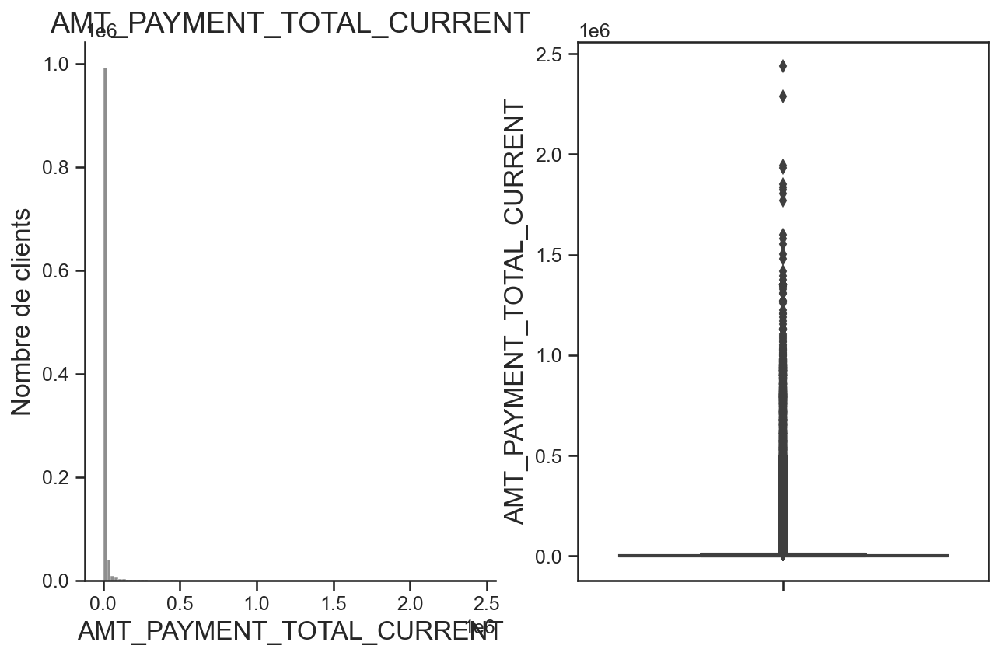

In [166]:
hist_distrib(df_tmp_cc, "AMT_PAYMENT_TOTAL_CURRENT")

**Variable "SK_DPD"**

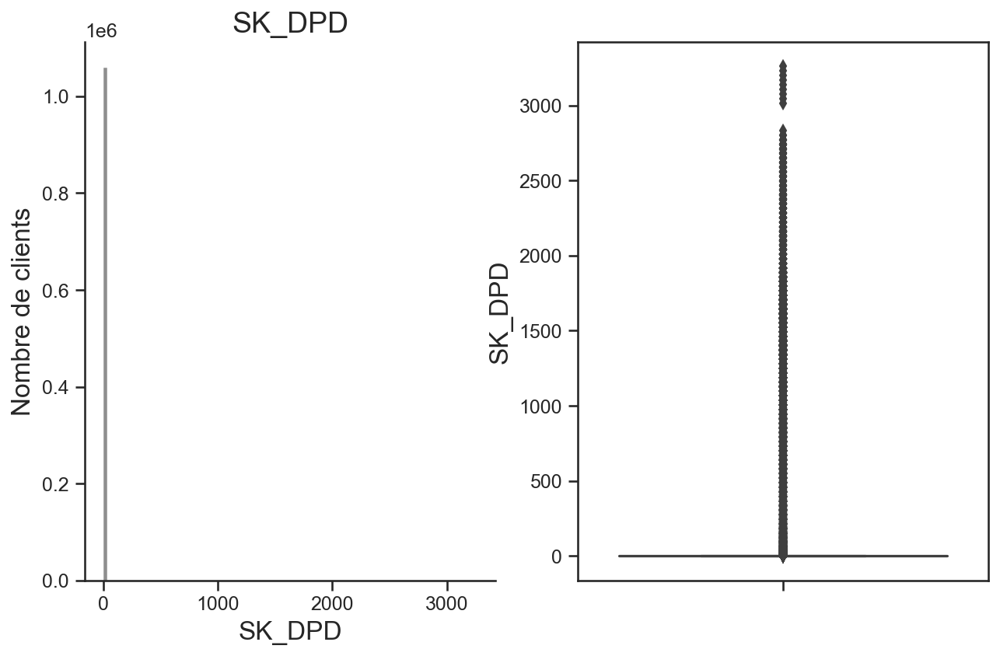

In [167]:
hist_distrib(df_tmp_cc, "SK_DPD")

**Variable "SK_DPD_DEF"**

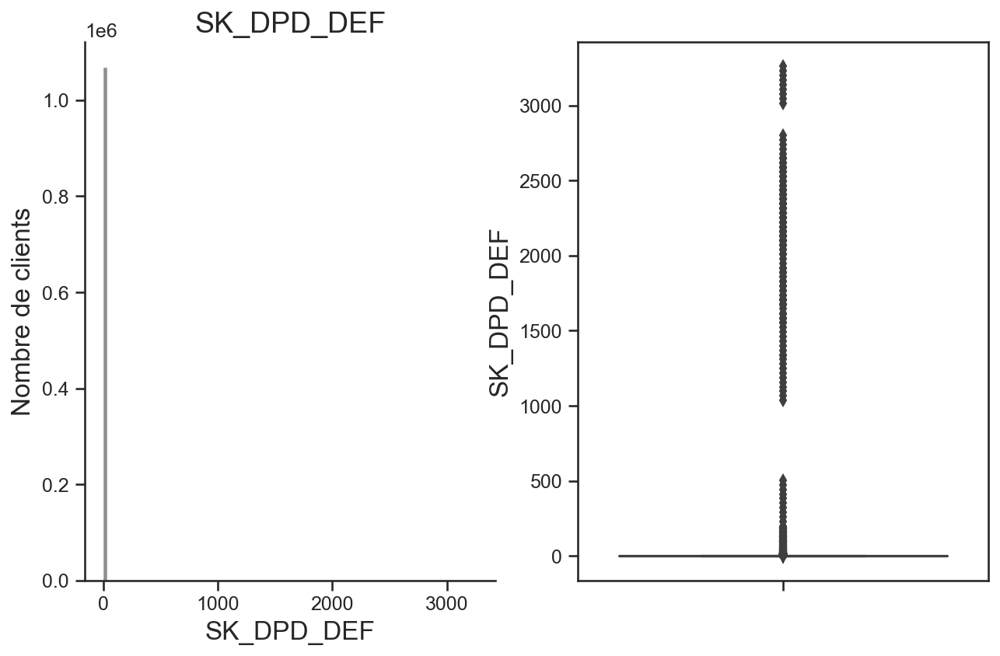

In [168]:
hist_distrib(df_tmp_cc, "SK_DPD_DEF")

<code style="background:lightyellow;color:black">Back to <a href="#C0">Table of contents</a></code>

### <div class="alert alert-block alert-info"><a name="C243">2.4.3. Feature engineering</a></div>

In [169]:
df_tmp_cc = df_tmp_cc.groupby(["SK_ID_CURR"]).agg({"SK_ID_PREV": "count",
                                                   "AMT_BALANCE": "mean",
                                                   "AMT_PAYMENT_TOTAL_CURRENT": "mean",
                                                   "SK_DPD": "mean",
                                                   "SK_DPD_DEF": "mean"}).reset_index()

df_tmp_cc.columns = ["SK_ID_CURR",
                     "NB_PREV_CREDIT_CC",
                     "MEAN_AMT_BALANCE_CC",
                     "MEAN_AMT_PAY_CURR_CC",
                     "MEAN_SK_DPD_CC",
                     "MEAN_SK_DPD_DEF_CC"]

df_tmp_cc.head()

,SK_ID_CURR,NB_PREV_CREDIT_CC,MEAN_AMT_BALANCE_CC,MEAN_AMT_PAY_CURR_CC,MEAN_SK_DPD_CC,MEAN_SK_DPD_DEF_CC
0,100006,6,0.0,0.0,0.0,0.0
1,100011,11,0.0,0.0,0.0,0.0
2,100013,12,0.0,0.0,0.0,0.0
3,100021,11,0.0,0.0,0.0,0.0
4,100023,8,0.0,0.0,0.0,0.0


In [170]:
# Check missing values
missing_data(df_tmp_cc).head()

,Total,Percent
SK_ID_CURR,0,0.0
NB_PREV_CREDIT_CC,0,0.0
MEAN_AMT_BALANCE_CC,0,0.0
MEAN_AMT_PAY_CURR_CC,0,0.0
MEAN_SK_DPD_CC,0,0.0


In [171]:
# Load df_app_bureau
df_app_bureau = pd.read_csv(path_to_save + "df_app_bureau.csv")
df_app_bureau.shape

(356248, 84)

In [172]:
# Merge with df_app_bureau
df_app_bur_cc = df_app_bureau.merge(df_tmp_cc, on="SK_ID_CURR", how="left")
df_app_bur_cc.shape

(356248, 89)

In [173]:
# Check missing values
missing_data(df_app_bur_cc).head(10)

,Total,Percent
MEAN_SK_DPD_DEF_CC,252690,70.930925
NB_PREV_CREDIT_CC,252690,70.930925
MEAN_SK_DPD_CC,252690,70.930925
MEAN_AMT_PAY_CURR_CC,252690,70.930925
MEAN_AMT_BALANCE_CC,252690,70.930925
EXT_SOURCE_3,69632,19.545934
DAYS_EMPLOYED_PERCENT,64648,18.146909
DAYS_EMPLOYED,64648,18.146909
TARGET,48743,13.682322
AMT_REQ_CREDIT_BUREAU_YEAR,47567,13.352215


Like there are a lot of missing values, I will just keep the number of previous credit in Home Credit and fill the missing values with 0.

In [174]:
# Drop new variables
var_to_drop = ["MEAN_SK_DPD_DEF_CC",
               "MEAN_SK_DPD_CC",
               "MEAN_AMT_PAY_CURR_CC",
               "MEAN_AMT_BALANCE_CC"]
df_app_bur_cc.drop(columns=var_to_drop, axis=1, inplace=True)

# Fill missing value of NB_PREV_CREDIT_CC
df_app_bur_cc["NB_PREV_CREDIT_CC"] = (df_app_bur_cc["NB_PREV_CREDIT_CC"].fillna(0))

<code style="background:lightyellow;color:black">Back to <a href="#C0">Table of contents</a></code>

## <div class="alert alert-block alert-info"><a name="C25">2.5. "installments_payments" dataframe</a></div>

Repayment history for the previously disbursed credits in Home Credit related to the loans in our sample.

### <div class="alert alert-block alert-info"><a name="C251">2.5.1. Dataset discovery</a></div>

In [175]:
# Load the dataframe
df_install_payments = pd.read_csv("Data_original/installments_payments.csv")

# Display the 5 first raws
df_install_payments.head()

,SK_ID_PREV,SK_ID_CURR,NUM_INSTALMENT_VERSION,NUM_INSTALMENT_NUMBER,DAYS_INSTALMENT,DAYS_ENTRY_PAYMENT,AMT_INSTALMENT,AMT_PAYMENT
0,1054186,161674,1.0,6,-1180.0,-1187.0,6948.360,6948.360
1,1330831,151639,0.0,34,-2156.0,-2156.0,1716.525,1716.525
2,2085231,193053,2.0,1,-63.0,-63.0,25425.000,25425.000
3,2452527,199697,1.0,3,-2418.0,-2426.0,24350.130,24350.130
4,2714724,167756,1.0,2,-1383.0,-1366.0,2165.040,2160.585


In [176]:
# Display dataframe shape
print("The dataframe consists of",
      df_install_payments.shape[0], "raws and",
      df_install_payments.shape[1], "columns.")

The dataframe consists of 13605401 raws and 8 columns.


In [177]:
# Check for duplicate values
print("Number of duplicate values:", df_install_payments.duplicated().sum())

Number of duplicate values: 0


In [178]:
# Check for duplicate values on "SK_ID_CURR"
n = df_install_payments.duplicated(subset="SK_ID_CURR").sum()
print(f"column: SK_ID_CURR -> duplicat: {n}")

column: SK_ID_CURR -> duplicat: 13265814


In [179]:
# Display the 10 variables with the most missing values
missing_data(df_install_payments).head(10)

,Total,Percent
DAYS_ENTRY_PAYMENT,2905,0.021352
AMT_PAYMENT,2905,0.021352
SK_ID_PREV,0,0.000000
SK_ID_CURR,0,0.000000
NUM_INSTALMENT_VERSION,0,0.000000
NUM_INSTALMENT_NUMBER,0,0.000000
DAYS_INSTALMENT,0,0.000000
AMT_INSTALMENT,0,0.000000


<AxesSubplot:>

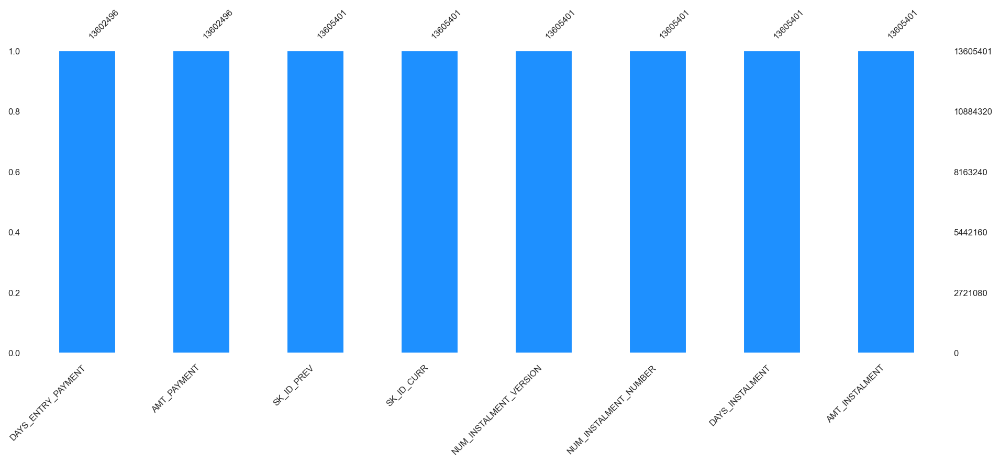

In [180]:
# Graph of the filling rate of the different variables
msno.bar(df_install_payments,
         color="dodgerblue",
         sort="ascending",
         figsize=(15, 5),
         fontsize=8)

Two variables have less than 1% of missing values. These will be addressed as needed later in this notebook.

<code style="background:lightyellow;color:black">Back to <a href="#C0">Table of contents</a></code>

## <div class="alert alert-block alert-info"><a name="C252">2.5.2. EDA</a></div>

In [181]:
# Filter to keep the most recent
df_tmp_ip = df_install_payments.loc[df_install_payments["DAYS_INSTALMENT"] > 2*-365]

<code style="background:lightyellow;color:black">Back to <a href="#C0">Table of contents</a></code>

## <div class="alert alert-block alert-info"><a name="C253">2.5.3. Feature engineering</a></div>

In [182]:
df_tmp_ip.loc[:, "DAYS_INSTALMENT_delay"] = (df_tmp_ip["DAYS_ENTRY_PAYMENT"]
                                             - df_tmp_ip["DAYS_INSTALMENT"])


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


In [183]:
df_tmp_ip.loc[:, "DAYS_INSTALMENT_delta"] = (df_tmp_ip["AMT_PAYMENT"]
                                             - df_tmp_ip["AMT_INSTALMENT"])


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


In [184]:
# Group on SK_ID_CURR
df_tmp_ip = df_tmp_ip.groupby(["SK_ID_CURR"]).agg({"DAYS_INSTALMENT_delay": "mean",
                                                   "DAYS_INSTALMENT_delta": "mean"}).reset_index()

df_tmp_ip.head()

,SK_ID_CURR,DAYS_INSTALMENT_delay,DAYS_INSTALMENT_delta
0,100002,-20.421053,0.0
1,100003,-7.000000,0.0
2,100004,-3.000000,0.0
3,100005,-23.555556,0.0
4,100006,-19.375000,0.0


In [185]:
# Check for missing values
missing_data(df_tmp_ip).head()

,Total,Percent
DAYS_INSTALMENT_delay,27,0.009191
DAYS_INSTALMENT_delta,27,0.009191
SK_ID_CURR,0,0.000000


In [186]:
# Fill missing value with median
df_tmp_ip["DAYS_INSTALMENT_delta"] = (df_tmp_ip["DAYS_INSTALMENT_delta"].fillna(
                                      df_tmp_ip["DAYS_INSTALMENT_delta"].median()))
df_tmp_ip["DAYS_INSTALMENT_delay"] = (df_tmp_ip["DAYS_INSTALMENT_delay"].fillna(
                                      df_tmp_ip["DAYS_INSTALMENT_delay"].median()))

In [187]:
# Merge with df_app_bureau
df_app_bur_cc_ip = df_app_bur_cc.merge(df_tmp_ip, on="SK_ID_CURR", how="left")
df_app_bur_cc_ip.shape

(356248, 87)

In [188]:
# Check for missing values
missing_data(df_app_bur_cc_ip).head()

,Total,Percent
EXT_SOURCE_3,69632,19.545934
DAYS_EMPLOYED,64648,18.146909
DAYS_EMPLOYED_PERCENT,64648,18.146909
DAYS_INSTALMENT_delta,62485,17.539748
DAYS_INSTALMENT_delay,62485,17.539748


In [189]:
# Fill missing values with 0
df_app_bur_cc_ip["DAYS_INSTALMENT_delta"] = (df_app_bur_cc_ip["DAYS_INSTALMENT_delta"].fillna(0))
df_app_bur_cc_ip["DAYS_INSTALMENT_delay"] = (df_app_bur_cc_ip["DAYS_INSTALMENT_delay"].fillna(0))

In [190]:
# Save the dataframe
df_app_bur_cc_ip.to_csv(path_to_save + "df_app_bur_cc_ip.csv", index=False)

<code style="background:lightyellow;color:black">Back to <a href="#C0">Table of contents</a></code>

## <div class="alert alert-block alert-info"><a name="C26">2.6. "POS_CASH_balance" dataframe</a></div>

Monthly balance snapshots of previous POS (point of sales) and cash loans that the applicant had with Home Credit.

### <div class="alert alert-block alert-info"><a name="C261">2.6.1. Dataset discovery</a></div>

In [191]:
# Load the dataframe
df_POS_CASH = pd.read_csv("Data_original/POS_CASH_balance.csv")

# Display the 5 first raws
df_POS_CASH.head()

,SK_ID_PREV,SK_ID_CURR,MONTHS_BALANCE,CNT_INSTALMENT,CNT_INSTALMENT_FUTURE,NAME_CONTRACT_STATUS,SK_DPD,SK_DPD_DEF
0,1803195,182943,-31,48.0,45.0,Active,0,0
1,1715348,367990,-33,36.0,35.0,Active,0,0
2,1784872,397406,-32,12.0,9.0,Active,0,0
3,1903291,269225,-35,48.0,42.0,Active,0,0
4,2341044,334279,-35,36.0,35.0,Active,0,0


In [192]:
# Display dataframe shape
print("The dataframe consists of",
      df_POS_CASH.shape[0], "raws and",
      df_POS_CASH.shape[1], "columns.")

The dataframe consists of 10001358 raws and 8 columns.


In [193]:
# Check for duplicate values
print("Number of duplicate values:", df_POS_CASH.duplicated().sum())

Number of duplicate values: 0


In [194]:
# Check for duplicate values on "SK_ID_CURR"
n = df_POS_CASH.duplicated(subset="SK_ID_CURR").sum()
print(f"column: SK_ID_CURR -> duplicat: {n}")

column: SK_ID_CURR -> duplicat: 9664106


In [195]:
# Display the 10 variables with the most missing values
missing_data(df_POS_CASH).head(10)

,Total,Percent
CNT_INSTALMENT_FUTURE,26087,0.260835
CNT_INSTALMENT,26071,0.260675
SK_ID_PREV,0,0.000000
SK_ID_CURR,0,0.000000
MONTHS_BALANCE,0,0.000000
NAME_CONTRACT_STATUS,0,0.000000
SK_DPD,0,0.000000
SK_DPD_DEF,0,0.000000


<AxesSubplot:>

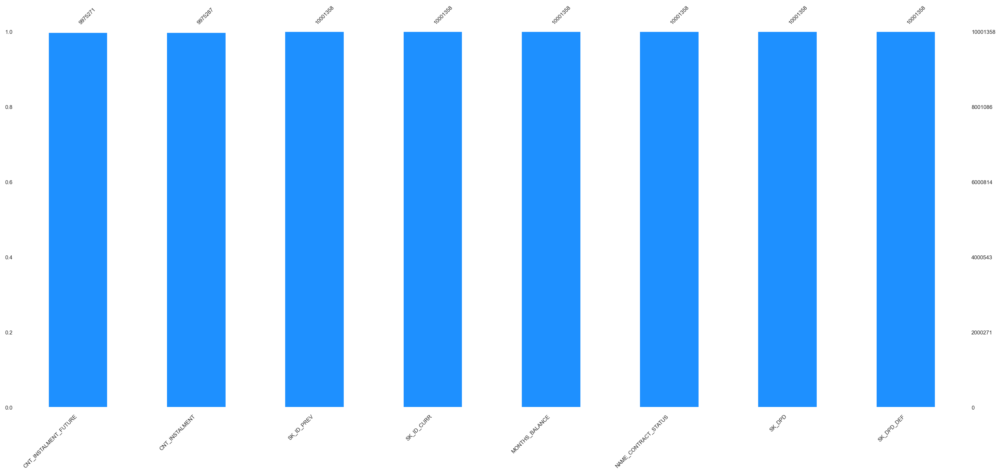

In [196]:
# Graph of the filling rate of the different variables
msno.bar(df_POS_CASH,
         color="dodgerblue",
         sort="ascending",
         fontsize=8)

Two variables have less than 1% of missing values. These will be addressed as needed later in this notebook.

<code style="background:lightyellow;color:black">Back to <a href="#C0">Table of contents</a></code>

### <div class="alert alert-block alert-info"><a name="C262">2.6.2. Feature engineering</a></div>

In [197]:
# Filter on the last 24 months
df_tmp_pc = df_POS_CASH.loc[df_POS_CASH["MONTHS_BALANCE"] > -25]

In [198]:
df_tmp_pc = df_tmp_pc.groupby(["SK_ID_CURR"]).agg({"SK_ID_PREV": "count"}).reset_index()

df_tmp_pc.columns = ["SK_ID_CURR",
                     "NB_POS_CASH"]

df_tmp_pc.head()

,SK_ID_CURR,NB_POS_CASH
0,100002,19
1,100003,11
2,100004,1
3,100005,10
4,100006,21


In [199]:
# Check for missing values
missing_data(df_tmp_pc).head()

,Total,Percent
SK_ID_CURR,0,0.0
NB_POS_CASH,0,0.0


In [200]:
# Merge with df_app_bureau
df_ap_bu_cc_ip_pc = df_app_bur_cc_ip.merge(df_tmp_pc,
                                           on="SK_ID_CURR",
                                           how="left")
df_ap_bu_cc_ip_pc.shape

(356248, 88)

In [201]:
# Check for missing values
missing_data(df_ap_bu_cc_ip_pc).head()

,Total,Percent
NB_POS_CASH,69755,19.580461
EXT_SOURCE_3,69632,19.545934
DAYS_EMPLOYED,64648,18.146909
DAYS_EMPLOYED_PERCENT,64648,18.146909
TARGET,48743,13.682322


In [202]:
# Fill missing values with 0
df_ap_bu_cc_ip_pc["NB_POS_CASH"] = df_ap_bu_cc_ip_pc["NB_POS_CASH"].fillna(0)

In [203]:
# Save the dataframe
df_ap_bu_cc_ip_pc.to_csv(path_to_save + "df_ap_bu_cc_ip_pc.csv", index=False)

<code style="background:lightyellow;color:black">Back to <a href="#C0">Table of contents</a></code>

## <div class="alert alert-block alert-info"><a name="C27">2.7. "previous_application" dataframe</a></div>

All previous applications for Home Credit loans of clients who have loans in our sample.

### <div class="alert alert-block alert-info"><a name="C271">2.7.1. Dataset discovery</a></div>

In [204]:
# Load the dataframe
df_previous = pd.read_csv("Data_original/previous_application.csv")

# Display the 5 first raws
df_previous.head()

,SK_ID_PREV,SK_ID_CURR,NAME_CONTRACT_TYPE,AMT_ANNUITY,AMT_APPLICATION,AMT_CREDIT,AMT_DOWN_PAYMENT,AMT_GOODS_PRICE,WEEKDAY_APPR_PROCESS_START,HOUR_APPR_PROCESS_START,...,NAME_SELLER_INDUSTRY,CNT_PAYMENT,NAME_YIELD_GROUP,PRODUCT_COMBINATION,DAYS_FIRST_DRAWING,DAYS_FIRST_DUE,DAYS_LAST_DUE_1ST_VERSION,DAYS_LAST_DUE,DAYS_TERMINATION,NFLAG_INSURED_ON_APPROVAL
0,2030495,271877,Consumer loans,1730.430,17145.0,17145.0,0.0,17145.0,SATURDAY,15,...,Connectivity,12.0,middle,POS mobile with interest,365243.0,-42.0,300.0,-42.0,-37.0,0.0
1,2802425,108129,Cash loans,25188.615,607500.0,679671.0,NaN,607500.0,THURSDAY,11,...,XNA,36.0,low_action,Cash X-Sell: low,365243.0,-134.0,916.0,365243.0,365243.0,1.0
2,2523466,122040,Cash loans,15060.735,112500.0,136444.5,NaN,112500.0,TUESDAY,11,...,XNA,12.0,high,Cash X-Sell: high,365243.0,-271.0,59.0,365243.0,365243.0,1.0
3,2819243,176158,Cash loans,47041.335,450000.0,470790.0,NaN,450000.0,MONDAY,7,...,XNA,12.0,middle,Cash X-Sell: middle,365243.0,-482.0,-152.0,-182.0,-177.0,1.0
4,1784265,202054,Cash loans,31924.395,337500.0,404055.0,NaN,337500.0,THURSDAY,9,...,XNA,24.0,high,Cash Street: high,NaN,NaN,NaN,NaN,NaN,NaN


In [205]:
# Display dataframe shape
print("The dataframe consists of",
      df_previous.shape[0], "raws and",
      df_previous.shape[1], "columns.")

The dataframe consists of 1670214 raws and 37 columns.


In [206]:
# Check for duplicate values
print("Number of duplicate values:", df_previous.duplicated().sum())

Number of duplicate values: 0


In [207]:
# Check for duplicate values on "SK_ID_CURR"
n = df_previous.duplicated(subset="SK_ID_CURR").sum()
print(f"column: SK_ID_CURR -> duplicat: {n}")

column: SK_ID_CURR -> duplicat: 1331357


In [208]:
# Display the 10 variables with the most missing values
missing_data(df_previous).head(20)

,Total,Percent
RATE_INTEREST_PRIVILEGED,1664263,99.643698
RATE_INTEREST_PRIMARY,1664263,99.643698
AMT_DOWN_PAYMENT,895844,53.636480
RATE_DOWN_PAYMENT,895844,53.636480
NAME_TYPE_SUITE,820405,49.119754
NFLAG_INSURED_ON_APPROVAL,673065,40.298129
DAYS_TERMINATION,673065,40.298129
DAYS_LAST_DUE,673065,40.298129
DAYS_LAST_DUE_1ST_VERSION,673065,40.298129
DAYS_FIRST_DUE,673065,40.298129


<AxesSubplot:>

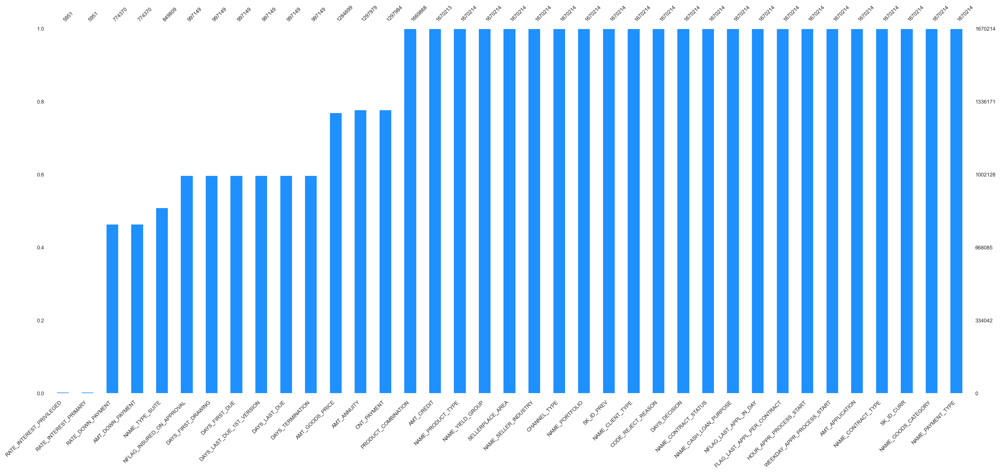

In [209]:
# Graph of the filling rate of the different variables
msno.bar(df_previous,
         color="dodgerblue",
         sort="ascending",
         fontsize=8)

There are many missing values.

<code style="background:lightyellow;color:black">Back to <a href="#C0">Table of contents</a></code>

### <div class="alert alert-block alert-info"><a name="C272">2.7.2. EDA</a></div>

In [210]:
# Drop columns with more than 20% of missing values
df_tmp_prev = remove_missing_columns(df_previous, threshold=20)
df_tmp_prev.shape

There are 14 columns with greater than 20% missing values.


(1670214, 23)

**Variable "NAME_CONTRACT_STATUS"**

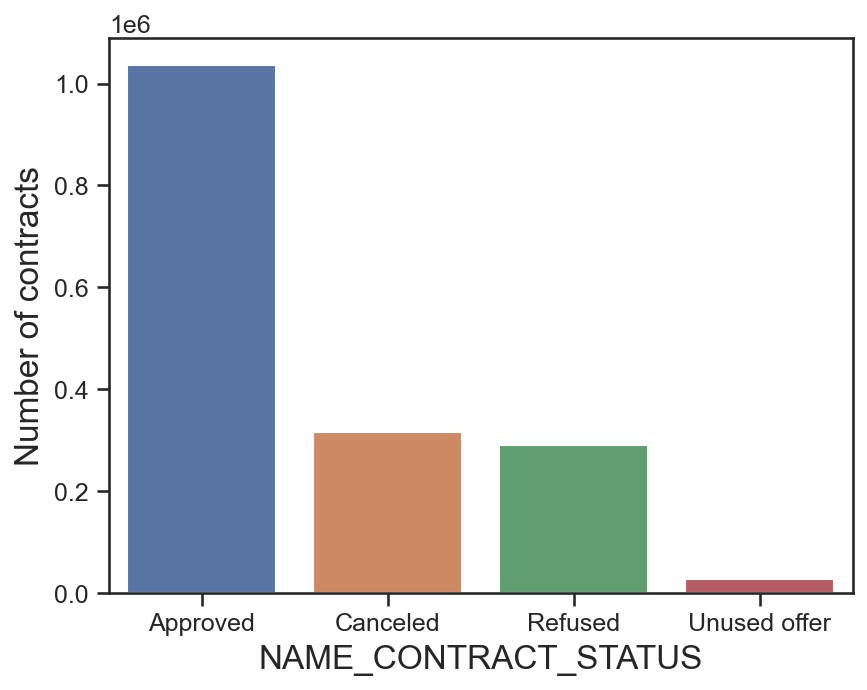

In [211]:
hist_distrib_cat_no_target(df_tmp_prev, "NAME_CONTRACT_STATUS")

**Variables "AMT_APPLICATION" and "AMT_CREDIT"**

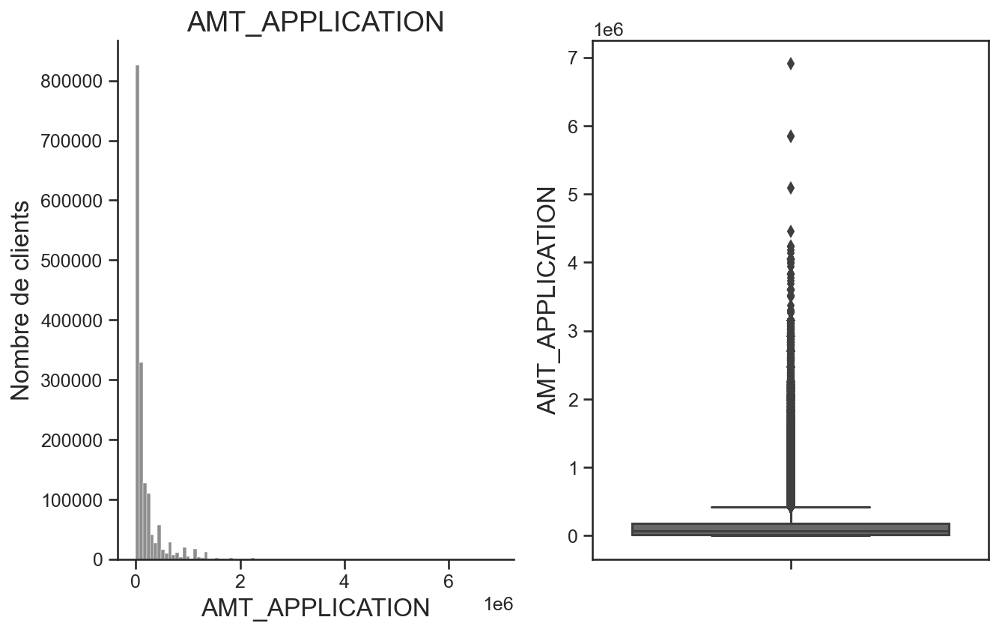

In [212]:
hist_distrib(df_tmp_prev, "AMT_APPLICATION")

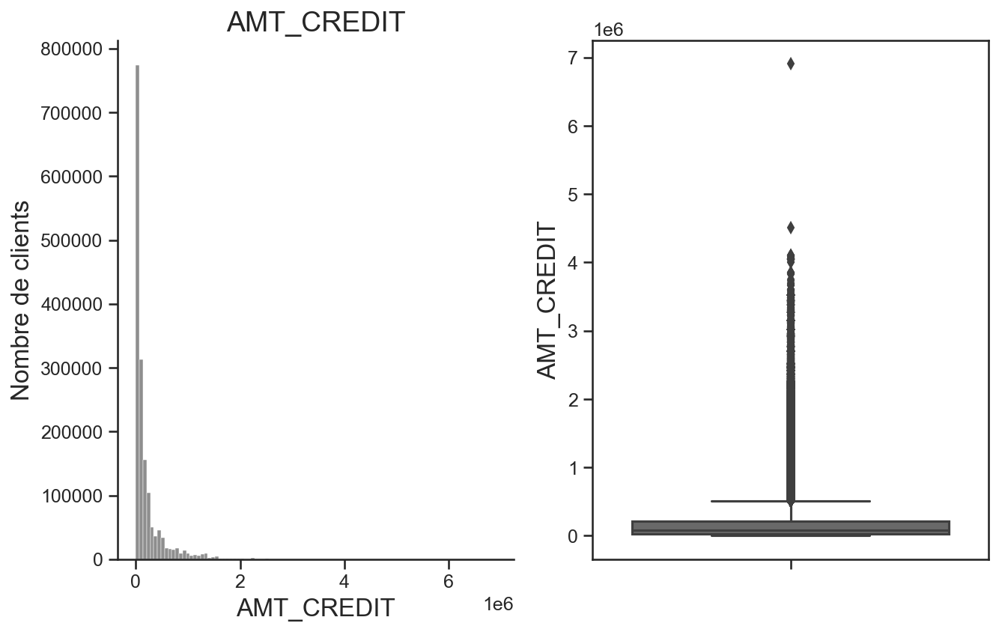

In [213]:
hist_distrib(df_tmp_prev, "AMT_CREDIT")

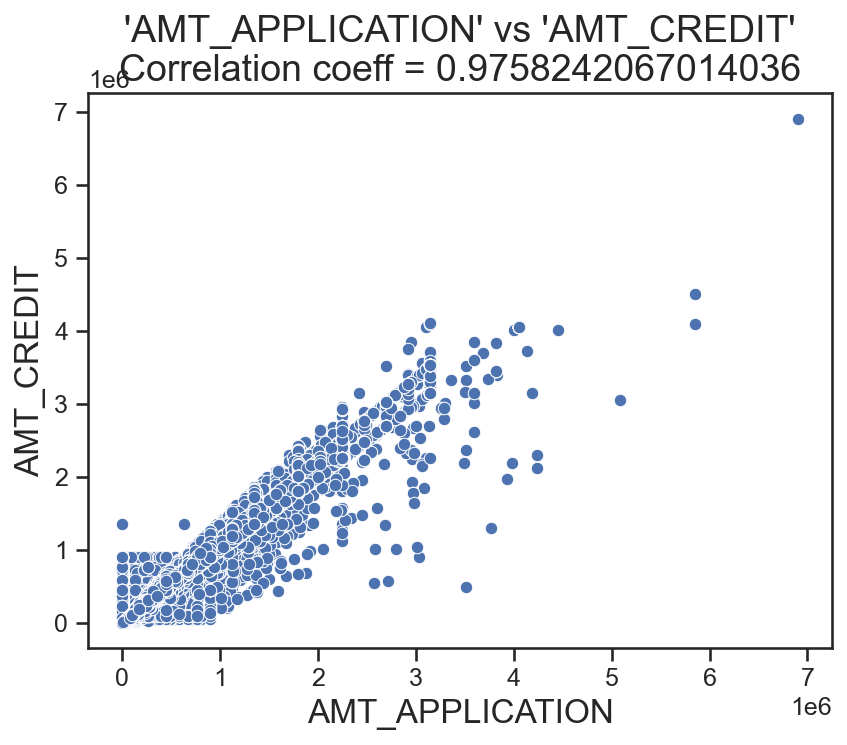

In [214]:
# Get the correlation coefficient with AMT_CREDIT
corr_coeff = df_tmp_prev["AMT_APPLICATION"].corr(df_tmp_prev["AMT_CREDIT"])

fig = plt.figure()
ax = plt.axes()
ax = sns.scatterplot(data=df_tmp_prev,
                     x="AMT_APPLICATION",
                     y="AMT_CREDIT")
ax.set_title("'AMT_APPLICATION' vs 'AMT_CREDIT'""\n"
             "Correlation coeff = {var}".format(var=corr_coeff))
plt.show()

In [215]:
# Fill missing values of AMT_CREDIT with AMT_APPLICATION
df_tmp_prev.loc[(df_tmp_prev["AMT_CREDIT"].isnull()),
                ["AMT_CREDIT"]] = df_tmp_prev["AMT_APPLICATION"]

<code style="background:lightyellow;color:black">Back to <a href="#C0">Table of contents</a></code>

### <div class="alert alert-block alert-info"><a name="C273">2.7.3. Feature engineering</a></div>

In [216]:
# Create variables with the number of previous application, their sum and mean amount
df_tmp_prev_g = df_tmp_prev.groupby(["SK_ID_CURR"]).agg({"SK_ID_PREV": "count",
                                                         "AMT_CREDIT": ("sum", "mean")
                                                         }).reset_index()

df_tmp_prev_g.columns = ["SK_ID_CURR",
                         "NB_PREVIOUS_APP_previous",
                         "SUM_AMT_PREVIOUS_previous",
                         "MEAN_AMT_PREVIOUS_previous"]
df_tmp_prev_g.head()

,SK_ID_CURR,NB_PREVIOUS_APP_previous,SUM_AMT_PREVIOUS_previous,MEAN_AMT_PREVIOUS_previous
0,100001,1,23787.0,23787.00
1,100002,1,179055.0,179055.00
2,100003,3,1452573.0,484191.00
3,100004,1,20106.0,20106.00
4,100005,2,40153.5,20076.75


Create variable for number of approved, canceled and refused application

In [217]:
# To get the number of active credit
df_tmp2 = df_tmp_prev.loc[df_tmp_prev["NAME_CONTRACT_STATUS"] == "Approved"]
df_tmp2 = df_tmp2.groupby(["SK_ID_CURR"]).agg({"NAME_CONTRACT_STATUS": "count"}).reset_index()
df_tmp2.columns = ["SK_ID_CURR", "NB_APPROVED_APP_previous"]
df_tmp2.head()

,SK_ID_CURR,NB_APPROVED_APP_previous
0,100001,1
1,100002,1
2,100003,3
3,100004,1
4,100005,1


In [218]:
# Merge with df_id_curr_gp
df_tmp_prev_g = df_tmp_prev_g.merge(df_tmp2, on="SK_ID_CURR", how="left")

In [219]:
# To get the number of refused credit
df_tmp3 = df_tmp_prev.loc[df_tmp_prev["NAME_CONTRACT_STATUS"] == "Refused"]
df_tmp3 = df_tmp3.groupby(["SK_ID_CURR"]).agg({"NAME_CONTRACT_STATUS": "count"}).reset_index()
df_tmp3.columns = ["SK_ID_CURR", "NB_REFUSED_APP_previous"]
df_tmp3.head()

,SK_ID_CURR,NB_REFUSED_APP_previous
0,100006,1
1,100011,1
2,100027,1
3,100030,10
4,100035,8


In [220]:
# Merge with df_id_curr_gp
df_tmp_prev_g = df_tmp_prev_g.merge(df_tmp3, on="SK_ID_CURR", how="left")

In [221]:
# To get the number of canceled credit
df_tmp4 = df_tmp_prev.loc[df_tmp_prev["NAME_CONTRACT_STATUS"] == "Canceled"]
df_tmp4 = df_tmp4.groupby(["SK_ID_CURR"]).agg({"NAME_CONTRACT_STATUS": "count"}).reset_index()
df_tmp4.columns = ["SK_ID_CURR", "NB_CANCELED_APP_previous"]
df_tmp4.head()

,SK_ID_CURR,NB_CANCELED_APP_previous
0,100005,1
1,100006,3
2,100008,1
3,100012,1
4,100013,1


In [222]:
# Merge with df_id_curr_gp
df_tmp_prev_g = df_tmp_prev_g.merge(df_tmp4, on="SK_ID_CURR", how="left")

In [223]:
missing_data(df_tmp_prev_g).head()

,Total,Percent
NB_REFUSED_APP_previous,220580,65.095306
NB_CANCELED_APP_previous,206163,60.840709
NB_APPROVED_APP_previous,1159,0.342032
SK_ID_CURR,0,0.000000
NB_PREVIOUS_APP_previous,0,0.000000


In [224]:
# Fill missing values with 0
df_tmp_prev_g = df_tmp_prev_g.fillna(0)

In [225]:
# Merge datasets
df_final = df_ap_bu_cc_ip_pc.merge(df_tmp_prev_g, on="SK_ID_CURR", how="left")

In [226]:
missing_data(df_final).head(10)

,Total,Percent
EXT_SOURCE_3,69632,19.545934
DAYS_EMPLOYED,64648,18.146909
DAYS_EMPLOYED_PERCENT,64648,18.146909
TARGET,48743,13.682322
AMT_REQ_CREDIT_BUREAU_QRT,47567,13.352215
AMT_REQ_CREDIT_BUREAU_HOUR,47567,13.352215
AMT_REQ_CREDIT_BUREAU_DAY,47567,13.352215
AMT_REQ_CREDIT_BUREAU_WEEK,47567,13.352215
AMT_REQ_CREDIT_BUREAU_MON,47567,13.352215
AMT_REQ_CREDIT_BUREAU_YEAR,47567,13.352215


In [227]:
# Fill missing value with 0 (except for target)
var_to_fill = df_tmp_prev_g.columns.tolist()
var_to_fill.remove("SK_ID_CURR")

for var in var_to_fill:
    df_final[var] = df_final[var].fillna(0)

In [228]:
missing_data(df_final).head(5)

,Total,Percent
EXT_SOURCE_3,69632,19.545934
DAYS_EMPLOYED_PERCENT,64648,18.146909
DAYS_EMPLOYED,64648,18.146909
TARGET,48743,13.682322
AMT_REQ_CREDIT_BUREAU_QRT,47567,13.352215


In [229]:
# Save the dataframe
df_final.to_csv(path_to_save + "df_final.csv", index=False)

<code style="background:lightyellow;color:black">Back to <a href="#C0">Table of contents</a></code>

## <div class="alert alert-block alert-info"><a name="C28">2.8. Correlation between "TARGET" and the other variables</a></div>


In order to understand the correlations between the variables and "TARGET", we will calculate the Pearson correlation coefficient. This coefficient can give us an idea of the possible relations between the variables.
Based on: http://www.statstutor.ac.uk/resources/uploaded/pearsons.pdf, it is possible to define different degrees of correlation:
- 0.00 to 0.19: "very low".
- 0.20 to 0.39: "weak".
- 0.40 to 0.59: "moderate
- 0.60 to 0.79: "strong
- 0.80 to 1.00: "very strong

In [230]:
# Calculate and sort the correlation coefficient
correlations = df_final.corr()["TARGET"].sort_values()

In [231]:
# Display the strongest positive correlations
print("Most positive correlations:\n", correlations.tail(15))

Most positive correlations:
 DAYS_REGISTRATION              0.041978
NB_ACTIVE_CREDIT_bureau        0.043572
FLAG_DOCUMENT_3                0.044338
REG_CITY_NOT_LIVE_CITY         0.044394
FLAG_EMP_PHONE                 0.045985
REG_CITY_NOT_WORK_CITY         0.050994
DAYS_ID_PUBLISH                0.051457
DAYS_LAST_PHONE_CHANGE         0.055220
REGION_RATING_CLIENT           0.058901
REGION_RATING_CLIENT_W_CITY    0.060895
NB_REFUSED_APP_previous        0.064773
DAYS_EMPLOYED                  0.074959
DAYS_BIRTH                     0.078244
TARGET                         1.000000
Test                                NaN
Name: TARGET, dtype: float64


In [232]:
# Display the strongest negative correlations
print("Most negative correlations:\n", correlations.head(15))

Most negative correlations:
 EXT_SOURCE_3                 -0.178926
EXT_SOURCE_2                 -0.160470
DAYS_EMPLOYED_PERCENT        -0.067954
AMT_GOODS_PRICE              -0.039647
NB_CLOSED_CREDIT_bureau      -0.037233
REGION_POPULATION_RELATIVE   -0.037225
CREDIT_TERM                  -0.032103
AMT_CREDIT                   -0.030371
FLAG_DOCUMENT_6              -0.028604
DAYS_INSTALMENT_delta        -0.025315
HOUR_APPR_PROCESS_START      -0.024162
FLAG_PHONE                   -0.023800
NB_APPROVED_APP_previous     -0.023520
MEAN_AMT_CREDIT_SUM_bureau   -0.022759
AMT_ANNUITY                  -0.012818
Name: TARGET, dtype: float64


<code style="background:lightyellow;color:black">Back to <a href="#C0">Table of contents</a></code>

# <div class="alert alert-block alert-info"><a name="C3">3. Modelisation</a></div>

# <div class="alert alert-block alert-info"><a name="C31">3.1. Preprocessing</a></div>

In [233]:
# Load the prepared dataframe
df_final = pd.read_csv(path_to_save + "df_final.csv")

# Keep only data from "application_train" dataset which specify "TARGET"
data = df_final[~df_final["Test"]]
data.to_csv(path_to_save + "df_application_train.csv", index=False)

# Delete "test" columns
data = data.drop(columns=["Test"], axis=1)

# Display dataframe shapes
print("Data consists of",
      data.shape[0], "raws and",
      data.shape[1], "columns.")

Data consists of 307505 raws and 93 columns.


In [234]:
data.head()

,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,...,NB_PREV_CREDIT_CC,DAYS_INSTALMENT_delay,DAYS_INSTALMENT_delta,NB_POS_CASH,NB_PREVIOUS_APP_previous,SUM_AMT_PREVIOUS_previous,MEAN_AMT_PREVIOUS_previous,NB_APPROVED_APP_previous,NB_REFUSED_APP_previous,NB_CANCELED_APP_previous
0,100002,1.0,Cash loans,M,N,Y,0,202500.0,406597.5,24700.5,...,0.0,-20.421053,0.0,19.0,1.0,179055.0,179055.00,1.0,0.0,0.0
1,100003,0.0,Cash loans,F,N,N,0,270000.0,1293502.5,35698.5,...,0.0,-7.000000,0.0,11.0,3.0,1452573.0,484191.00,3.0,0.0,0.0
2,100004,0.0,Revolving loans,M,Y,Y,0,67500.0,135000.0,6750.0,...,0.0,-3.000000,0.0,1.0,1.0,20106.0,20106.00,1.0,0.0,0.0
3,100006,0.0,Cash loans,F,N,Y,0,135000.0,312682.5,29686.5,...,6.0,-19.375000,0.0,21.0,9.0,2625259.5,291695.50,5.0,1.0,3.0
4,100007,0.0,Cash loans,M,N,Y,0,121500.0,513000.0,21865.5,...,0.0,-6.320000,0.0,27.0,6.0,999832.5,166638.75,6.0,0.0,0.0


**Separate X from the target**

In [235]:
data_to_pp = data.copy()
target = data_to_pp["TARGET"]
data_to_pp = data_to_pp.drop(["TARGET"], axis=1)
data_to_pp.shape

(307505, 92)

**Remove special character from the name columns to allow LGBM to work**

In [236]:
data_to_pp = data_to_pp.rename(columns=lambda x:
                               re.sub('[^A-Za-z0-9_]+', '', x))
data_to_pp.shape

(307505, 92)

<code style="background:lightyellow;color:black">Back to <a href="#C0">Table of contents</a></code>

## <div class="alert alert-block alert-info"><a name="C32">3.2. Preparation of training and testing set</a></div>

### <div class="alert alert-block alert-info"><a name="C321">3.2.1. Split the dataframe in training and testing set</a></div>

In [237]:
X_train, X_test, y_train, y_test = train_test_split(data_to_pp,
                                                    target,
                                                    train_size=0.8,
                                                    stratify=target,
                                                    random_state=42)

print("X_train shape:", X_train.shape,
      " / y_train shape:", y_train.shape)
print("X_test shape:", X_test.shape,
      " / y_test shape:", y_test.shape)

X_train shape: (246004, 92)  / y_train shape: (246004,)
X_test shape: (61501, 92)  / y_test shape: (61501,)


In [238]:
nb_total_train = y_train.shape[0]
nb_class_1_train = y_train.value_counts()[1]
proportion_class_1_train = (nb_class_1_train * 100) / nb_total_train
print("Proportion class 1 in training set:",
      proportion_class_1_train, "%")

nb_total_test = y_test.shape[0]
nb_class_1_test = y_test.value_counts()[1]
proportion_class_1_test = (nb_class_1_test * 100) / nb_total_test
print("Proportion class 1 in test set:",
      proportion_class_1_test, "%")

Proportion class 1 in training set: 8.073039462772963 %
Proportion class 1 in test set: 8.073039462772963 %


In [239]:
# Save X_train
X_train.to_csv(path_to_save + "X_train.csv", index=False)
X_test.to_csv(path_to_save + "X_test.csv", index=False)

In [240]:
# Delete "test" columns
X_train = X_train.drop(columns=["SK_ID_CURR"], axis=1)
X_test = X_test.drop(columns=["SK_ID_CURR"], axis=1)

<code style="background:lightyellow;color:black">Back to <a href="#C0">Table of contents</a></code>

### <div class="alert alert-block alert-info"><a name="C322">3.2.2. Encoding categorical features</a></div>

When categorical features have 2 classes, we want to use the label encoder from scikit-learn.
When there are more than 2 classes, we want to use the one hot encoder from pandas function: get_dummies()

In [241]:
# Create a list with the name of the categorical variables
cat_variables = list(X_train.dtypes[X_train.dtypes == object].index)
X_train_cat = X_train[cat_variables]
X_test_cat = X_test[cat_variables]
X_train_cat.shape

(246004, 13)

In [242]:
print("Missing_values X_train_cat =", missing_data(X_train_cat).head(3))
print("")
print("Missing_values X_test_cat =", missing_data(X_test_cat).head(3))

Missing_values X_train_cat =                     Total  Percent
NAME_CONTRACT_TYPE      0      0.0
CODE_GENDER             0      0.0
FLAG_OWN_CAR            0      0.0

Missing_values X_test_cat =                     Total  Percent
NAME_CONTRACT_TYPE      0      0.0
CODE_GENDER             0      0.0
FLAG_OWN_CAR            0      0.0


There is no missing values for the categorical variables.

In [243]:
# Create a label encoder object
le = LabelEncoder()
count_le = 0

# Iterate through the columns
for col in X_train_cat:
    nb_categories = len(list(X_train_cat.loc[:, col].unique()))
    # If 2 or fewer unique categories
    if nb_categories <= 2:
        # Train on the training data
        le.fit(X_train_cat.loc[:, col])
        # Transform both training and testing data
        value_train = le.transform(X_train_cat.loc[:, col])
        X_train_cat.loc[:, col] = value_train
        value_test = le.transform(X_test_cat.loc[:, col])
        X_test_cat.loc[:, col] = value_test
        count_le += 1

print('%d columns were label encoded.' % count_le)


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


6 columns were label encoded.


In [244]:
# One-hot encoding for categorical variables with more than 2 classes
X_train_cat = pd.get_dummies(X_train_cat)
X_test_cat = pd.get_dummies(X_test_cat)

print("Shape of X_train_cat:", X_train_cat.shape)
print("shape of X_test_cat:", X_test_cat.shape)

Shape of X_train_cat: (246004, 52)
shape of X_test_cat: (61501, 52)


In [245]:
# Align data_train and data_test
X_train_cat, X_test_cat = X_train_cat.align(X_test_cat,
                                            join="inner",
                                            axis=1)

<code style="background:lightyellow;color:black">Back to <a href="#C0">Table of contents</a></code>

### <div class="alert alert-block alert-info"><a name="C323">3.2.3. Numerical variables: imputation of the missing values</a></div>

In [246]:
print('Missing values in X_train: ', sum(X_train.isnull().sum()))
print('Missing values in X_test: ', sum(X_test.isnull().sum()))

Missing values in X_train:  338961
Missing values in X_test:  86916


In [247]:
# Create a list with the name of numerical variables
float_variables = list(X_train.dtypes[X_train.dtypes == float].index)
int_variables = list(X_train.dtypes[X_train.dtypes == 'int64'].index)
num_variables = float_variables + int_variables

# Selection data that to be standardized
X_train_num = X_train[num_variables]
X_test_num = X_test[num_variables]
X_train_num.shape

(246004, 78)

In [248]:
imputer = SimpleImputer(strategy='median')
imputer.fit(X_train_num)
X_train_num_i = imputer.transform(X_train_num)
X_test_num_i = imputer.transform(X_test_num)

<code style="background:lightyellow;color:black">Back to <a href="#C0">Table of contents</a></code>

### <div class="alert alert-block alert-info"><a name="C324">3.2.4. Numerical variables: standardization</a></div>

In [249]:
scaler = StandardScaler()
scaler.fit(X_train_num_i)
X_train_num_scaled = scaler.transform(X_train_num_i)
X_test_num_scaled = scaler.transform(X_test_num_i)

In [250]:
# Transform back to pandas Dataframe
X_train_num_scaled = pd.DataFrame(X_train_num_scaled,
                                  index=X_train_num.index,
                                  columns=X_train_num.columns)
X_test_num_scaled = pd.DataFrame(X_test_num_scaled,
                                 index=X_test_num.index,
                                 columns=X_test_num.columns)
X_train_num_scaled.head()

,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,REGION_POPULATION_RELATIVE,DAYS_EMPLOYED,DAYS_REGISTRATION,CNT_FAM_MEMBERS,EXT_SOURCE_2,EXT_SOURCE_3,...,FLAG_DOCUMENT_12,FLAG_DOCUMENT_13,FLAG_DOCUMENT_14,FLAG_DOCUMENT_15,FLAG_DOCUMENT_16,FLAG_DOCUMENT_17,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21
234860,-0.216940,-1.153796,-1.009700,-1.153733,0.754696,0.958885,1.151713,-1.264744,0.204704,0.112960,...,-0.002851,-0.05978,-0.054104,-0.034176,-0.100441,-0.015488,-0.09074,-0.024783,-0.022637,-0.018917
50832,0.041953,0.477787,0.927171,0.246573,-0.045038,-1.760423,0.210722,0.927994,-0.371825,0.112960,...,-0.002851,-0.05978,-0.054104,-0.034176,-0.100441,-0.015488,-0.09074,-0.024783,-0.022637,-0.018917
223594,-0.389536,-1.097395,-1.328116,-1.031967,-0.127660,0.305745,0.746647,-0.168375,-0.189825,0.112960,...,-0.002851,-0.05978,-0.054104,-0.034176,-0.100441,-0.015488,-0.09074,-0.024783,-0.022637,-0.018917
307008,0.214549,1.709287,0.735687,1.585996,3.726114,0.576365,1.312377,-0.168375,1.201870,0.457134,...,-0.002851,-0.05978,-0.054104,-0.034176,-0.100441,-0.015488,-0.09074,-0.024783,-0.022637,-0.018917
152056,-0.130642,0.585051,0.909481,0.368339,1.829209,-1.052972,-0.079666,0.927994,1.171916,0.633556,...,-0.002851,-0.05978,-0.054104,-0.034176,-0.100441,-0.015488,-0.09074,-0.024783,-0.022637,-0.018917


<code style="background:lightyellow;color:black">Back to <a href="#C0">Table of contents</a></code>

### <div class="alert alert-block alert-info"><a name="C325">3.2.5. Put back together the categorical and numerical variables</a></div>

In [251]:
X_train_scaled = X_train_cat.merge(X_train_num_scaled,
                                   right_index=True,
                                   left_index=True)

X_test_scaled = X_test_cat.merge(X_test_num_scaled,
                                 right_index=True,
                                 left_index=True)

In [252]:
# Save the data
target.to_csv(path_to_save + "df_target.csv", index=False)
X_train_scaled.to_csv(path_to_save + "X_train_scaled.csv", index=False)
X_test_scaled.to_csv(path_to_save + "X_test_scaled.csv", index=False)
y_train.to_csv(path_to_save + "y_train.csv", index=False)
y_test.to_csv(path_to_save + "y_test.csv", index=False)

<code style="background:lightyellow;color:black">Back to <a href="#C0">Table of contents</a></code>

## <div class="alert alert-block alert-info"><a name="C33">3.3. Handling imbalanced dataset</a></div>

### <div class="alert alert-block alert-info"><a name="C331">3.3.1. Training set using random undersampling</a></div>

In [253]:
under = RandomUnderSampler()
X_train_under, y_train_under = under.fit_resample(X_train_scaled, y_train)
print(X_train_under.shape)
print(y_train_under.shape)

(39720, 130)
(39720,)


In [254]:
y_train_under.value_counts()

0.0    19860
1.0    19860
Name: TARGET, dtype: int64

<code style="background:lightyellow;color:black">Back to <a href="#C0">Table of contents</a></code>

### <div class="alert alert-block alert-info"><a name="C332">3.3.2. Training set using SMOTE oversampling</a></div>

In [255]:
smote = SMOTE()
X_train_smote, y_train_smote = smote.fit_resample(X_train_scaled, y_train)
print(X_train_smote.shape)
print(y_train_smote.shape)

(452288, 130)
(452288,)


In [256]:
y_train_smote.value_counts()

0.0    226144
1.0    226144
Name: TARGET, dtype: int64

<code style="background:lightyellow;color:black">Back to <a href="#C0">Table of contents</a></code>

### <div class="alert alert-block alert-info"><a name="C333">3.3.3. Training set using SMOTE+Tomek links sampling</a></div>

In [257]:
smotetomek = SMOTETomek()
X_train_smotetomek, y_train_smotetomek = smotetomek.fit_resample(X_train_scaled,
                                                                 y_train)
print(X_train_smotetomek.shape)
print(y_train_smotetomek.shape)

(452282, 130)
(452282,)


In [258]:
y_train_smotetomek.value_counts()

0.0    226141
1.0    226141
Name: TARGET, dtype: int64

<code style="background:lightyellow;color:black">Back to <a href="#C0">Table of contents</a></code>

## <div class="alert alert-block alert-info"><a name="C34">3.4. Test of 4 algorithms</a></div>

In [259]:
# Create a list with dataset to train the algorithm
data_to_train = [X_train_scaled, X_train_under,
                 X_train_smote, X_train_smotetomek]

name_to_train = ["Unbalanced", "Under", "SMOTE", "SMOTETomek"]

# Create a list with the corresponding target
y_to_train = [y_train, y_train_under, y_train_smote, y_train_smotetomek]

In [260]:
# Create a dataframe to save model informations
results = pd.DataFrame(index=["Best_params",
                              "Train_Accuracy",
                              "Test_Accuracy",
                              "AUC",
                              "Precision",
                              "Recall",
                              "f1 score",
                              "fbeta score",
                              "Time"])

In [261]:
def get_scores(best_params, y_test, pred, proba, accuracy, t0=0, t1=0):
    """function to return scores obtained following the training of the algorithm""" 
    return [best_params,
            accuracy,                           # Train_accuracy
            accuracy_score(y_test, pred),       # Test_accuracy
            roc_auc_score(y_test, proba),       # AUC
            precision_score(y_test, pred),      # Precision
            recall_score(y_test, pred),         # Recall
            f1_score(y_test, pred),             # f1 score
            fbeta_score(y_test, pred, beta=2),  # fbeta score
            (t1 - t0)]                            # "time"

In [262]:
def compare_models(X_train, X_test, y_train, y_test, df, suffix):
    """Function to train different algorithms et get their performances"""
    t0 = time.time()
    # Dummy classifier
    print(" Dummy classifier")
    dc = DummyClassifier(strategy="most_frequent")
    dc.fit(X_train, y_train)
    best_params_dc = "N/A"
    acc_dc = dc.score(X_train, y_train)
    pred_dc = dc.predict(X_test)
    proba_dc = dc.predict_proba(X_test)[:, 1]
    t1 = time.time()

    # Logistic regression
    print(" Logistic regression")
    lr = LogisticRegression(max_iter=1000, random_state=42)

    params = {
             'penalty': ['none', 'l2'],
             'C': [0.01, 0.1, 1, 10]
             }

    gs_lr = GridSearchCV(
                        lr,
                        param_grid=params,
                        scoring="roc_auc",
                        cv=5,
                        return_train_score=True,
                        n_jobs=-1,
                        refit=True
                        )

    gs_lr.fit(X_train, y_train)
    best_params_lr = gs_lr.best_params_
    acc_lr = gs_lr.best_score_
    pred_lr = gs_lr.predict(X_test)
    proba_lr = gs_lr.predict_proba(X_test)[:, 1]
    t2 = time.time()

    # Random forest
    print(" Random forest")
    rf = RandomForestClassifier(class_weight=None, random_state=42)
    params = {'n_estimators': [100, 200],
              'max_depth': [5, 10]
             }

    gs_rf = GridSearchCV(
                         rf,
                         param_grid=params,
                         scoring="roc_auc",
                         cv=5,
                         return_train_score=True,
                         n_jobs=-1,
                         refit=True
                        )
    gs_rf.fit(X_train, y_train)
    best_params_rf = gs_rf.best_params_
    acc_rf = gs_rf.best_score_
    pred_rf = gs_rf.predict(X_test)
    proba_rf = gs_rf.predict_proba(X_test)[:, 1]
    t3 = time.time()

    # Adaboost
    print(" Adaboost")
    ad = AdaBoostClassifier(random_state=42)
    params = {'n_estimators': [50, 500],
              'learning_rate': [0.001, 0.01,]
             }

    gs_ad = GridSearchCV(
                         ad,
                         param_grid=params,
                         scoring="roc_auc",
                         cv=5,
                         return_train_score=True,
                         n_jobs=-1,
                         refit=True
                        )
    gs_ad.fit(X_train, y_train)
    best_params_ad = gs_ad.best_params_
    acc_ad = gs_ad.best_score_
    pred_ad = gs_ad.predict(X_test)
    proba_ad = gs_ad.predict_proba(X_test)[:, 1]
    t4 = time.time()

    # light GBM
    print(" Light GBM")
    lgbm = LGBMClassifier(objective="binary", random_state=42)
    lgbm.fit(X_train, y_train)
    best_params_lgbm = "default values"
    acc_lgbm = lgbm.score(X_train, y_train)
    pred_lgbm = lgbm.predict(X_test)
    proba_lgbm = lgbm.predict_proba(X_test)[:, 1]
    t5 = time.time()

    df['DC_' + suffix] = get_scores(best_params_dc, y_test, pred_dc, proba_dc, acc_dc, t0, t1)
    df['LR_' + suffix] = get_scores(best_params_lr, y_test, pred_lr, proba_lr, acc_lr, t1, t2)
    df['RF_' + suffix] = get_scores(best_params_rf, y_test, pred_rf, proba_rf, acc_rf, t2, t3)
    df['AdaB_' + suffix] = get_scores(best_params_ad, y_test, pred_ad, proba_ad, acc_ad, t3, t4)
    df['LGBM_' + suffix] = get_scores(best_params_lgbm, y_test, pred_lgbm, proba_lgbm, acc_lgbm, t4, t5)

    return round(df, 3)

In [263]:
for i in range(len(data_to_train)):
    print(name_to_train[i])
    X_train_comp = data_to_train[i]
    y_train_comp = y_to_train[i]
    X_test = X_test_scaled
    y_test = y_test

    results = compare_models(X_train_comp,
                             X_test,
                             y_train_comp,
                             y_test,
                             results,
                             name_to_train[i])

results

Unbalanced
 Dummy classifier
 Logistic regression
 Random forest
 Adaboost
 Light GBM


Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.


Under
 Dummy classifier
 Logistic regression
 Random forest
 Adaboost
 Light GBM


Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.


SMOTE
 Dummy classifier
 Logistic regression
 Random forest
 Adaboost
 Light GBM


Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.


SMOTETomek
 Dummy classifier
 Logistic regression
 Random forest
 Adaboost
 Light GBM


Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.


,DC_Unbalanced,LR_Unbalanced,RF_Unbalanced,AdaB_Unbalanced,LGBM_Unbalanced,DC_Under,LR_Under,RF_Under,AdaB_Under,LGBM_Under,DC_SMOTE,LR_SMOTE,RF_SMOTE,AdaB_SMOTE,LGBM_SMOTE,DC_SMOTETomek,LR_SMOTETomek,RF_SMOTETomek,AdaB_SMOTETomek,LGBM_SMOTETomek
Best_params,N/A,"{'C': 1, 'penalty': 'l2'}","{'max_depth': 10, 'n_estimators': 200}","{'learning_rate': 0.01, 'n_estimators': 500}",default values,N/A,"{'C': 0.1, 'penalty': 'l2'}","{'max_depth': 10, 'n_estimators': 200}","{'learning_rate': 0.01, 'n_estimators': 500}",default values,N/A,"{'C': 0.01, 'penalty': 'l2'}","{'max_depth': 10, 'n_estimators': 200}","{'learning_rate': 0.01, 'n_estimators': 500}",default values,N/A,"{'C': 0.01, 'penalty': 'l2'}","{'max_depth': 10, 'n_estimators': 200}","{'learning_rate': 0.01, 'n_estimators': 500}",default values
Train_Accuracy,0.91927,0.748863,0.745816,0.725143,0.920745,0.5,0.746832,0.747366,0.72313,0.746425,0.5,0.966847,0.960799,0.889538,0.955699,0.5,0.966764,0.960875,0.889284,0.955718
Test_Accuracy,0.91927,0.919335,0.91927,0.91927,0.919936,0.91927,0.691436,0.687241,0.681469,0.699029,0.91927,0.917595,0.863303,0.764524,0.919822,0.91927,0.917644,0.864376,0.766801,0.919497
AUC,0.5,0.753107,0.747568,0.72608,0.769271,0.5,0.751913,0.751477,0.725764,0.768454,0.5,0.731304,0.701443,0.675872,0.762221,0.5,0.731049,0.701163,0.677028,0.761442
Precision,0.0,0.514493,0.0,0.0,0.59276,0.0,0.163529,0.162265,0.153682,0.16965,0.0,0.388769,0.204701,0.155556,0.598837,0.0,0.394515,0.203339,0.156545,0.538889
Recall,0.0,0.0143,0.0,0.0,0.026385,0.0,0.685801,0.690433,0.653575,0.700504,0.0,0.036254,0.240282,0.43283,0.020745,0.0,0.037664,0.233031,0.430413,0.019537
f1 score,0.0,0.027827,0.0,0.0,0.050521,0.0,0.264087,0.262773,0.24885,0.273149,0.0,0.066323,0.221069,0.22886,0.040101,0.0,0.068763,0.217175,0.229587,0.037707
fbeta score,0.0,0.017752,0.0,0.0,0.032618,0.0,0.41849,0.418192,0.395973,0.430861,0.0,0.044285,0.23221,0.319079,0.025709,0.0,0.045982,0.226419,0.318851,0.024202
Time,0.111011,427.466317,692.162657,3744.496081,7.380083,0.012998,89.173889,127.617085,548.262123,1.938778,0.672861,1790.63287,2122.412938,9283.297411,18.005326,0.096039,2449.18294,1667.657254,9024.824018,13.573953


**Using class weight**

In [264]:
def compare_models_weight(X_train, X_test, y_train, y_test, df, suffix):

    weights = class_weight.compute_sample_weight(class_weight='balanced',
                                                 y=y_train)

    t0 = time.time()

    # Logistic regression
    print(" Logistic regression")
    lr = LogisticRegression(class_weight='balanced', max_iter=1000, random_state=42)
    lr.fit(X_train, y_train)
    best_params_lr = "default values"
    acc_lr = lr.score(X_train, y_train)
    pred_lr = lr.predict(X_test)
    proba_lr = lr.predict_proba(X_test)[:, 1]
    t1 = time.time()

    # Random forest
    print(" Random forest")
    rf = RandomForestClassifier(class_weight='balanced', random_state=42)
    rf.fit(X_train, y_train)
    best_params_rf = "default values"
    acc_rf = rf.score(X_train, y_train)
    pred_rf = rf.predict(X_test)
    proba_rf = rf.predict_proba(X_test)[:, 1]
    t2 = time.time()

    # light GBM
    print(" Light GBM")
    lgbm = LGBMClassifier(class_weight='balanced', objective="binary", random_state=42)
    params = {
              'n_estimators': [500, 1000],
              'learning_rate': [0.01, 0.05]
              }

    gs_lgbm = GridSearchCV(
                            lgbm,
                            param_grid=params,
                            scoring="roc_auc",
                            cv=5,
                            return_train_score=True,
                            n_jobs=-1
                            )

    gs_lgbm.fit(X_train, y_train)
    best_params_lgbm = gs_lgbm.best_params_
    acc_lgbm = gs_lgbm.best_score_
    pred_lgbm = gs_lgbm.predict(X_test)
    proba_lgbm = gs_lgbm.predict_proba(X_test)[:, 1]
    t3 = time.time()

    df['LR_' + suffix] = get_scores(best_params_lr, y_test, pred_lr, proba_lr, acc_lr, t0, t1)
    df['RF_' + suffix] = get_scores(best_params_rf, y_test, pred_rf, proba_rf, acc_rf, t1, t2)
    df['LGBM_' + suffix] = get_scores(best_params_lgbm, y_test, pred_lgbm, proba_lgbm,
                                      acc_lgbm, t2, t3)

    return round(df, 3)

In [265]:
results = compare_models_weight(X_train_scaled,
                                X_test_scaled,
                                y_train,
                                y_test,
                                results,
                                "weight")

results

 Logistic regression
 Random forest
 Light GBM


,DC_Unbalanced,LR_Unbalanced,RF_Unbalanced,AdaB_Unbalanced,LGBM_Unbalanced,DC_Under,LR_Under,RF_Under,AdaB_Under,LGBM_Under,...,AdaB_SMOTE,LGBM_SMOTE,DC_SMOTETomek,LR_SMOTETomek,RF_SMOTETomek,AdaB_SMOTETomek,LGBM_SMOTETomek,LR_weight,RF_weight,LGBM_weight
Best_params,N/A,"{'C': 1, 'penalty': 'l2'}","{'max_depth': 10, 'n_estimators': 200}","{'learning_rate': 0.01, 'n_estimators': 500}",default values,N/A,"{'C': 0.1, 'penalty': 'l2'}","{'max_depth': 10, 'n_estimators': 200}","{'learning_rate': 0.01, 'n_estimators': 500}",default values,...,"{'learning_rate': 0.01, 'n_estimators': 500}",default values,N/A,"{'C': 0.01, 'penalty': 'l2'}","{'max_depth': 10, 'n_estimators': 200}","{'learning_rate': 0.01, 'n_estimators': 500}",default values,default values,default values,"{'learning_rate': 0.01, 'n_estimators': 1000}"
Train_Accuracy,0.91927,0.748863,0.745816,0.725143,0.920745,0.5,0.746832,0.747366,0.72313,0.746425,...,0.889538,0.955699,0.5,0.966764,0.960875,0.889284,0.955718,0.69033,0.999935,0.767149
Test_Accuracy,0.91927,0.919335,0.91927,0.91927,0.919936,0.91927,0.691436,0.687241,0.681469,0.699029,...,0.764524,0.919822,0.91927,0.917644,0.864376,0.766801,0.919497,0.693176,0.919286,0.712086
AUC,0.5,0.753107,0.747568,0.72608,0.769271,0.5,0.751913,0.751477,0.725764,0.768454,...,0.675872,0.762221,0.5,0.731049,0.701163,0.677028,0.761442,0.752921,0.734636,0.772132
Precision,0.0,0.514493,0.0,0.0,0.59276,0.0,0.163529,0.162265,0.153682,0.16965,...,0.155556,0.598837,0.0,0.394515,0.203339,0.156545,0.538889,0.163822,0.555556,0.175247
Recall,0.0,0.0143,0.0,0.0,0.026385,0.0,0.685801,0.690433,0.653575,0.700504,...,0.43283,0.020745,0.0,0.037664,0.233031,0.430413,0.019537,0.682377,0.001007,0.692447
f1 score,0.0,0.027827,0.0,0.0,0.050521,0.0,0.264087,0.262773,0.24885,0.273149,...,0.22886,0.040101,0.0,0.068763,0.217175,0.229587,0.037707,0.264213,0.00201,0.279705
fbeta score,0.0,0.017752,0.0,0.0,0.032618,0.0,0.41849,0.418192,0.395973,0.430861,...,0.319079,0.025709,0.0,0.045982,0.226419,0.318851,0.024202,0.417849,0.001258,0.435432
Time,0.111011,427.466317,692.162657,3744.496081,7.380083,0.012998,89.173889,127.617085,548.262123,1.938778,...,9283.297411,18.005326,0.096039,2449.18294,1667.657254,9024.824018,13.573953,21.523176,527.347816,26901.447358


In [266]:
# To save the results dataframe
results.to_csv(path_to_save + "results_algo_comparison.csv")

<code style="background:lightyellow;color:black">Back to <a href="#C0">Table of contents</a></code>

# <div class="alert alert-block alert-info"><a name="C4">4. Selection and optimization of most performant algorithm</a></div>

## <div class="alert alert-block alert-info"><a name="C41">4.1. Selection of most performant algorithm</a></div>

In [267]:
results

,DC_Unbalanced,LR_Unbalanced,RF_Unbalanced,AdaB_Unbalanced,LGBM_Unbalanced,DC_Under,LR_Under,RF_Under,AdaB_Under,LGBM_Under,...,AdaB_SMOTE,LGBM_SMOTE,DC_SMOTETomek,LR_SMOTETomek,RF_SMOTETomek,AdaB_SMOTETomek,LGBM_SMOTETomek,LR_weight,RF_weight,LGBM_weight
Best_params,N/A,"{'C': 1, 'penalty': 'l2'}","{'max_depth': 10, 'n_estimators': 200}","{'learning_rate': 0.01, 'n_estimators': 500}",default values,N/A,"{'C': 0.1, 'penalty': 'l2'}","{'max_depth': 10, 'n_estimators': 200}","{'learning_rate': 0.01, 'n_estimators': 500}",default values,...,"{'learning_rate': 0.01, 'n_estimators': 500}",default values,N/A,"{'C': 0.01, 'penalty': 'l2'}","{'max_depth': 10, 'n_estimators': 200}","{'learning_rate': 0.01, 'n_estimators': 500}",default values,default values,default values,"{'learning_rate': 0.01, 'n_estimators': 1000}"
Train_Accuracy,0.91927,0.748863,0.745816,0.725143,0.920745,0.5,0.746832,0.747366,0.72313,0.746425,...,0.889538,0.955699,0.5,0.966764,0.960875,0.889284,0.955718,0.69033,0.999935,0.767149
Test_Accuracy,0.91927,0.919335,0.91927,0.91927,0.919936,0.91927,0.691436,0.687241,0.681469,0.699029,...,0.764524,0.919822,0.91927,0.917644,0.864376,0.766801,0.919497,0.693176,0.919286,0.712086
AUC,0.5,0.753107,0.747568,0.72608,0.769271,0.5,0.751913,0.751477,0.725764,0.768454,...,0.675872,0.762221,0.5,0.731049,0.701163,0.677028,0.761442,0.752921,0.734636,0.772132
Precision,0.0,0.514493,0.0,0.0,0.59276,0.0,0.163529,0.162265,0.153682,0.16965,...,0.155556,0.598837,0.0,0.394515,0.203339,0.156545,0.538889,0.163822,0.555556,0.175247
Recall,0.0,0.0143,0.0,0.0,0.026385,0.0,0.685801,0.690433,0.653575,0.700504,...,0.43283,0.020745,0.0,0.037664,0.233031,0.430413,0.019537,0.682377,0.001007,0.692447
f1 score,0.0,0.027827,0.0,0.0,0.050521,0.0,0.264087,0.262773,0.24885,0.273149,...,0.22886,0.040101,0.0,0.068763,0.217175,0.229587,0.037707,0.264213,0.00201,0.279705
fbeta score,0.0,0.017752,0.0,0.0,0.032618,0.0,0.41849,0.418192,0.395973,0.430861,...,0.319079,0.025709,0.0,0.045982,0.226419,0.318851,0.024202,0.417849,0.001258,0.435432
Time,0.111011,427.466317,692.162657,3744.496081,7.380083,0.012998,89.173889,127.617085,548.262123,1.938778,...,9283.297411,18.005326,0.096039,2449.18294,1667.657254,9024.824018,13.573953,21.523176,527.347816,26901.447358


In [268]:
results_selec = results.drop(["Best_params"], axis=0)
best_models = results_selec.T.sort_values(by="AUC", ascending=False).head(5)
best_models.style.highlight_max(axis=0)

,Train_Accuracy,Test_Accuracy,AUC,Precision,Recall,f1 score,fbeta score,Time
LGBM_weight,0.767149,0.712086,0.772132,0.175247,0.692447,0.279705,0.435432,26901.447358
LGBM_Unbalanced,0.920745,0.919936,0.769271,0.592760,0.026385,0.050521,0.032618,7.380083
LGBM_Under,0.746425,0.699029,0.768454,0.169650,0.700504,0.273149,0.430861,1.938778
LGBM_SMOTE,0.955699,0.919822,0.762221,0.598837,0.020745,0.040101,0.025709,18.005326
LGBM_SMOTETomek,0.955718,0.919497,0.761442,0.538889,0.019537,0.037707,0.024202,13.573953


The model which obtains the best performance is the Light GBM using the weight strategy to balance the data set.

<code style="background:lightyellow;color:black">Back to <a href="#C0">Table of contents</a></code>

## <div class="alert alert-block alert-info"><a name="C42">4.2. Model optimization and visualization</a></div>

### <div class="alert alert-block alert-info"><a name="C421">4.2.1. Hyperparameter optimization</a></div>


In [269]:
space = {'n_estimators': scope.int(hp.quniform('n_estimators',
                                               200, 2000, 200)),
         'max_depth': scope.int(hp.quniform('max_depth',
                                            2, 30, 2)),
         'learning_rate': hp.loguniform('learning_rate',
                                        np.log(0.005), np.log(0.2)),
         'subsample': hp.quniform('subsample',
                                  0.1, 1.0, 0.2),
         'colsample_bytree': hp.quniform('colsample_by_tree',
                                         0.6, 1.0, 0.1),
         'num_leaves': scope.int(hp.quniform('num_leaves',
                                             4, 100, 4)),
         'reg_alpha': hp.quniform('reg_alpha',
                                  0.1, 1.0, 0.1),
         'reg_lambda': hp.quniform('reg_lambda',
                                   0.1, 1.0, 0.1)}

In [270]:
def hyperparameter_tuning(params):
    weights = class_weight.compute_sample_weight(class_weight='balanced',
                                                 y=y_train)

    clf = LGBMClassifier(**params,
                         class_weight='balanced',
                         n_jobs=-1,
                         random_state=42)
    score = cross_val_score(clf,
                            X_train_scaled,
                            y_train,
                            scoring="roc_auc",
                            cv=7,
                            error_score='raise').mean()
    return {"loss": -score, "status": STATUS_OK}

In [271]:
trials = Trials()

best = fmin(fn=hyperparameter_tuning,
            space=space,
            algo=tpe.suggest,
            max_evals=10,
            trials=trials)

print("Best: {}".format(best))

100%|██████████| 10/10 [39:19<00:00, 235.92s/trial, best loss: -0.7697336192320626]
Best: {'colsample_by_tree': 0.6000000000000001, 'learning_rate': 0.0059460188068634675, 'max_depth': 16.0, 'n_estimators': 2000.0, 'num_leaves': 40.0, 'reg_alpha': 0.6000000000000001, 'reg_lambda': 0.8, 'subsample': 0.6000000000000001}


In [276]:
# best params roc_auc
model = LGBMClassifier(n_estimators=2000,
                       max_depth=16,
                       learning_rate=0.006,
                       subsample=0.6,
                       colsample_bytree=0.6,
                       num_leaves=40,
                       reg_alpha=0.6,
                       reg_lambda=0.8,
                       class_weight='balanced')

In [277]:
X_train_scaled = pd.read_csv(path_to_save + "X_train_scaled.csv")
X_test_scaled = pd.read_csv(path_to_save + "X_test_scaled.csv")
y_train = pd.read_csv(path_to_save + "y_train.csv")
y_train = y_train["TARGET"]
y_test = pd.read_csv(path_to_save + "y_test.csv")
y_test = y_test["TARGET"]

In [278]:
t0 = time.time()
model.fit(X_train_scaled, y_train)
accuracy = model.score(X_train_scaled, y_train)
pred = model.predict(X_test_scaled)
proba = model.predict_proba(X_test_scaled)[:, 1]
t1 = time.time()
best_params = best
results['hyperopt_roc'] = get_scores(best_params, y_test, pred, proba, accuracy, t0, t1)
round(results, 3)

,DC_Unbalanced,LR_Unbalanced,RF_Unbalanced,AdaB_Unbalanced,LGBM_Unbalanced,DC_Under,LR_Under,RF_Under,AdaB_Under,LGBM_Under,...,LGBM_SMOTE,DC_SMOTETomek,LR_SMOTETomek,RF_SMOTETomek,AdaB_SMOTETomek,LGBM_SMOTETomek,LR_weight,RF_weight,LGBM_weight,hyperopt_roc
Best_params,N/A,"{'C': 1, 'penalty': 'l2'}","{'max_depth': 10, 'n_estimators': 200}","{'learning_rate': 0.01, 'n_estimators': 500}",default values,N/A,"{'C': 0.1, 'penalty': 'l2'}","{'max_depth': 10, 'n_estimators': 200}","{'learning_rate': 0.01, 'n_estimators': 500}",default values,...,default values,N/A,"{'C': 0.01, 'penalty': 'l2'}","{'max_depth': 10, 'n_estimators': 200}","{'learning_rate': 0.01, 'n_estimators': 500}",default values,default values,default values,"{'learning_rate': 0.01, 'n_estimators': 1000}","{'colsample_by_tree': 0.6000000000000001, 'lea..."
Train_Accuracy,0.91927,0.748863,0.745816,0.725143,0.920745,0.5,0.746832,0.747366,0.72313,0.746425,...,0.955699,0.5,0.966764,0.960875,0.889284,0.955718,0.69033,0.999935,0.767149,0.731565
Test_Accuracy,0.91927,0.919335,0.91927,0.91927,0.919936,0.91927,0.691436,0.687241,0.681469,0.699029,...,0.919822,0.91927,0.917644,0.864376,0.766801,0.919497,0.693176,0.919286,0.712086,0.722655
AUC,0.5,0.753107,0.747568,0.72608,0.769271,0.5,0.751913,0.751477,0.725764,0.768454,...,0.762221,0.5,0.731049,0.701163,0.677028,0.761442,0.752921,0.734636,0.772132,0.774994
Precision,0.0,0.514493,0.0,0.0,0.59276,0.0,0.163529,0.162265,0.153682,0.16965,...,0.598837,0.0,0.394515,0.203339,0.156545,0.538889,0.163822,0.555556,0.175247,0.179665
Recall,0.0,0.0143,0.0,0.0,0.026385,0.0,0.685801,0.690433,0.653575,0.700504,...,0.020745,0.0,0.037664,0.233031,0.430413,0.019537,0.682377,0.001007,0.692447,0.682981
f1 score,0.0,0.027827,0.0,0.0,0.050521,0.0,0.264087,0.262773,0.24885,0.273149,...,0.040101,0.0,0.068763,0.217175,0.229587,0.037707,0.264213,0.00201,0.279705,0.284492
fbeta score,0.0,0.017752,0.0,0.0,0.032618,0.0,0.41849,0.418192,0.395973,0.430861,...,0.025709,0.0,0.045982,0.226419,0.318851,0.024202,0.417849,0.001258,0.435432,0.437729
Time,0.111011,427.466317,692.162657,3744.496081,7.380083,0.012998,89.173889,127.617085,548.262123,1.938778,...,18.005326,0.096039,2449.18294,1667.657254,9024.824018,13.573953,21.523176,527.347816,26901.447358,139.031802


<code style="background:lightyellow;color:black">Back to <a href="#C0">Table of contents</a></code>

## <div class="alert alert-block alert-info"><a name="C422">4.2.2. Threshold optimization</a></div>

In [279]:
# apply threshold to positive probabilities to create labels
def to_labels(pos_probs, threshold):
    return (pos_probs >= threshold).astype('int')

In [280]:
# define thresholds
thresholds = np.arange(0, 1, 0.001)
# evaluate each threshold
scores = [f1_score(y_test, to_labels(proba, t)) for t in thresholds]
# get best threshold
ix = np.argmax(scores)
print('Threshold=%.3f, F1-Score=%.5f' % (thresholds[ix], scores[ix]))
# Assign classes according to the best threshold
pred_threshold = (proba >= thresholds[ix]).astype(int)
best_params = "N/A"
results['hyperopt_threshold'] = get_scores(best_params, y_test, pred_threshold,
                                           proba, accuracy, t0, t1)
round(results, 3)

Threshold=0.667, F1-Score=0.32537


,DC_Unbalanced,LR_Unbalanced,RF_Unbalanced,AdaB_Unbalanced,LGBM_Unbalanced,DC_Under,LR_Under,RF_Under,AdaB_Under,LGBM_Under,...,DC_SMOTETomek,LR_SMOTETomek,RF_SMOTETomek,AdaB_SMOTETomek,LGBM_SMOTETomek,LR_weight,RF_weight,LGBM_weight,hyperopt_roc,hyperopt_threshold
Best_params,N/A,"{'C': 1, 'penalty': 'l2'}","{'max_depth': 10, 'n_estimators': 200}","{'learning_rate': 0.01, 'n_estimators': 500}",default values,N/A,"{'C': 0.1, 'penalty': 'l2'}","{'max_depth': 10, 'n_estimators': 200}","{'learning_rate': 0.01, 'n_estimators': 500}",default values,...,N/A,"{'C': 0.01, 'penalty': 'l2'}","{'max_depth': 10, 'n_estimators': 200}","{'learning_rate': 0.01, 'n_estimators': 500}",default values,default values,default values,"{'learning_rate': 0.01, 'n_estimators': 1000}","{'colsample_by_tree': 0.6000000000000001, 'lea...",N/A
Train_Accuracy,0.91927,0.748863,0.745816,0.725143,0.920745,0.5,0.746832,0.747366,0.72313,0.746425,...,0.5,0.966764,0.960875,0.889284,0.955718,0.69033,0.999935,0.767149,0.731565,0.731565
Test_Accuracy,0.91927,0.919335,0.91927,0.91927,0.919936,0.91927,0.691436,0.687241,0.681469,0.699029,...,0.91927,0.917644,0.864376,0.766801,0.919497,0.693176,0.919286,0.712086,0.722655,0.857254
AUC,0.5,0.753107,0.747568,0.72608,0.769271,0.5,0.751913,0.751477,0.725764,0.768454,...,0.5,0.731049,0.701163,0.677028,0.761442,0.752921,0.734636,0.772132,0.774994,0.774994
Precision,0.0,0.514493,0.0,0.0,0.59276,0.0,0.163529,0.162265,0.153682,0.16965,...,0.0,0.394515,0.203339,0.156545,0.538889,0.163822,0.555556,0.175247,0.179665,0.263047
Recall,0.0,0.0143,0.0,0.0,0.026385,0.0,0.685801,0.690433,0.653575,0.700504,...,0.0,0.037664,0.233031,0.430413,0.019537,0.682377,0.001007,0.692447,0.682981,0.426385
f1 score,0.0,0.027827,0.0,0.0,0.050521,0.0,0.264087,0.262773,0.24885,0.273149,...,0.0,0.068763,0.217175,0.229587,0.037707,0.264213,0.00201,0.279705,0.284492,0.325367
fbeta score,0.0,0.017752,0.0,0.0,0.032618,0.0,0.41849,0.418192,0.395973,0.430861,...,0.0,0.045982,0.226419,0.318851,0.024202,0.417849,0.001258,0.435432,0.437729,0.379282
Time,0.111011,427.466317,692.162657,3744.496081,7.380083,0.012998,89.173889,127.617085,548.262123,1.938778,...,0.096039,2449.18294,1667.657254,9024.824018,13.573953,21.523176,527.347816,26901.447358,139.031802,139.031802


In [281]:
# Save model using joblib
joblib.dump(model, "model_credit.joblib")

['model_credit.joblib']

<code style="background:lightyellow;color:black">Back to <a href="#C0">Table of contents</a></code>

### <div class="alert alert-block alert-info"><a name="C423">4.2.3. Vizualization</a></div>

**Confusion matrix**

Text(0.5, 1.0, 'Confusion Matrix\nThreshold = 0.677')

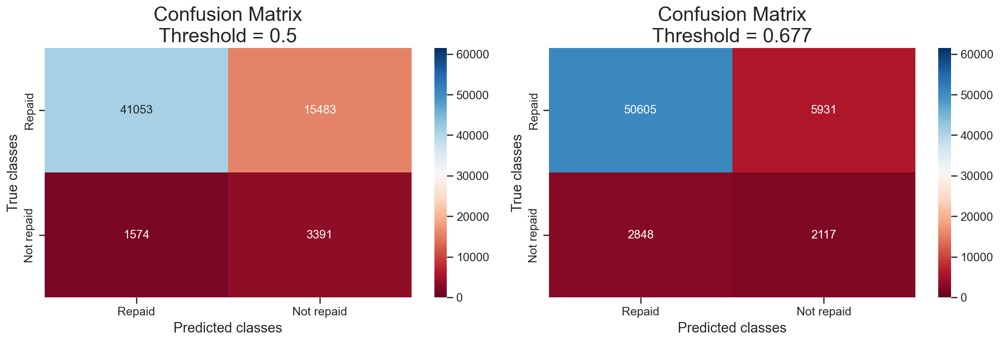

In [282]:
# Determine the confusion matrix
plt.figure(figsize=(5, 5))
plt.gcf().subplots_adjust(left=0.3,
                          bottom=0.3,
                          right=3,
                          top=1,
                          wspace=0.1,
                          hspace=10)

ax = plt.subplot(121)
ax = sns.heatmap(confusion_matrix(y_test, pred),
                 annot=True,
                 fmt='n',
                 cmap="RdBu",
                 vmin=0,
                 vmax=y_test.shape[0],
                 xticklabels=["Repaid", "Not repaid"],
                 yticklabels=["Repaid", "Not repaid"])
ax.set_ylabel('True classes', fontsize=14)
ax.set_xlabel('Predicted classes', fontsize=14)
plt.title("Confusion Matrix""\n""Threshold = 0.5", fontsize=20)

ax1 = plt.subplot(122)
ax1 = sns.heatmap(confusion_matrix(y_test, pred_threshold),
                  annot=True,
                  fmt='n',
                  cmap="RdBu",
                  vmin=0,
                  vmax=y_test.shape[0],
                  xticklabels=["Repaid", "Not repaid"],
                  yticklabels=["Repaid", "Not repaid"])
ax1.set_ylabel('True classes', fontsize=14)
ax1.set_xlabel('Predicted classes', fontsize=14)
plt.title("Confusion Matrix""\n""Threshold = 0.677", fontsize=20)

Using a threshold of 0.677 instead of 0.5 improve the accuracy of the model but increase the number of false positive. For our project, I prefer to refuse more credit but that those granted have more chance of being repaid. Therefore I will keep the decision threshold at 0.5.

**ROC curve**

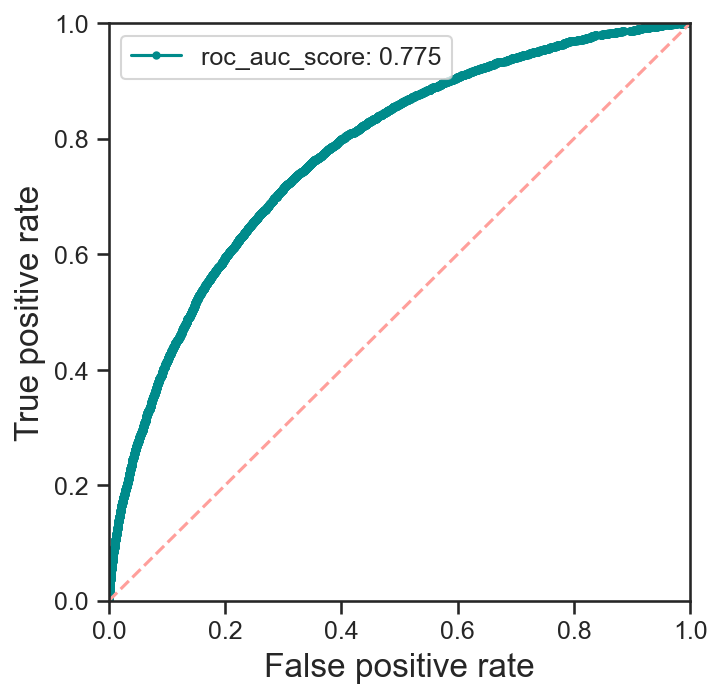

roc_auc_score: 0.775


In [283]:
def plot_roc_curve(X_test, y_test, score):
    fpr, tpr, thresholds = roc_curve(y_test, score)
    fig = plt.figure(figsize=(5, 5))
    plt.plot(fpr,
             tpr,
             marker='.',
             color='darkcyan',
             label='roc_auc_score: %.3f' % roc_auc_score(y_test, score))
    plt.plot([0, 1], [0, 1], 'r--')
    plt.xlabel('False positive rate')
    plt.ylabel('True positive rate')
    plt.xlim([0, 1])
    plt.ylim([0, 1])
    plt.legend()
    plt.show()

    print('roc_auc_score: %.3f' % roc_auc_score(y_test, score))


plot_roc_curve(X_test_scaled, y_test, proba)

**Precision - recall curve**

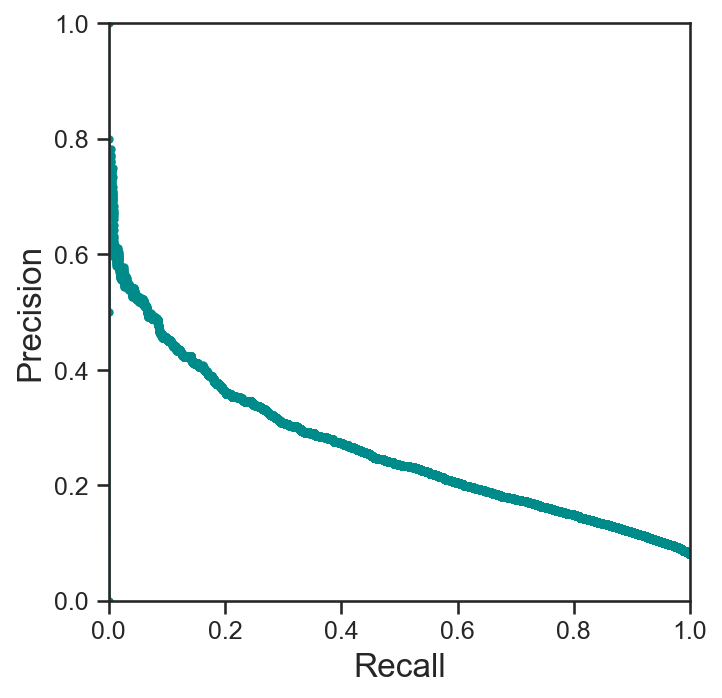

AUC PR: 0.264


In [284]:
def plot_precision_recall_curve(X_test, y_test, score):
    precision, recall, thresholds = precision_recall_curve(y_test, score)
    fig = plt.figure(figsize=(5, 5))
    plt.plot(recall, precision, marker='.', color="darkcyan")
    plt.xlabel('Recall')
    plt.ylabel('Precision')
    plt.xlim([0, 1])
    plt.ylim([0, 1])
    plt.show()

    print('AUC PR: %.3f' % auc(recall, precision))


plot_precision_recall_curve(X_test_scaled, y_test, proba)

<code style="background:lightyellow;color:black">Back to <a href="#C0">Table of contents</a></code>

# <div class="alert alert-block alert-info"><a name="C5">5. Model interpretation</a></div>

## <div class="alert alert-block alert-info"><a name="C51">5.1. Feature importance</a></div>

In [285]:
feature_importance_values = model.feature_importances_

feats = pd.DataFrame({'feature': list(X_train_scaled.columns),
                      'importance': feature_importance_values})

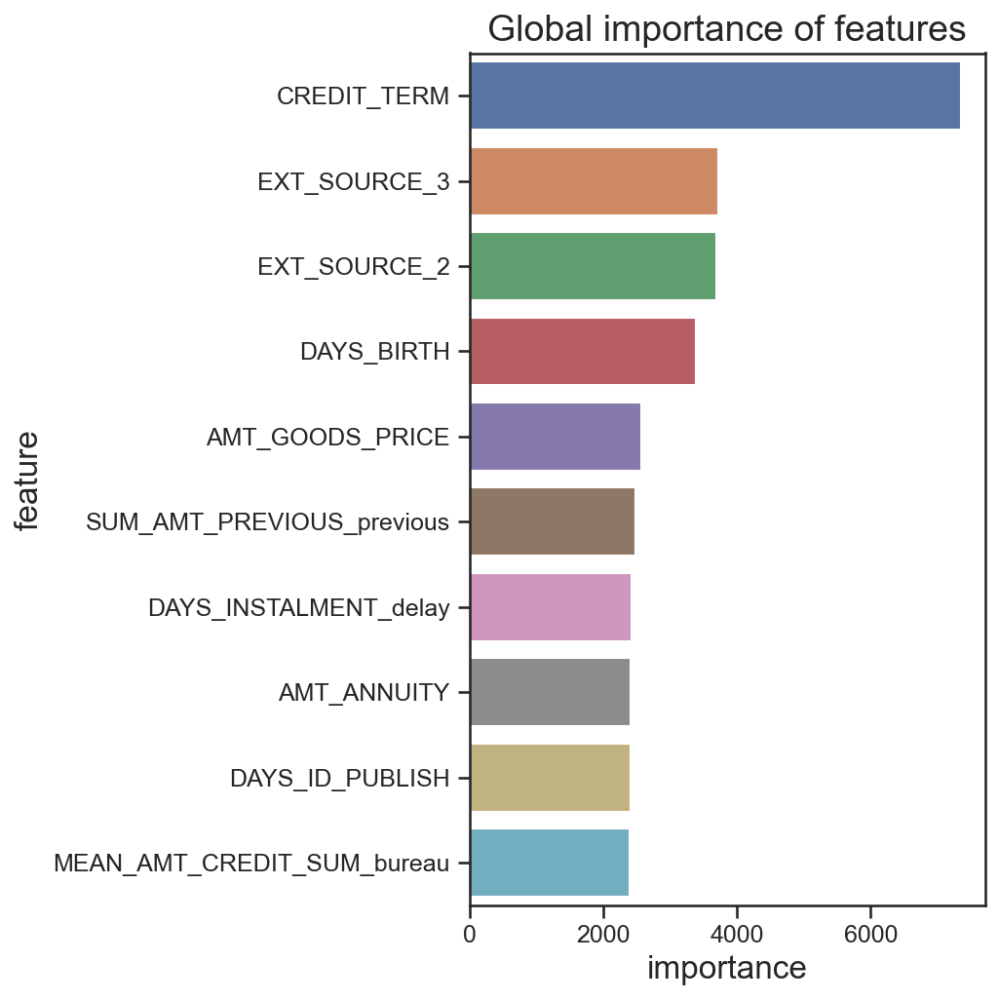

In [286]:
def display_importances(feats, nb_feats):
    cols = feats.groupby("feature").mean().sort_values(by="importance",
                                                       ascending=False)[:nb_feats].index
    best_feats = feats.loc[feats.feature.isin(cols)]
    plt.figure(figsize=(7, 7))
    sns.barplot(x="importance",
                y="feature",
                data=best_feats.sort_values(by="importance", ascending=False))
    plt.title('Global importance of features')
    plt.tight_layout()


display_importances(feats, 10)

<code style="background:lightyellow;color:black">Back to <a href="#C0">Table of contents</a></code>

## <div class="alert alert-block alert-info"><a name="C52">5.2. Permutation feature importance</a></div>

**Permutation feature importance using fbeta score**

In [287]:
my_fbeta = make_scorer(fbeta_score, beta=2)
# perform permutation importance
results = permutation_importance(model,
								 X_test_scaled,
								 y_test,
								 scoring=my_fbeta)

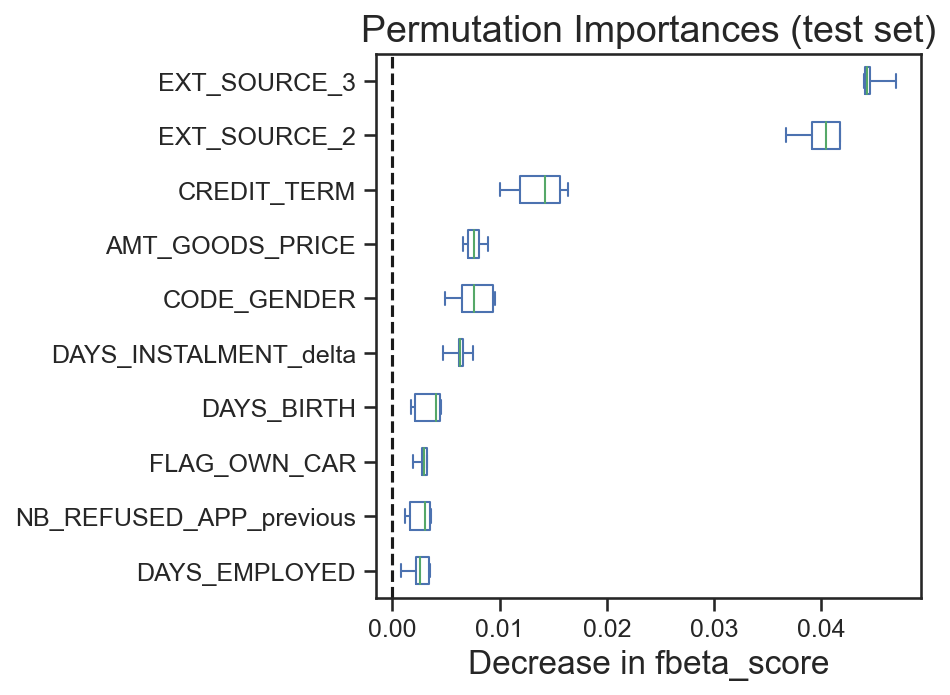

In [288]:
sorted_importances_idx = results.importances_mean.argsort()
importances = pd.DataFrame(results.importances[sorted_importances_idx].T,
                           columns=X_test_scaled.columns[sorted_importances_idx])

importances_top10 = importances.iloc[:, -10:]
ax = importances_top10.plot.box(vert=False, whis=10)
ax.set_title("Permutation Importances (test set)")
ax.axvline(x=0, color="k", linestyle="--")
ax.set_xlabel("Decrease in fbeta_score")
ax.figure.tight_layout()

In [289]:
# Save using joblib
joblib.dump(results, "results_permutation_fbeta.joblib")

['results_permutation_fbeta.joblib']

**Permutation feature importance using f1 score**

In [290]:
# perform permutation importance
results2 = permutation_importance(model,
								  X_test_scaled,
								  y_test,
								  scoring="f1")

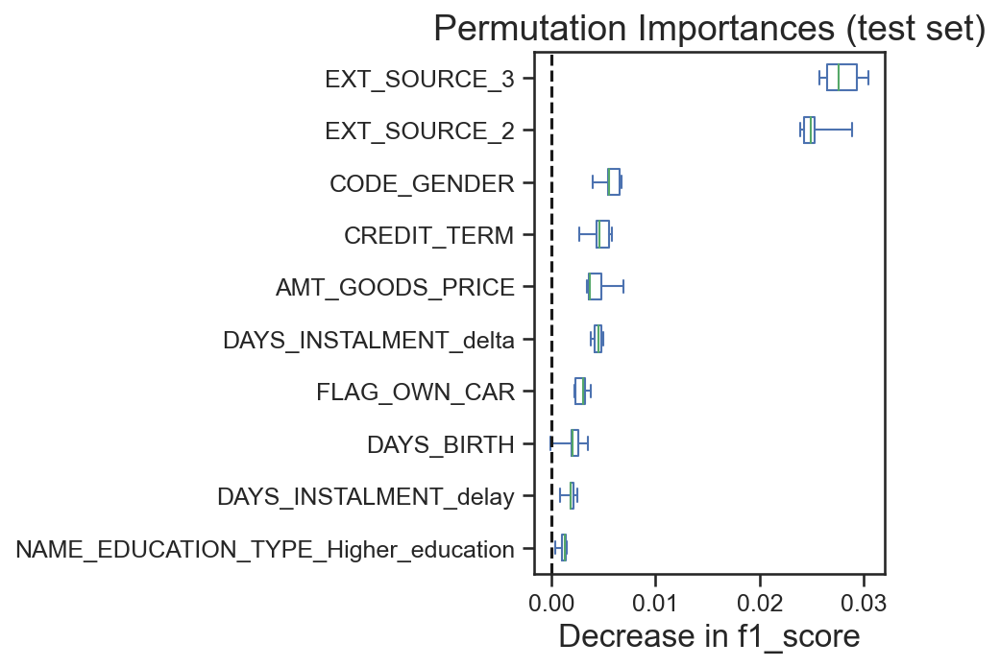

In [291]:
sorted_importances_idx = results2.importances_mean.argsort()
importances = pd.DataFrame(results2.importances[sorted_importances_idx].T,
                           columns=X_test_scaled.columns[sorted_importances_idx])

importances_top10 = importances.iloc[:, -10:]
ax = importances_top10.plot.box(vert=False, whis=10)
ax.set_title("Permutation Importances (test set)")
ax.axvline(x=0, color="k", linestyle="--")
ax.set_xlabel("Decrease in f1_score")
ax.figure.tight_layout()

In [292]:
# Save using joblib
joblib.dump(results2, "results_permutation_f1.joblib")

['results_permutation_f1.joblib']

<code style="background:lightyellow;color:black">Back to <a href="#C0">Table of contents</a></code>

## <div class="alert alert-block alert-info"><a name="C53">5.3. LIME</a></div>

**Preparation**

I will get data index for an example of data with target = 1 and an example of data with target = 0.

In [293]:
idx = random.randint(1, len(X_test))
y_test.iloc[idx]

0.0

In [294]:
idx

12070

In [295]:
idx_repaid = 23929
# idx_not_repaid = 59027
idx_not_repaid = 56756

In [296]:
proba[idx_not_repaid]

0.8354437246677944

In [297]:
proba[idx_repaid]

0.3165910403964577

In [298]:
cat_feat_ix = [i for i, c in enumerate(X_train_cat.columns)]

**Lime**

In [299]:
# Create LIME explainer object
lime_explainer = LimeTabularExplainer(X_train_scaled.to_numpy(),
                                      mode="classification",
                                      class_names=list(y_train.unique()),
                                      feature_names=list(X_train_scaled.columns),
                                      categorical_features=cat_feat_ix)
lime_explainer

In [300]:
X_test.iloc[idx_not_repaid]

NAME_CONTRACT_TYPE    0.000000
CODE_GENDER           1.000000
FLAG_OWN_CAR          1.000000
FLAG_OWN_REALTY       1.000000
NAME_FAMILY_STATUS    1.000000
                        ...   
FLAG_DOCUMENT_17     -0.015488
FLAG_DOCUMENT_18     -0.090740
FLAG_DOCUMENT_19     -0.024783
FLAG_DOCUMENT_20     -0.022637
FLAG_DOCUMENT_21     -0.018917
Name: 187610, Length: 130, dtype: float64

Prediction :  [1.]
Actual :      1.0


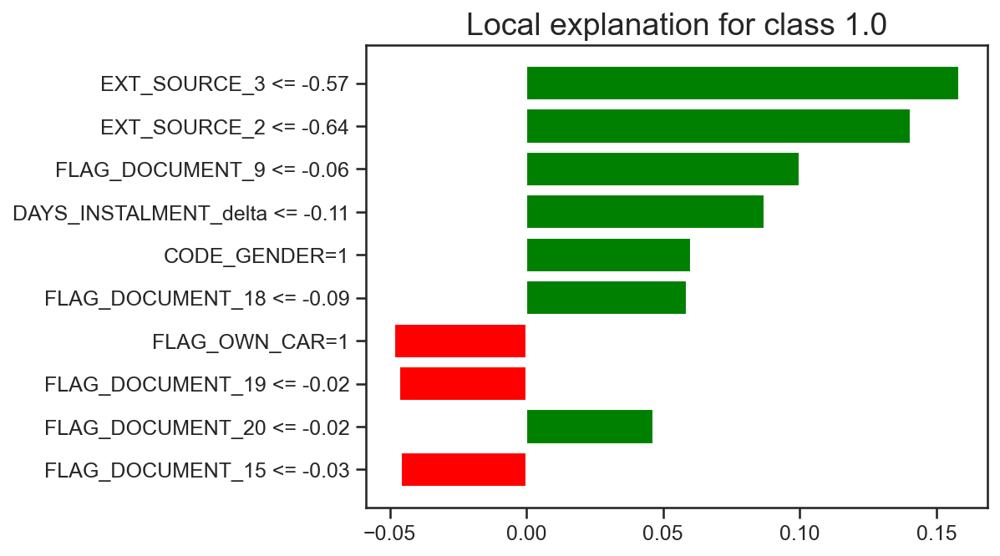

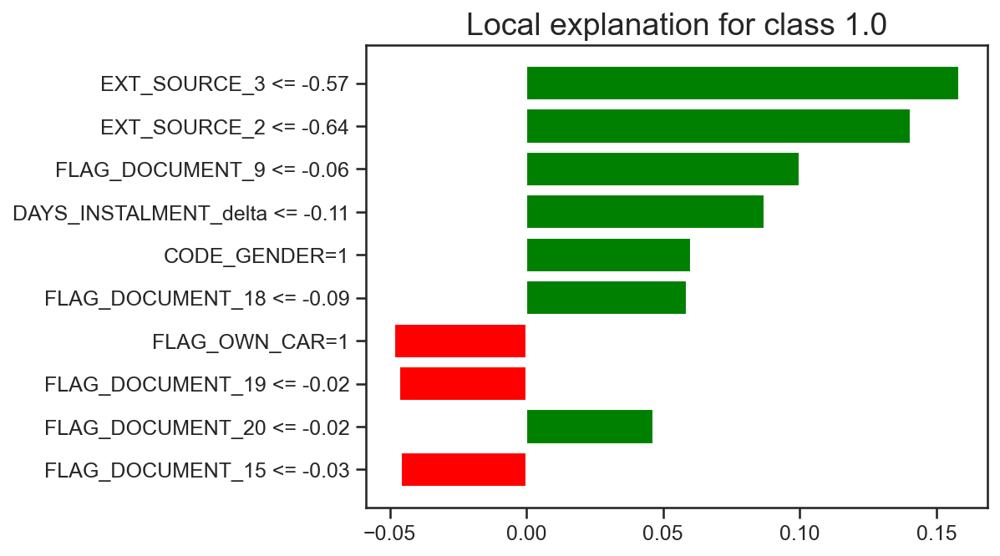

In [301]:
# Example for not repaid

print("Prediction : ", model.predict(X_test.iloc[idx_not_repaid].to_numpy().reshape(1, -1)))
print("Actual :     ", y_test.iloc[idx_not_repaid])

lime_explanation = lime_explainer.explain_instance(X_test.iloc[idx_not_repaid],
                                                   model.predict_proba,
                                                   num_features=10)

lime_explanation.show_in_notebook()
lime_explanation.as_pyplot_figure()

Prediction :  [0.]
Actual :      0.0


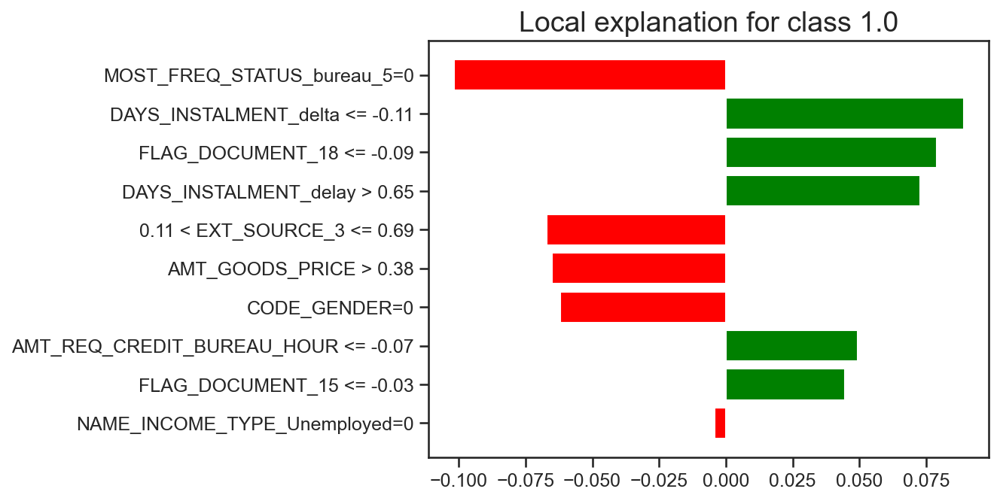

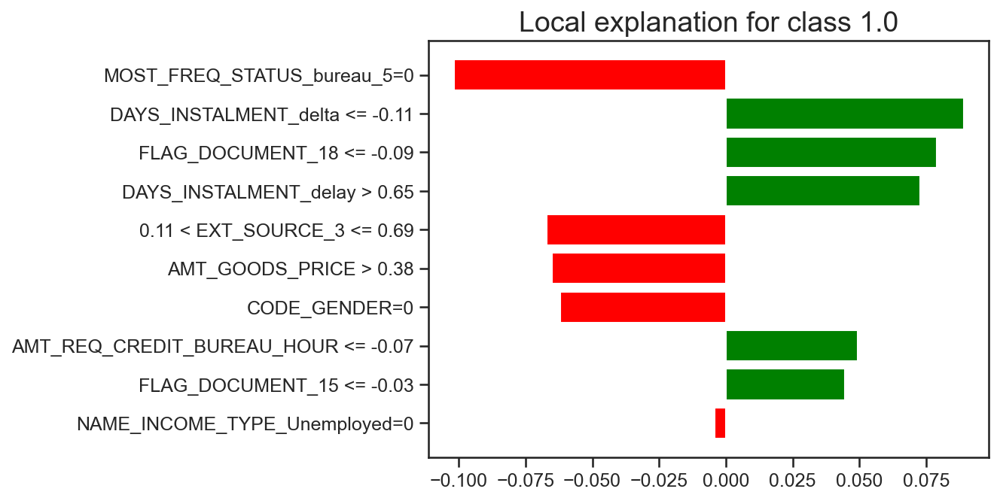

In [302]:
# Example for repaid

print("Prediction : ", model.predict(X_test.iloc[idx_repaid].to_numpy().reshape(1, -1)))
print("Actual :     ", y_test.iloc[idx_repaid])

lime_explanation = lime_explainer.explain_instance(X_test.iloc[idx_repaid],
                                                   model.predict_proba,
                                                   num_features=10)

lime_explanation.show_in_notebook()
lime_explanation.as_pyplot_figure()

<code style="background:lightyellow;color:black">Back to <a href="#C0">Table of contents</a></code>

## <div class="alert alert-block alert-info"><a name="C55">5.4. Shap</a></div>

In [303]:
shap.initjs()

In [304]:
shap_explainer = shap.TreeExplainer(model)
shap_values_train = shap_explainer.shap_values(X_train_scaled)
shap_values_test = shap_explainer.shap_values(X_test_scaled)

LightGBM binary classifier with TreeExplainer shap values output has changed to a list of ndarray


In [305]:
# Save using joblib
joblib.dump(shap_values_train, "shap_values_train.joblib")
joblib.dump(shap_values_test, "shap_values_test.joblib")
joblib.dump(shap_explainer, "shap_explainer.joblib")

['shap_explainer.joblib']

In [306]:
print("Shape of X_test_raw", X_test_scaled.shape)
print(f"Type of shap_values, {type(shap_values_test)}.",
      f"Length of the list: {len(shap_values_test)}")
print("Shape of shap_values:", np.array(shap_values_test).shape)

Shape of X_test_raw (61501, 130)
Type of shap_values, <class 'list'>. Length of the list: 2
Shape of shap_values: (2, 61501, 130)


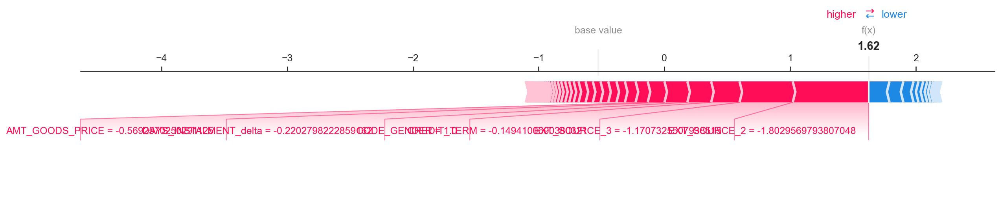

In [307]:
def plot_shap_explanation(raw_index):
    i = raw_index
    shap.force_plot(matplotlib=True,
                    base_value=shap_explainer.expected_value[1],
                    shap_values=shap_values_test[1][i],
                    features=X_test_scaled.iloc[i],
                    feature_names=X_test_scaled.columns)


plot_shap_explanation(idx_not_repaid)

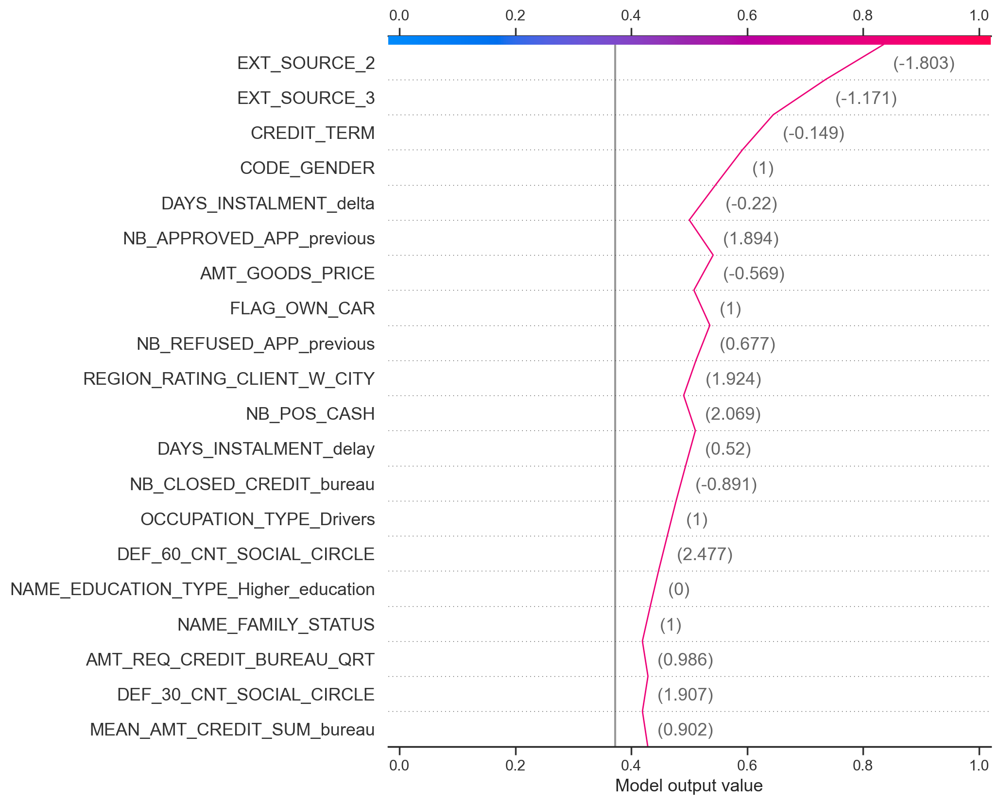

In [308]:
fig = plt.subplots(figsize=(6, 6), dpi=200)
ax_2 = shap.decision_plot(shap_explainer.expected_value[1],
                          shap_values_test[1][idx_not_repaid],
                          X_test_scaled.iloc[[idx_not_repaid]],
                          link="logit")

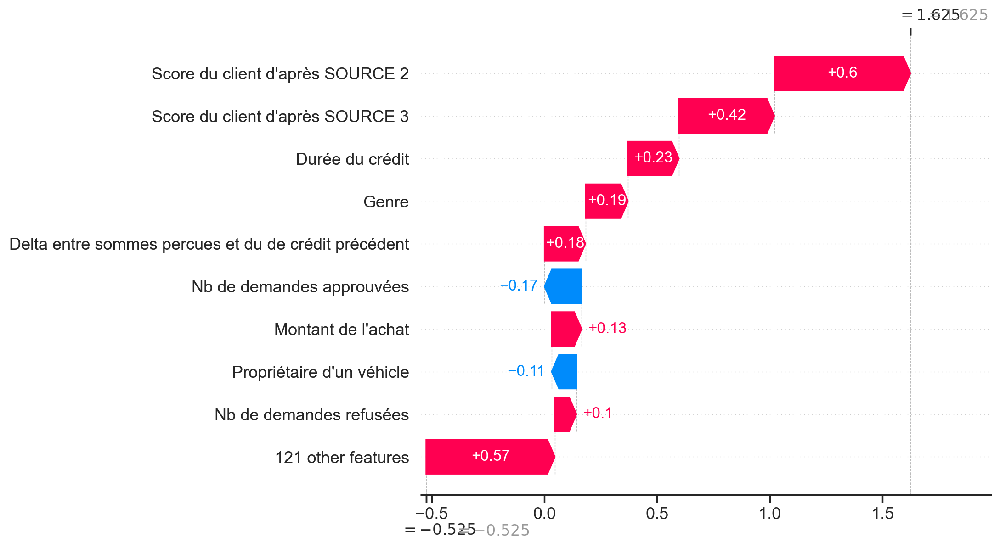

In [320]:
fig = plt.subplots(figsize=(6, 6), dpi=200)
ax_3 = shap.plots._waterfall.waterfall_legacy(shap_explainer.expected_value[1],
                                              shap_values_test[1][idx_not_repaid],
                                              feature_names=X_train_scaled.columns,
                                              max_display=10)

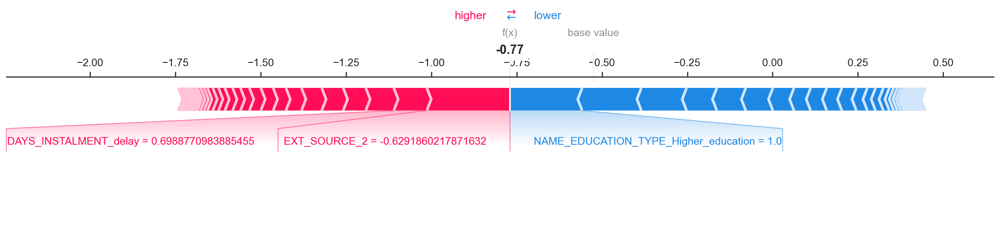

In [309]:
plot_shap_explanation(idx_repaid)

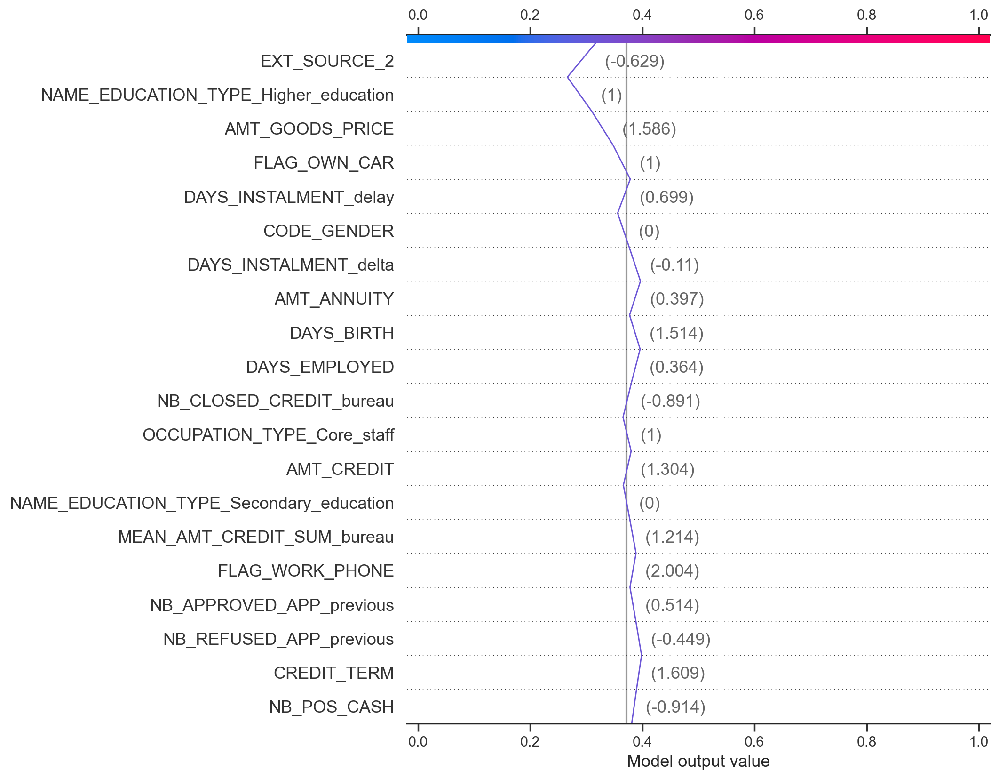

In [310]:
fig = plt.subplots(figsize=(6, 6), dpi=200)
ax_2 = shap.decision_plot(shap_explainer.expected_value[1],
                          shap_values_test[1][idx_repaid],
                          X_test_scaled.iloc[[idx_repaid]],
                          link="logit")

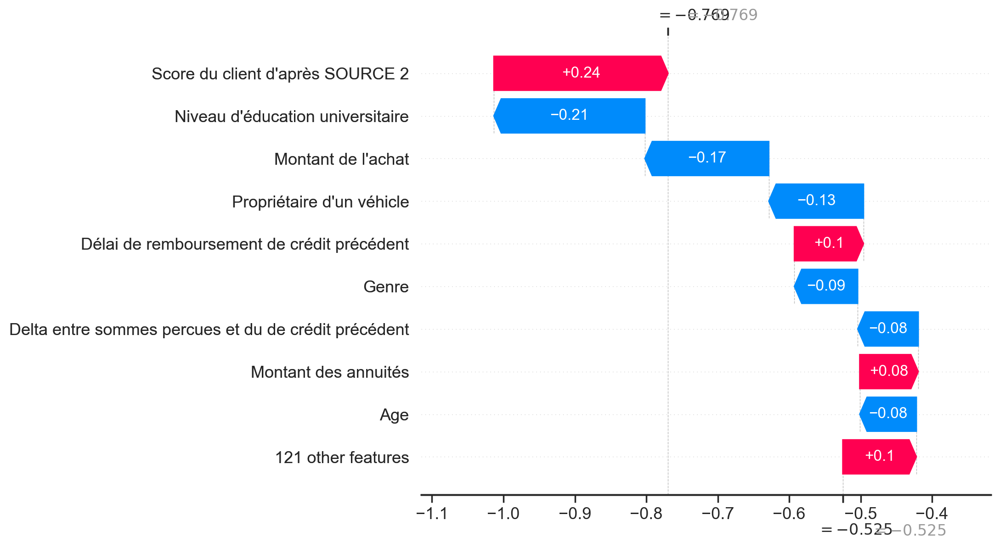

In [319]:
fig = plt.subplots(figsize=(6, 6), dpi=200)
ax_3 = shap.plots._waterfall.waterfall_legacy(shap_explainer.expected_value[1],
                                              shap_values_test[1][idx_repaid],
                                              feature_names=X_train_scaled.columns,
                                              max_display=10)

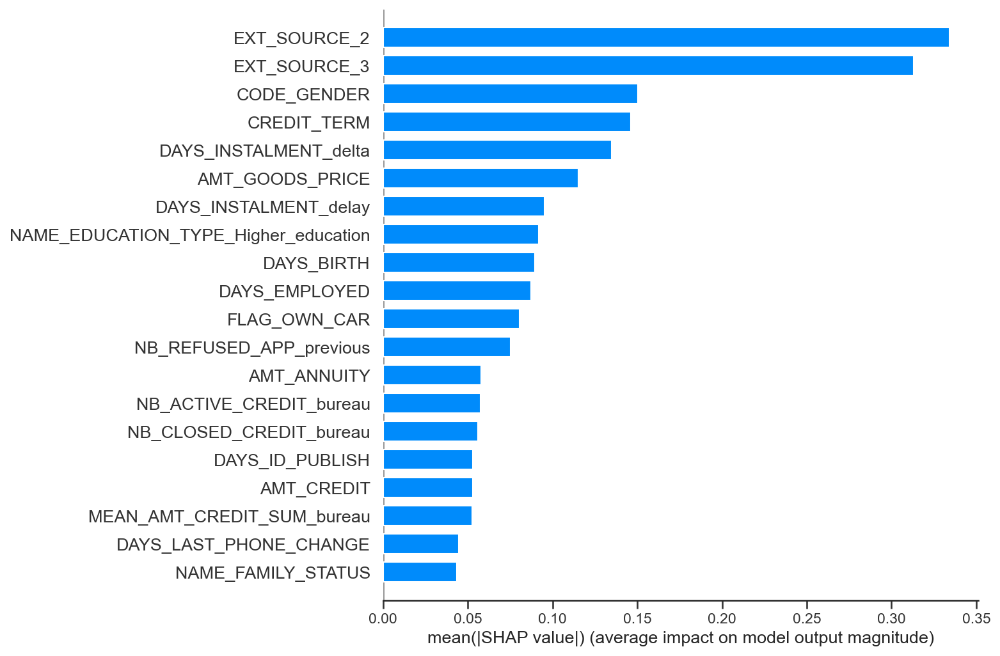

In [311]:
shap.summary_plot(shap_values_train[1],
                  X_train_scaled,
                  plot_type="bar",
                  plot_size=(8, 8))

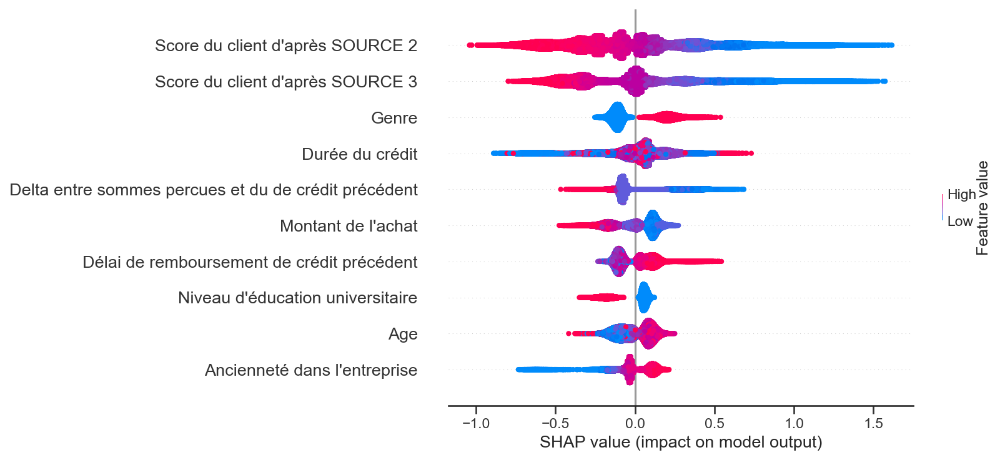

In [317]:
shap.summary_plot(shap_values_train[1], X_train_scaled, max_display=10)

In [313]:
X_train_rename = rename_columns(X_train_scaled)

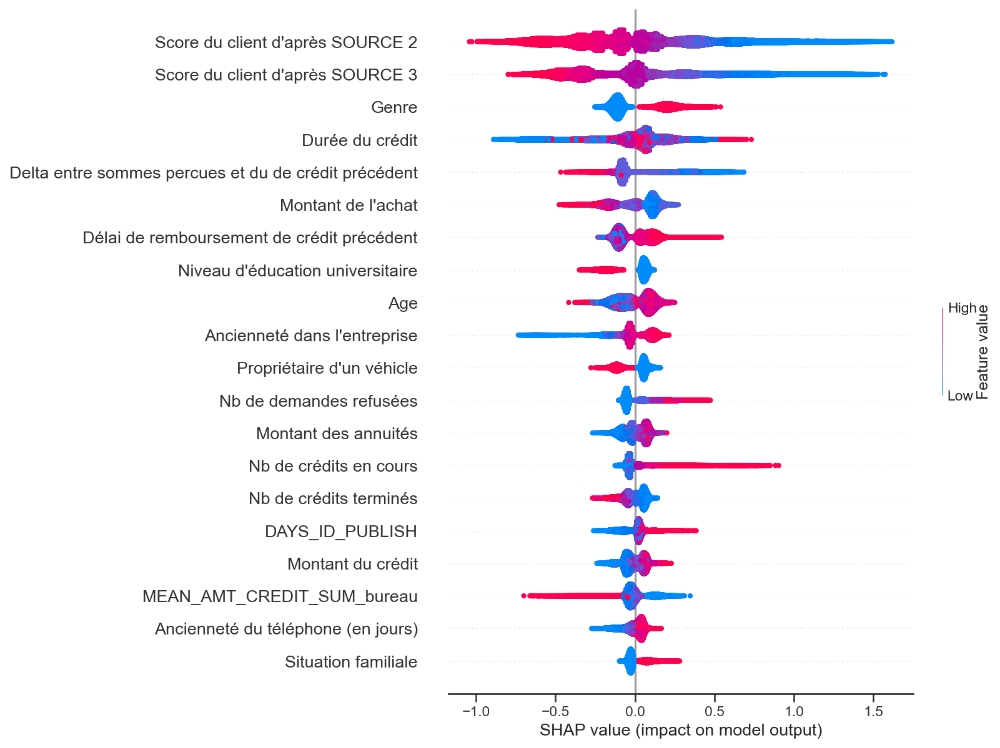

In [314]:
shap.summary_plot(shap_values_train[1], X_train_scaled)